In [ ]:
import os
os.environ['KAGGLE_CONFIG_DIR'] = "/content/kaggle"
# /content/gdrive/My Drive/Kaggle is the path where kaggle.json is present in the Google Drive

In [ ]:
#changing the working directory
%cd /content/kaggle
#Check the present working directory using pwd command

/content/kaggle


In [ ]:
!kaggle datasets download -d splcher/animefacedataset

 98% 385M/395M [00:13<00:00, 36.8MB/s]
100% 395M/395M [00:13<00:00, 30.7MB/s]


In [ ]:
!ls

animefacedataset.zip  kaggle.json


In [ ]:
#unzipping the zip files and deleting the zip files
!unzip \*.zip  && rm *.zip

Streaming output truncated to the last 5000 lines.
  inflating: images/62764_2019.jpg   
  inflating: images/62765_2019.jpg   
  inflating: images/62766_2019.jpg   
  inflating: images/62767_2019.jpg   
  inflating: images/62768_2019.jpg   
  inflating: images/62769_2019.jpg   
  inflating: images/6276_2003.jpg    
  inflating: images/62770_2019.jpg   
  inflating: images/62771_2019.jpg   
  inflating: images/62772_2019.jpg   
  inflating: images/62773_2019.jpg   
  inflating: images/62774_2019.jpg   
  inflating: images/62775_2019.jpg   
  inflating: images/62776_2019.jpg   
  inflating: images/62777_2019.jpg   
  inflating: images/62778_2019.jpg   
  inflating: images/62779_2019.jpg   
  inflating: images/6277_2003.jpg    
  inflating: images/62780_2019.jpg   
  inflating: images/62781_2019.jpg   
  inflating: images/62782_2019.jpg   
  inflating: images/62783_2019.jpg   
  inflating: images/62784_2019.jpg   
  inflating: images/62785_2019.jpg   
  inflating: images/62786_2019.jpg   

In [ ]:
import glob
import tensorflow as tf
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import time
import cv2
import scipy
from PIL import Image
import matplotlib.gridspec as gridspec

## Display some images

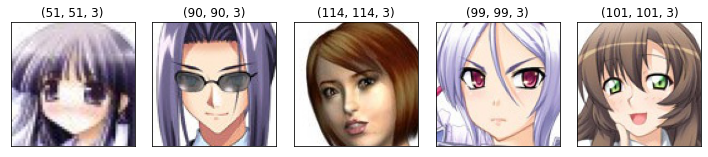

In [ ]:
filenames =  glob.glob('/content/kaggle/images/*')
#print(filenames)
plt.figure(figsize=(10, 8))
for i in range(5):
    img = plt.imread(filenames[i], 0)
    plt.subplot(4, 5, i+1)
    plt.imshow(img)
    plt.title(img.shape)
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show()

## Now as all images are of different size, lets covert them into size (64, 64, 3) and also normalize pixels values to [-1 1] 

In [ ]:
data_dir = '/content/kaggle/images/*'

In [ ]:
# HELPER FUNCTIONS
def norm_img(img):
  img = (img/127.5) - 1 # lies between [-1 1]
  return img

def denorm_img(img):
  img = 127.5*(img + 1) # returns the real pixels unnormalized
  img = img.numpy().astype('uint8')
  return img
  

def sample_from_dataset(batch_size, image_shape, data_dir = None):
  '''Create a batch of image samples by sampling random images from a data directory.
    Resizes the image using image_shape and normalize the images.
    Input:
        batch_size : Sample size required
        image_size : Size that Image should be resized to
        data_dir : Path of directory where training images are placed.
    Output:
        sample : batch of processed images 
    '''

  sample_dim = (batch_size, ) + image_shape
  sample = np.empty(sample_dim, dtype=np.float32)
  all_data_dirlist = list(glob.glob(data_dir))
  sample_imgs_paths = np.random.choice(all_data_dirlist,batch_size)

  for index,img_filename in enumerate(sample_imgs_paths):
        image = Image.open(img_filename)
        image = image.resize(image_shape[:-1])
        image = image.convert('RGB') 
        image = np.asarray(image)
        image = norm_img(image)
        sample[index,...] = image
  return sample

In [ ]:
sample_from_dataset(batch_size=32, image_shape=(64, 64, 3), data_dir = data_dir)

###The following code block is a helper function to create a noise vector of predefined length for a Generator. It will generate the noise which we want to convert to an image using our generator architecture.

In [ ]:
def gen_noise(batch_size, noise_shape):
  ''' Generates a numpy vector sampled from normal distribution of shape     (batch_size,noise_shape)
    Input:
        batch_size : size of batch
        noise_shape: shape of noise vector, normally kept as 100 
    Output:a numpy vector sampled from normal distribution of shape          (batch_size,noise_shape)     
    '''

  return np.random.normal(0, 1, size = (batch_size,) + noise_shape) # mu = 0, sigma = 1

In [ ]:
gen_noise(4, (50,)).shape # 4 normallyy distributed noise vectors

(4, 50)

In [ ]:
from tensorflow.keras.layers import Conv2DTranspose, Dense, BatchNormalization, LeakyReLU, Input, Conv2D, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

def get_gen_normal(noise_shape):
    ''' This function takes as input shape of the noise vector and creates the Keras generator    architecture.
    '''
    kernel_init = 'glorot_uniform'    
    gen_input = Input(shape = noise_shape) 
    
    # Transpose 2D conv layer 1. 
    generator = Conv2DTranspose(filters = 512, kernel_size = (4,4), strides = (1,1), padding = "valid", data_format = "channels_last", kernel_initializer = kernel_init)(gen_input)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 2.
    generator = Conv2DTranspose(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 3.
    generator = Conv2DTranspose(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Transpose 2D conv layer 4.
    generator = Conv2DTranspose(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # conv 2D layer 1.
    generator = Conv2D(filters = 64,  kernel_size = (3,3), strides = (1,1), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(generator)
    generator = BatchNormalization(momentum = 0.5)(generator)
    generator = LeakyReLU(0.2)(generator)
    
    # Final Transpose 2D conv layer 5 to generate final image. Filter size 3 for 3 image channel
    generator = Conv2DTranspose(filters = 3, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", 
                                kernel_initializer = kernel_init, activation = 'tanh')(generator)
    
    # defining the optimizer and compiling the generator model.
    gen_opt = Adam(lr=0.00015, beta_1=0.5)
    generator_model = Model(inputs = gen_input, outputs = generator)
    generator_model.compile(loss='binary_crossentropy', optimizer=gen_opt, metrics=['accuracy'])
    generator_model.summary()
    return generator_model



In [ ]:
generator = get_gen_normal(noise_shape=(1, 1, 100))

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 1, 1, 100)]       0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 4, 4, 512)         819712    
_________________________________________________________________
batch_normalization (BatchNo (None, 4, 4, 512)         2048      
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 4, 4, 512)         0         
_________________________________________________________________
conv2d_transpose_1 (Conv2DTr (None, 8, 8, 256)         2097408   
_________________________________________________________________
batch_normalization_1 (Batch (None, 8, 8, 256)         1024      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 8, 8, 256)         0     

In [ ]:
generator = tf.keras.models.load_model('/content/drive/MyDrive/anime gan gen7499_GENERATOR_weights_and_arch.hdf5')

In [ ]:
discriminator = tf.keras.models.load_model('/content/drive/MyDrive/anime gan gen7499_DISCRIMINATOR_weights_and_arch.hdf5')

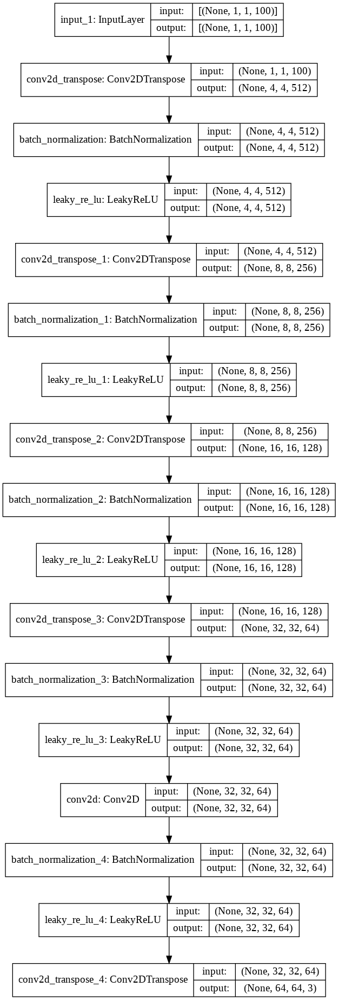

In [ ]:
tf.keras.utils.plot_model(generator, 'generator.png', show_shapes=True)

### Create Discriminator model

In [ ]:
def get_disc_normal(image_shape=(64,64,3)):
    dropout_prob = 0.4
    kernel_init = 'glorot_uniform'
    dis_input = Input(shape = image_shape)
    
    # Conv layer 1:
    discriminator = Conv2D(filters = 64, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(dis_input)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 2:
    discriminator = Conv2D(filters = 128, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 3:   
    discriminator = Conv2D(filters = 256, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)
    # Conv layer 4:
    discriminator = Conv2D(filters = 512, kernel_size = (4,4), strides = (2,2), padding = "same", data_format = "channels_last", kernel_initializer = kernel_init)(discriminator)
    discriminator = BatchNormalization(momentum = 0.5)(discriminator)
    discriminator = LeakyReLU(0.2)(discriminator)#discriminator = MaxPooling2D(pool_size=(2, 2))(discriminator)
    # Flatten
    discriminator = Flatten()(discriminator)
    # Dense Layer
    discriminator = Dense(1, activation='sigmoid')(discriminator)
   
    # Optimizer and Compiling model
    dis_opt = Adam(lr=0.0002, beta_1=0.5)
    discriminator_model = Model(inputs = dis_input, outputs = discriminator)
    discriminator_model.compile(loss='binary_crossentropy', optimizer=dis_opt, metrics=['accuracy'])
    discriminator_model.summary()
    return discriminator_model

In [ ]:
discriminator = get_disc_normal()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 64, 64, 3)]       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 32, 32, 64)        3136      
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 32, 32, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 16, 128)       131200    
_________________________________________________________________
batch_normalization_5 (Batch (None, 16, 16, 128)       512       
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 16, 16, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 8, 8, 256)         5245

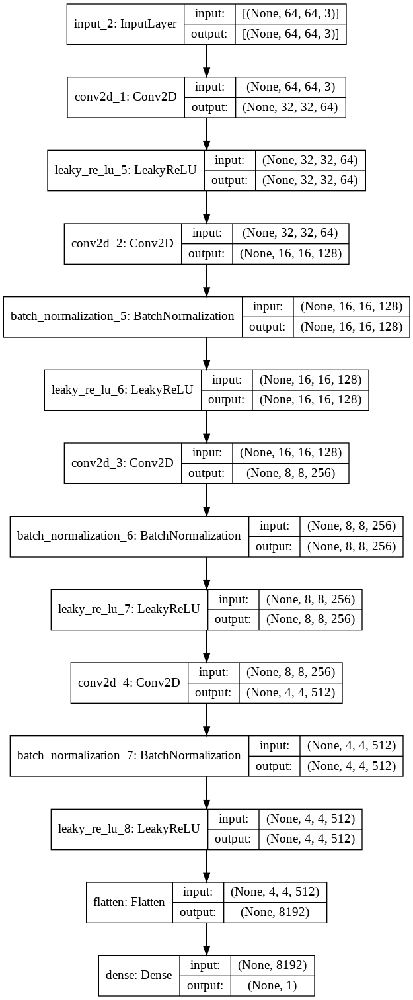

In [ ]:
tf.keras.utils.plot_model(discriminator, 'discriminator.png', show_shapes=True)

### Now we need to chain generator and discriminator together and train them sequentially so as discriminator propagates error between real and fake images so generator is pushed to do better and produce more real output and vice versa 

In [ ]:
def get_GAN_model():
  discriminator.trainable = False
  # Optimizer for the GAN
  opt = Adam(lr=0.00015, beta_1=0.5) #same as generator

  gan = tf.keras.models.Sequential([generator,
                              discriminator])
  
  gan.compile(optimizer = opt, loss = 'binary_crossentropy', metrics = ['accuracy'])

  
  return gan

In [ ]:
gan = get_GAN_model()

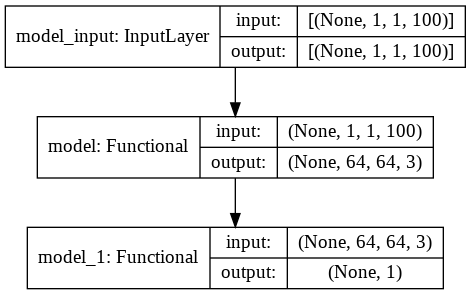

In [ ]:
tf.keras.utils.plot_model(gan, 'GAN.png', show_shapes=True)

### Now we need to create training loop

In [ ]:
import time

## Helper function to save image

In [ ]:
def save_img_batch(img_batch,img_save_dir):
    '''Takes as input a image batch and a img_save_dir and saves 16 images from the batch in a 4x4 grid in the img_save_dir
    '''
    plt.figure(figsize=(16,16))
    gs1 = gridspec.GridSpec(4, 4)
    gs1.update(wspace=0, hspace=0)
    rand_indices = np.random.choice(img_batch.shape[0],16,replace=False)
    for i in range(16):
        ax1 = plt.subplot(gs1[i])
        ax1.set_aspect('equal')
        rand_index = rand_indices[i]
        image = img_batch[rand_index, :,:,:]
        fig = plt.imshow(denorm_img(image))
        plt.axis('off')
        fig.axes.get_xaxis().set_visible(False)
        fig.axes.get_yaxis().set_visible(False)
    plt.tight_layout()
    plt.savefig(img_save_dir,bbox_inches='tight',pad_inches=0)
    plt.show() 

Begin step:  0


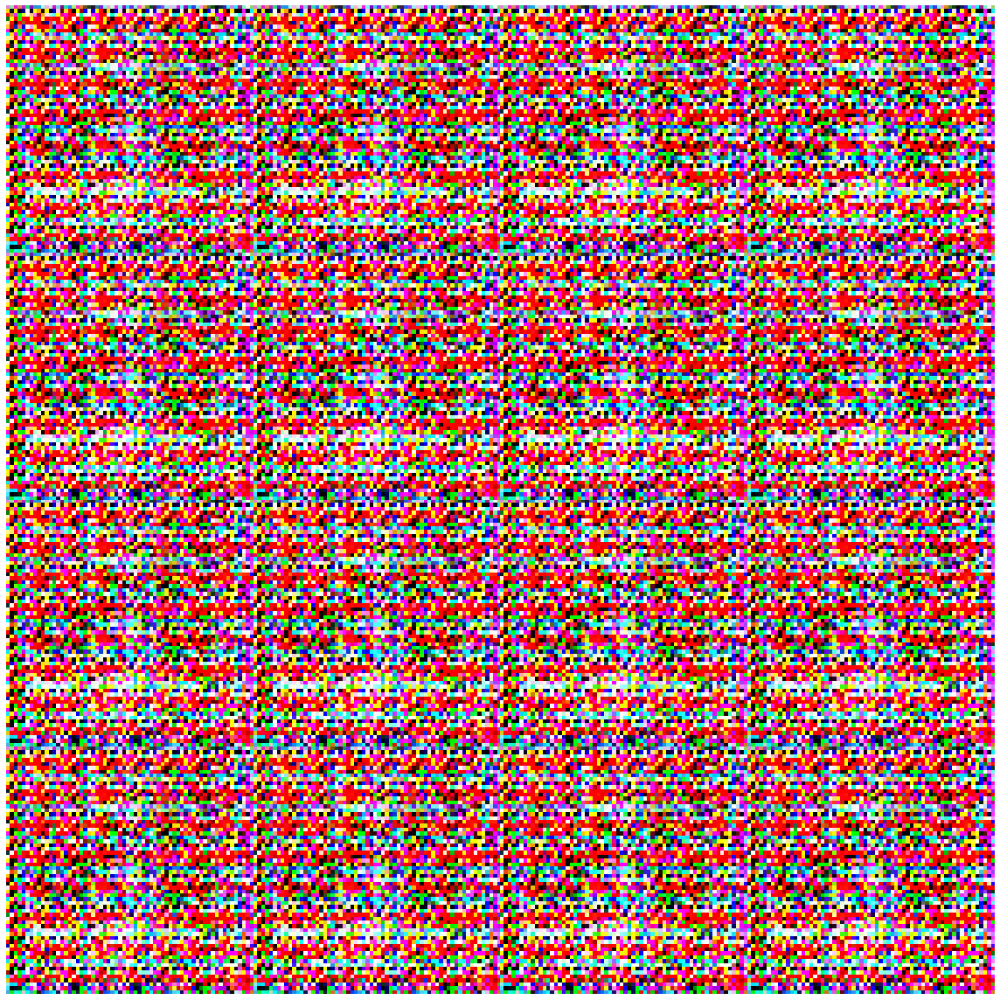

Disc: real loss: 1.288424 fake loss: 1.101383
GAN loss: 0.452707
Step 0 completed. Time took: 1 secs.
Begin step:  1
Disc: real loss: 1.286659 fake loss: 1.096834
GAN loss: 0.450942
Step 1 completed. Time took: 0 secs.
Begin step:  2
Disc: real loss: 1.265062 fake loss: 1.096982
GAN loss: 0.452546
Step 2 completed. Time took: 0 secs.
Begin step:  3
Disc: real loss: 1.248207 fake loss: 1.100596
GAN loss: 0.453787
Step 3 completed. Time took: 0 secs.
Begin step:  4
Disc: real loss: 1.284961 fake loss: 1.107040
GAN loss: 0.444126
Step 4 completed. Time took: 0 secs.
Begin step:  5
Disc: real loss: 1.280958 fake loss: 1.103108
GAN loss: 0.443936
Step 5 completed. Time took: 0 secs.
Begin step:  6
Disc: real loss: 1.271961 fake loss: 1.104741
GAN loss: 0.448188
Step 6 completed. Time took: 0 secs.
Begin step:  7
Disc: real loss: 1.257153 fake loss: 1.099313
GAN loss: 0.456517
Step 7 completed. Time took: 0 secs.
Begin step:  8
Disc: real loss: 1.290818 fake loss: 1.100542
GAN loss: 0.459884

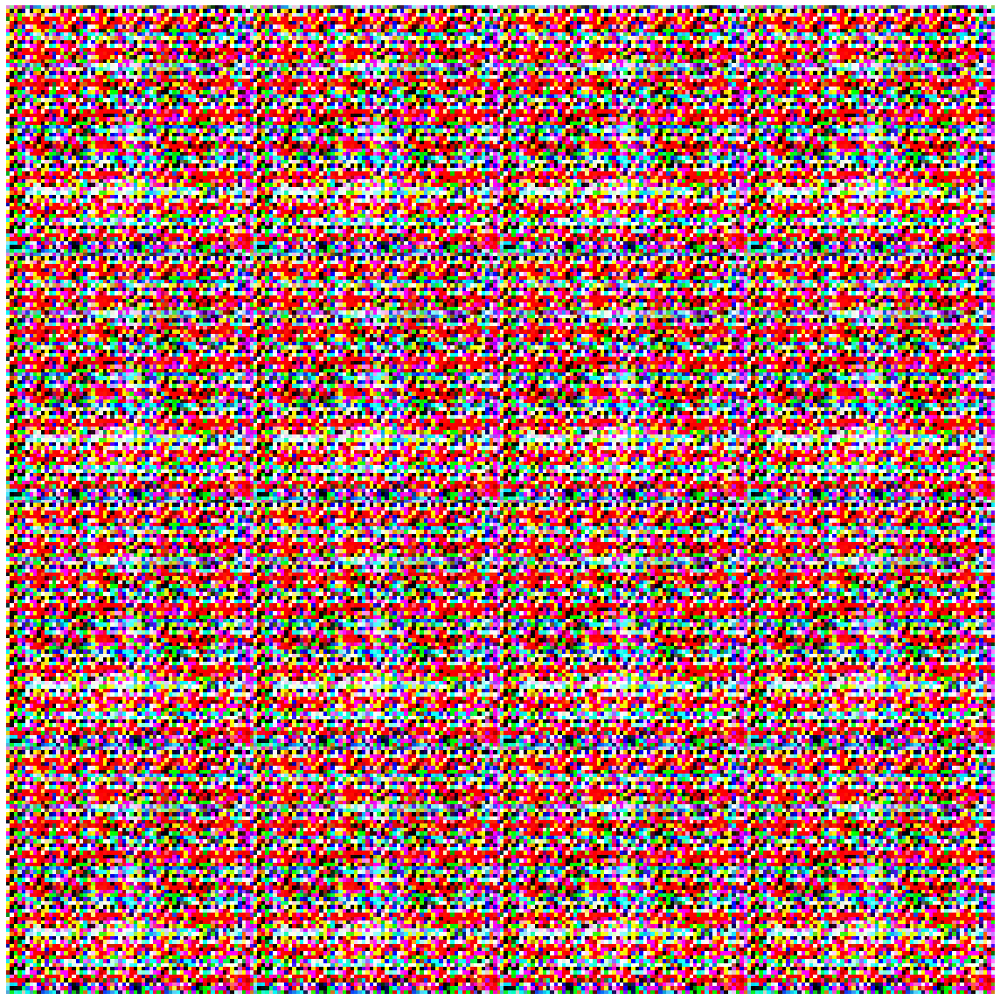

Disc: real loss: 1.274726 fake loss: 1.087385
GAN loss: 0.456802
Step 100 completed. Time took: 1 secs.
Begin step:  101
Disc: real loss: 1.271625 fake loss: 1.089031
GAN loss: 0.456829
Step 101 completed. Time took: 0 secs.
Begin step:  102
Disc: real loss: 1.289552 fake loss: 1.095527
GAN loss: 0.458147
Step 102 completed. Time took: 0 secs.
Begin step:  103
Disc: real loss: 1.256639 fake loss: 1.100559
GAN loss: 0.447504
Step 103 completed. Time took: 0 secs.
Begin step:  104
Disc: real loss: 1.278543 fake loss: 1.091022
GAN loss: 0.444021
Step 104 completed. Time took: 0 secs.
Begin step:  105
Disc: real loss: 1.294237 fake loss: 1.099044
GAN loss: 0.444854
Step 105 completed. Time took: 0 secs.
Begin step:  106
Disc: real loss: 1.259889 fake loss: 1.098162
GAN loss: 0.457431
Step 106 completed. Time took: 0 secs.
Begin step:  107
Disc: real loss: 1.286607 fake loss: 1.100065
GAN loss: 0.454975
Step 107 completed. Time took: 0 secs.
Begin step:  108
Disc: real loss: 1.286542 fake l

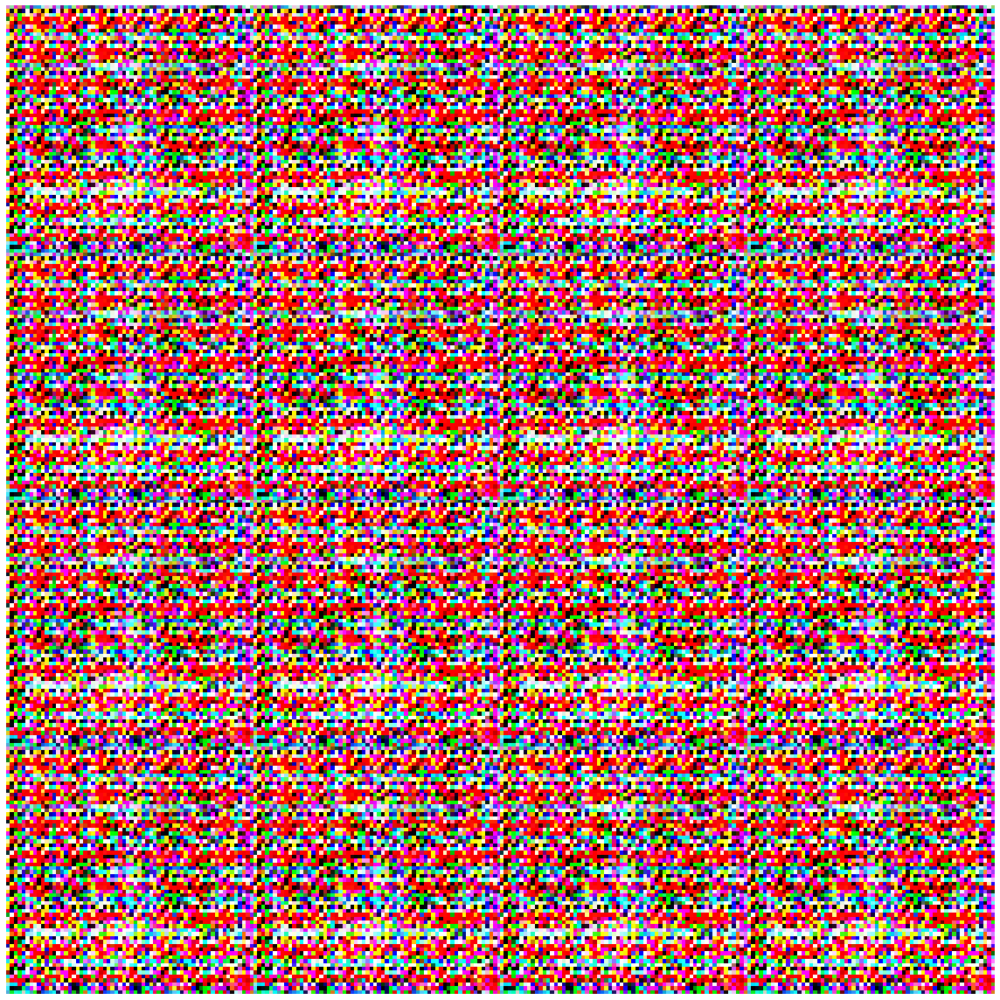

Disc: real loss: 1.284522 fake loss: 1.093256
GAN loss: 0.445831
Step 200 completed. Time took: 1 secs.
Begin step:  201
Disc: real loss: 1.288110 fake loss: 1.098502
GAN loss: 0.444704
Step 201 completed. Time took: 0 secs.
Begin step:  202
Disc: real loss: 1.255399 fake loss: 1.092735
GAN loss: 0.458652
Step 202 completed. Time took: 0 secs.
Begin step:  203
Disc: real loss: 1.256629 fake loss: 1.090257
GAN loss: 0.452607
Step 203 completed. Time took: 0 secs.
Begin step:  204
Disc: real loss: 1.285329 fake loss: 1.092863
GAN loss: 0.450772
Step 204 completed. Time took: 0 secs.
Begin step:  205
Disc: real loss: 1.284369 fake loss: 1.099226
GAN loss: 0.448866
Step 205 completed. Time took: 0 secs.
Begin step:  206
Disc: real loss: 1.287162 fake loss: 1.096233
GAN loss: 0.447897
Step 206 completed. Time took: 0 secs.
Begin step:  207
Disc: real loss: 1.284368 fake loss: 1.104493
GAN loss: 0.448357
Step 207 completed. Time took: 0 secs.
Begin step:  208
Disc: real loss: 1.274369 fake l

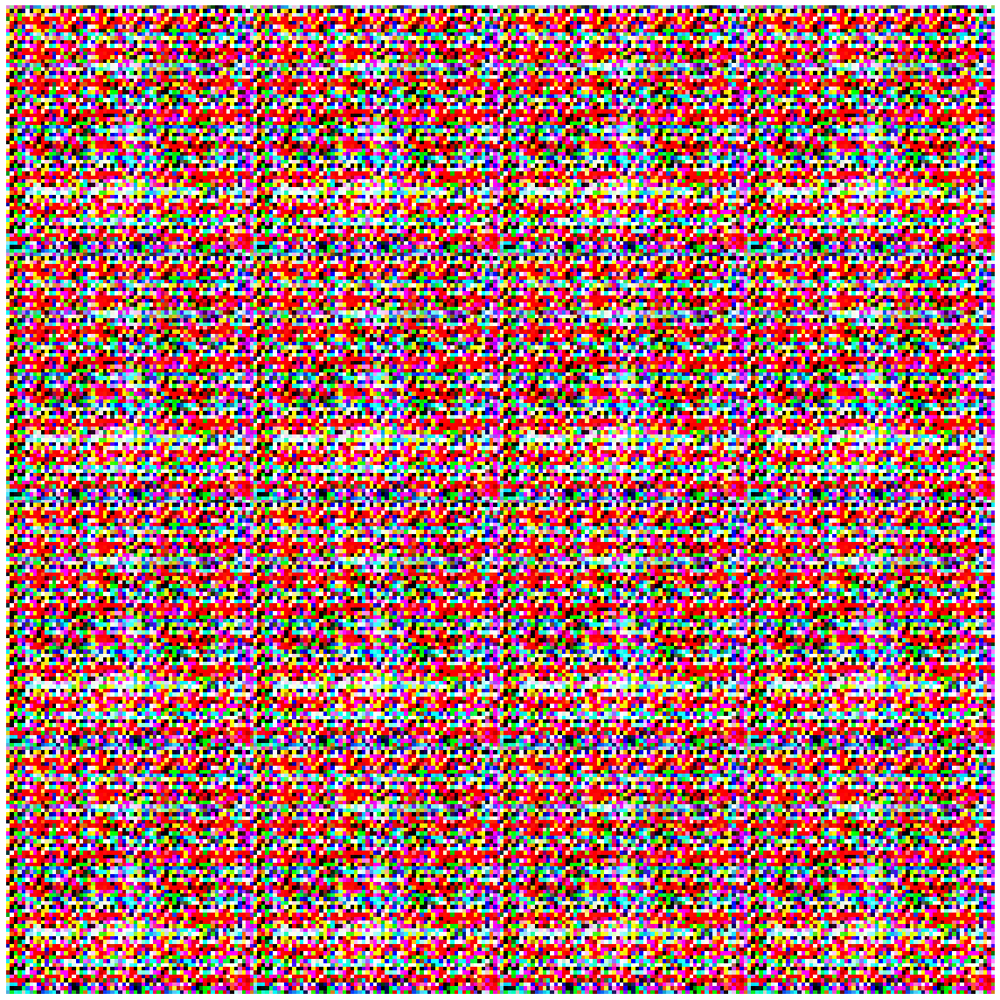

Disc: real loss: 1.267946 fake loss: 1.101646
GAN loss: 0.448163
Step 300 completed. Time took: 1 secs.
Begin step:  301
Disc: real loss: 1.271946 fake loss: 1.090829
GAN loss: 0.449348
Step 301 completed. Time took: 0 secs.
Begin step:  302
Disc: real loss: 1.275601 fake loss: 1.099231
GAN loss: 0.447079
Step 302 completed. Time took: 0 secs.
Begin step:  303
Disc: real loss: 1.288080 fake loss: 1.108310
GAN loss: 0.451052
Step 303 completed. Time took: 0 secs.
Begin step:  304
Disc: real loss: 1.283947 fake loss: 1.102503
GAN loss: 0.455800
Step 304 completed. Time took: 0 secs.
Begin step:  305
Disc: real loss: 1.283818 fake loss: 1.082752
GAN loss: 0.443995
Step 305 completed. Time took: 0 secs.
Begin step:  306
Disc: real loss: 1.302086 fake loss: 1.096618
GAN loss: 0.440833
Step 306 completed. Time took: 0 secs.
Begin step:  307
Disc: real loss: 1.293288 fake loss: 1.090890
GAN loss: 0.442703
Step 307 completed. Time took: 0 secs.
Begin step:  308
Disc: real loss: 1.275021 fake l

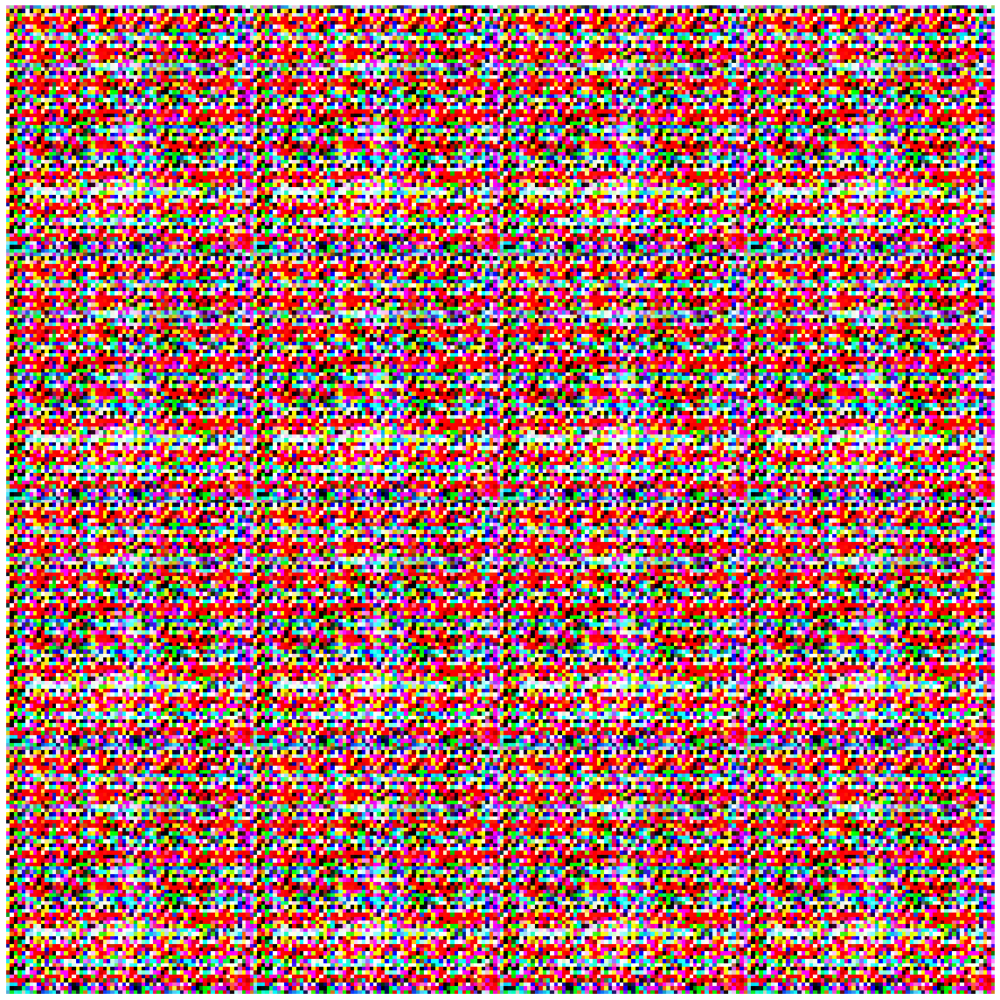

Disc: real loss: 1.277462 fake loss: 1.093632
GAN loss: 0.452156
Step 400 completed. Time took: 1 secs.
Begin step:  401
Disc: real loss: 1.274490 fake loss: 1.093198
GAN loss: 0.451645
Step 401 completed. Time took: 0 secs.
Begin step:  402
Disc: real loss: 1.292224 fake loss: 1.103672
GAN loss: 0.455836
Step 402 completed. Time took: 0 secs.
Begin step:  403
Disc: real loss: 1.267098 fake loss: 1.110562
GAN loss: 0.450587
Step 403 completed. Time took: 0 secs.
Begin step:  404
Disc: real loss: 1.279156 fake loss: 1.107626
GAN loss: 0.456848
Step 404 completed. Time took: 0 secs.
Begin step:  405
Disc: real loss: 1.257253 fake loss: 1.087716
GAN loss: 0.447793
Step 405 completed. Time took: 0 secs.
Begin step:  406
Disc: real loss: 1.253835 fake loss: 1.086801
GAN loss: 0.451195
Step 406 completed. Time took: 0 secs.
Begin step:  407
Disc: real loss: 1.252172 fake loss: 1.095716
GAN loss: 0.452575
Step 407 completed. Time took: 0 secs.
Begin step:  408
Disc: real loss: 1.253071 fake l

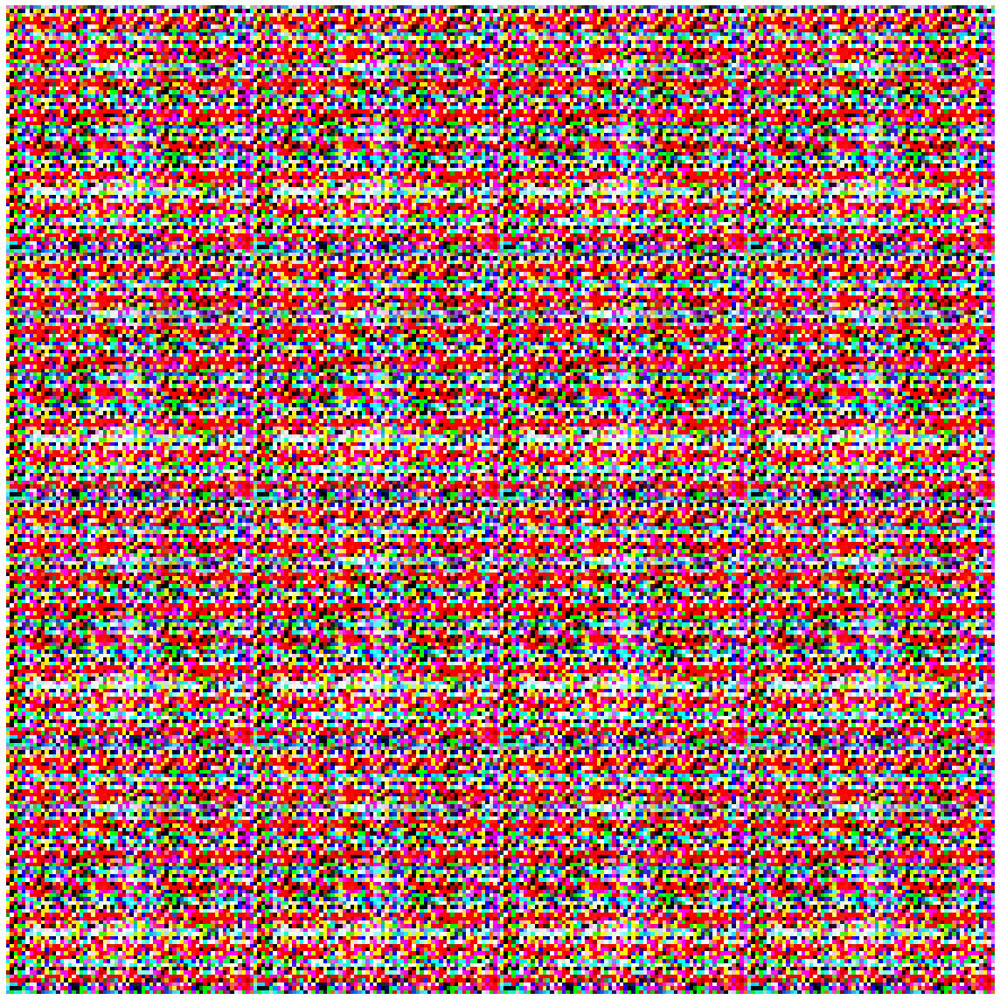

Begin step:  500


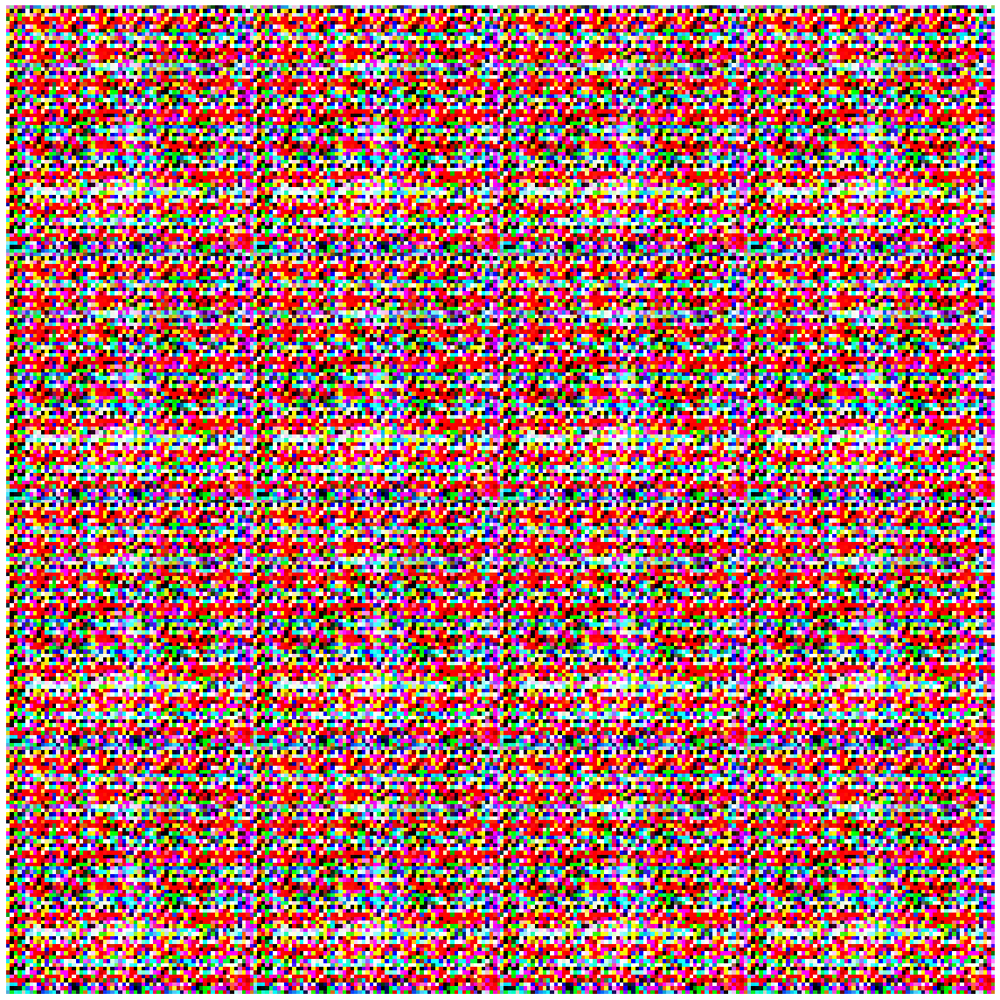

Disc: real loss: 1.254073 fake loss: 1.095781
GAN loss: 0.447499
Step 500 completed. Time took: 1 secs.
Begin step:  501
Disc: real loss: 1.249975 fake loss: 1.093116
GAN loss: 0.444547
Step 501 completed. Time took: 0 secs.
Begin step:  502
Disc: real loss: 1.266078 fake loss: 1.101187
GAN loss: 0.444656
Step 502 completed. Time took: 0 secs.
Begin step:  503
Disc: real loss: 1.282783 fake loss: 1.092373
GAN loss: 0.440871
Step 503 completed. Time took: 0 secs.
Begin step:  504
Disc: real loss: 1.273301 fake loss: 1.102567
GAN loss: 0.443329
Step 504 completed. Time took: 0 secs.
Begin step:  505
Disc: real loss: 1.280547 fake loss: 1.100817
GAN loss: 0.450423
Step 505 completed. Time took: 0 secs.
Begin step:  506
Disc: real loss: 1.258004 fake loss: 1.096952
GAN loss: 0.449396
Step 506 completed. Time took: 0 secs.
Begin step:  507
Disc: real loss: 1.294011 fake loss: 1.107769
GAN loss: 0.440281
Step 507 completed. Time took: 0 secs.
Begin step:  508
Disc: real loss: 1.265861 fake l

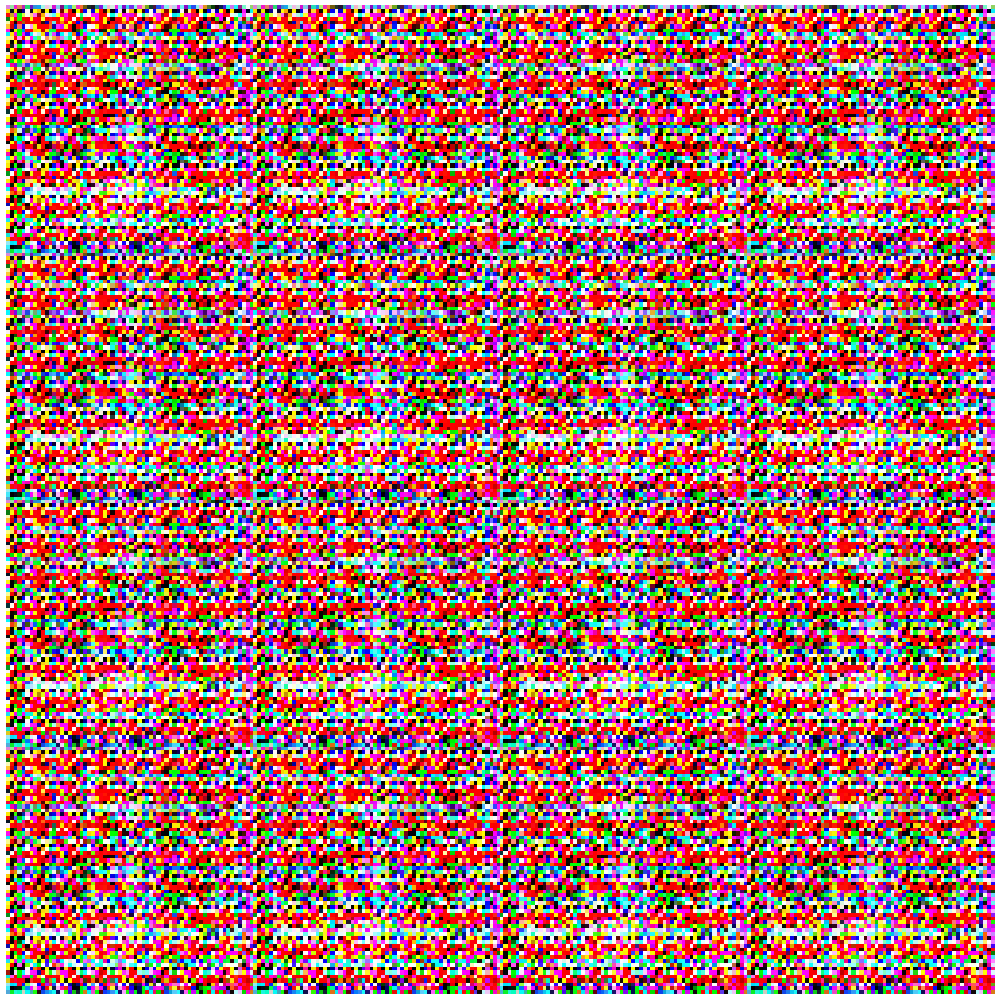

Disc: real loss: 1.274340 fake loss: 1.110187
GAN loss: 0.446678
Step 600 completed. Time took: 1 secs.
Begin step:  601
Disc: real loss: 1.308230 fake loss: 1.088047
GAN loss: 0.433649
Step 601 completed. Time took: 0 secs.
Begin step:  602
Disc: real loss: 1.249052 fake loss: 1.100990
GAN loss: 0.450436
Step 602 completed. Time took: 0 secs.
Begin step:  603
Disc: real loss: 1.272394 fake loss: 1.105862
GAN loss: 0.447255
Step 603 completed. Time took: 0 secs.
Begin step:  604
Disc: real loss: 1.290058 fake loss: 1.100619
GAN loss: 0.448783
Step 604 completed. Time took: 0 secs.
Begin step:  605
Disc: real loss: 1.264057 fake loss: 1.092074
GAN loss: 0.451938
Step 605 completed. Time took: 0 secs.
Begin step:  606
Disc: real loss: 1.290671 fake loss: 1.102728
GAN loss: 0.444991
Step 606 completed. Time took: 0 secs.
Begin step:  607
Disc: real loss: 1.283471 fake loss: 1.099527
GAN loss: 0.438750
Step 607 completed. Time took: 0 secs.
Begin step:  608
Disc: real loss: 1.284112 fake l

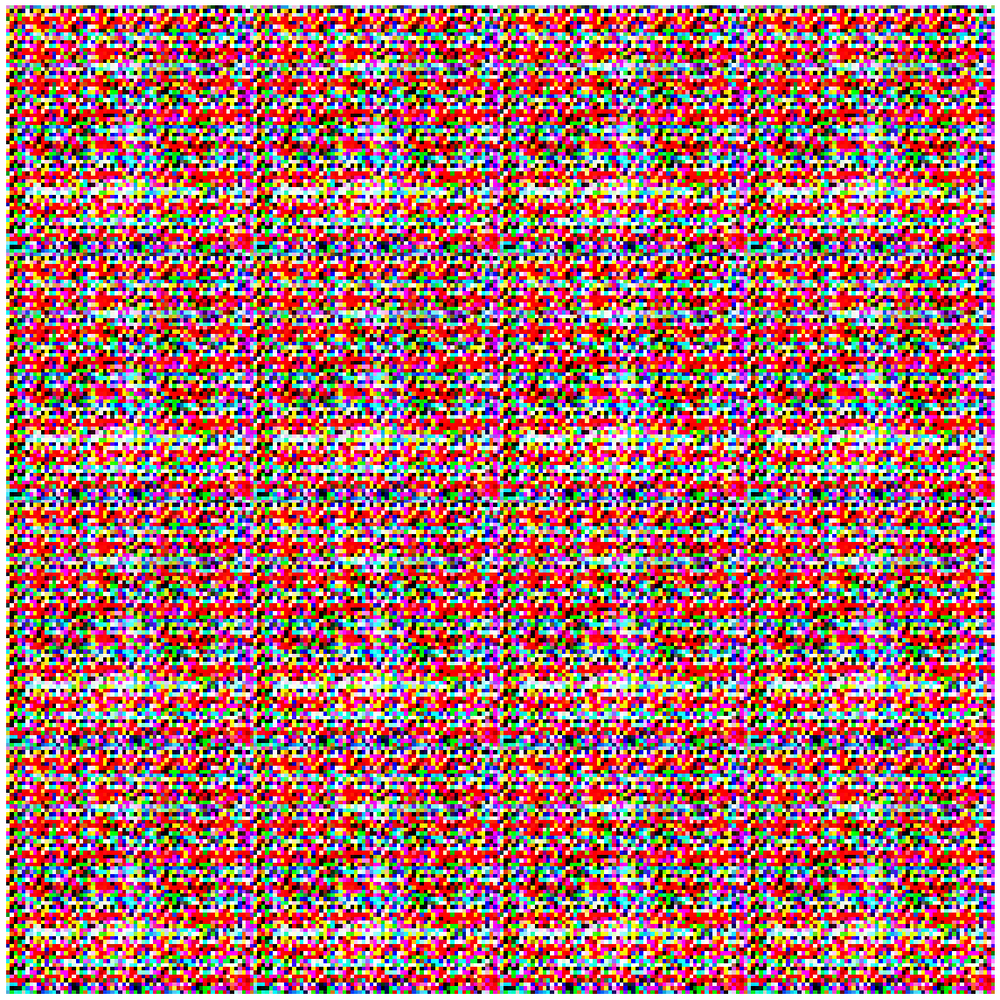

Disc: real loss: 1.281954 fake loss: 1.092443
GAN loss: 0.453371
Step 700 completed. Time took: 1 secs.
Begin step:  701
Disc: real loss: 1.283724 fake loss: 1.089501
GAN loss: 0.448597
Step 701 completed. Time took: 0 secs.
Begin step:  702
Disc: real loss: 1.301352 fake loss: 1.098217
GAN loss: 0.446413
Step 702 completed. Time took: 0 secs.
Begin step:  703
Disc: real loss: 1.270117 fake loss: 1.100461
GAN loss: 0.451289
Step 703 completed. Time took: 0 secs.
Begin step:  704
Disc: real loss: 1.266212 fake loss: 1.092496
GAN loss: 0.453864
Step 704 completed. Time took: 0 secs.
Begin step:  705
Disc: real loss: 1.298372 fake loss: 1.093049
GAN loss: 0.453796
Step 705 completed. Time took: 0 secs.
Begin step:  706
Disc: real loss: 1.254403 fake loss: 1.095597
GAN loss: 0.445670
Step 706 completed. Time took: 0 secs.
Begin step:  707
Disc: real loss: 1.261235 fake loss: 1.094367
GAN loss: 0.454561
Step 707 completed. Time took: 0 secs.
Begin step:  708
Disc: real loss: 1.299661 fake l

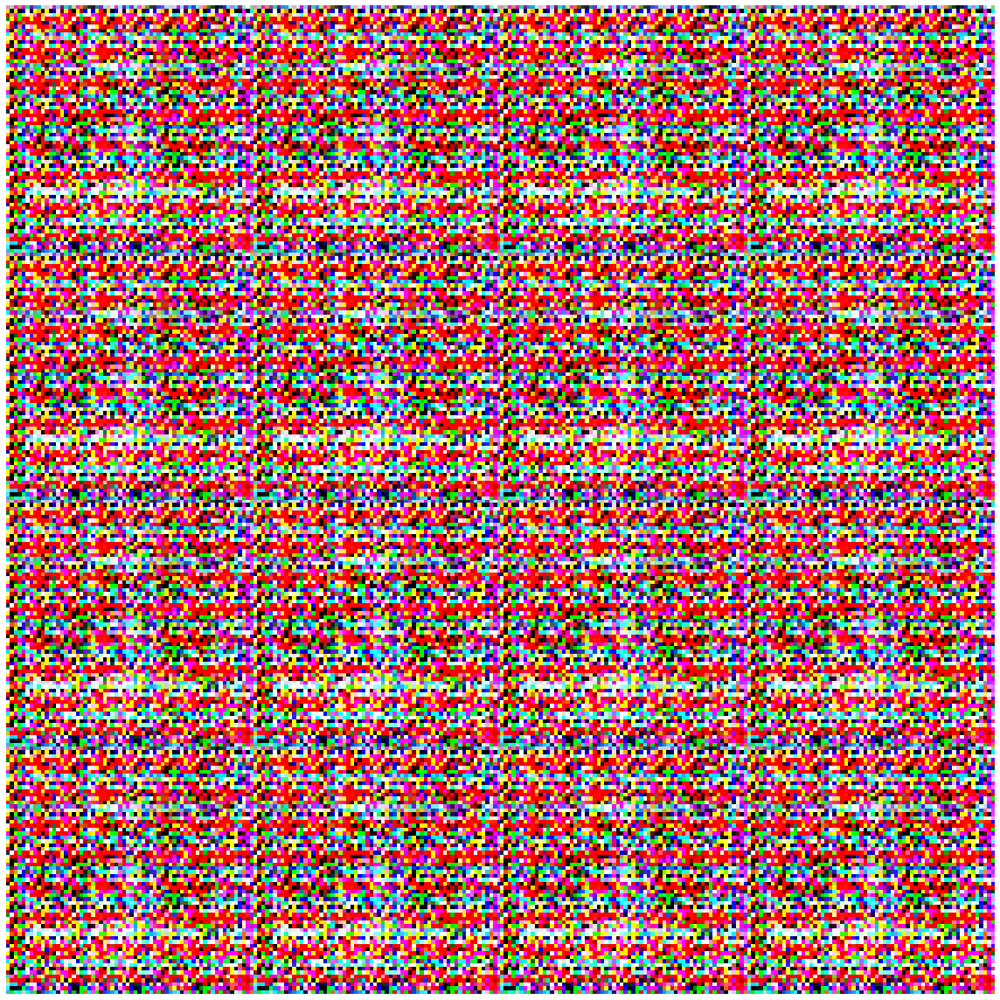

Disc: real loss: 1.268682 fake loss: 1.099589
GAN loss: 0.447750
Step 800 completed. Time took: 1 secs.
Begin step:  801
Disc: real loss: 1.270278 fake loss: 1.106243
GAN loss: 0.451274
Step 801 completed. Time took: 0 secs.
Begin step:  802
Disc: real loss: 1.291809 fake loss: 1.103537
GAN loss: 0.445841
Step 802 completed. Time took: 0 secs.
Begin step:  803
Disc: real loss: 1.245295 fake loss: 1.097097
GAN loss: 0.456794
Step 803 completed. Time took: 0 secs.
Begin step:  804
Disc: real loss: 1.275426 fake loss: 1.090273
GAN loss: 0.454154
Step 804 completed. Time took: 0 secs.
Begin step:  805
Disc: real loss: 1.287180 fake loss: 1.094498
GAN loss: 0.452379
Step 805 completed. Time took: 0 secs.
Begin step:  806
Disc: real loss: 1.291477 fake loss: 1.095867
GAN loss: 0.459087
Step 806 completed. Time took: 0 secs.
Begin step:  807
Disc: real loss: 1.288929 fake loss: 1.092449
GAN loss: 0.452753
Step 807 completed. Time took: 0 secs.
Begin step:  808
Disc: real loss: 1.230101 fake l

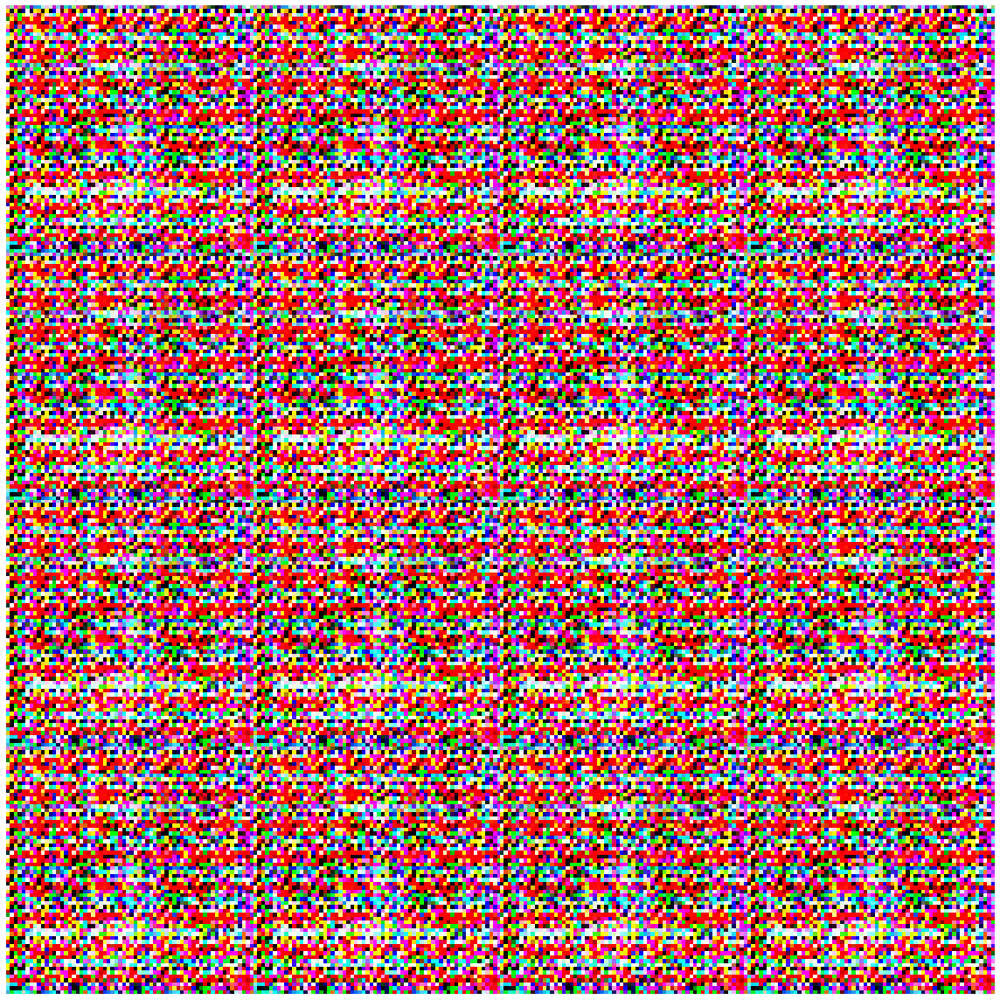

Disc: real loss: 1.291327 fake loss: 1.109848
GAN loss: 0.450122
Step 900 completed. Time took: 1 secs.
Begin step:  901
Disc: real loss: 1.268175 fake loss: 1.085084
GAN loss: 0.450353
Step 901 completed. Time took: 0 secs.
Begin step:  902
Disc: real loss: 1.274395 fake loss: 1.091447
GAN loss: 0.445700
Step 902 completed. Time took: 0 secs.
Begin step:  903
Disc: real loss: 1.263288 fake loss: 1.108085
GAN loss: 0.454188
Step 903 completed. Time took: 0 secs.
Begin step:  904
Disc: real loss: 1.255380 fake loss: 1.098540
GAN loss: 0.453511
Step 904 completed. Time took: 0 secs.
Begin step:  905
Disc: real loss: 1.265152 fake loss: 1.100523
GAN loss: 0.458071
Step 905 completed. Time took: 0 secs.
Begin step:  906
Disc: real loss: 1.323333 fake loss: 1.099610
GAN loss: 0.448342
Step 906 completed. Time took: 0 secs.
Begin step:  907
Disc: real loss: 1.298079 fake loss: 1.101016
GAN loss: 0.439652
Step 907 completed. Time took: 0 secs.
Begin step:  908
Disc: real loss: 1.245242 fake l

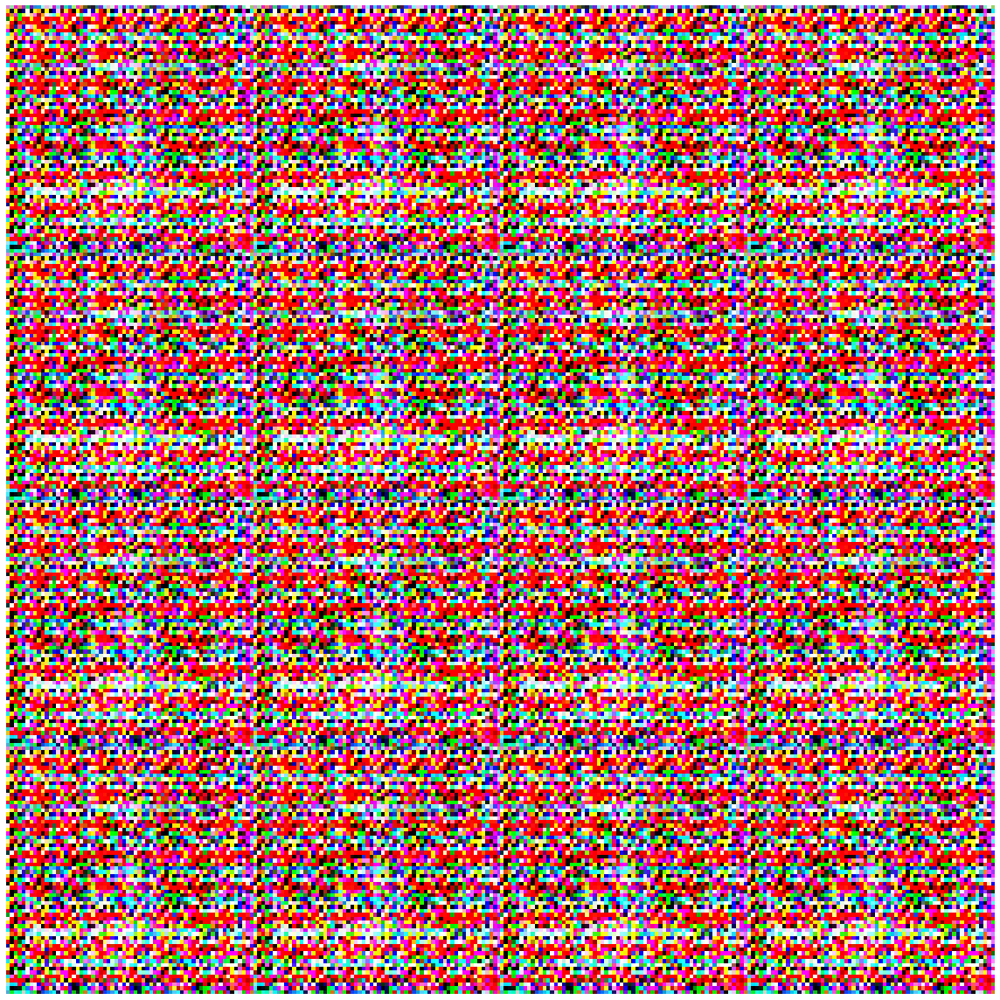

Begin step:  1000


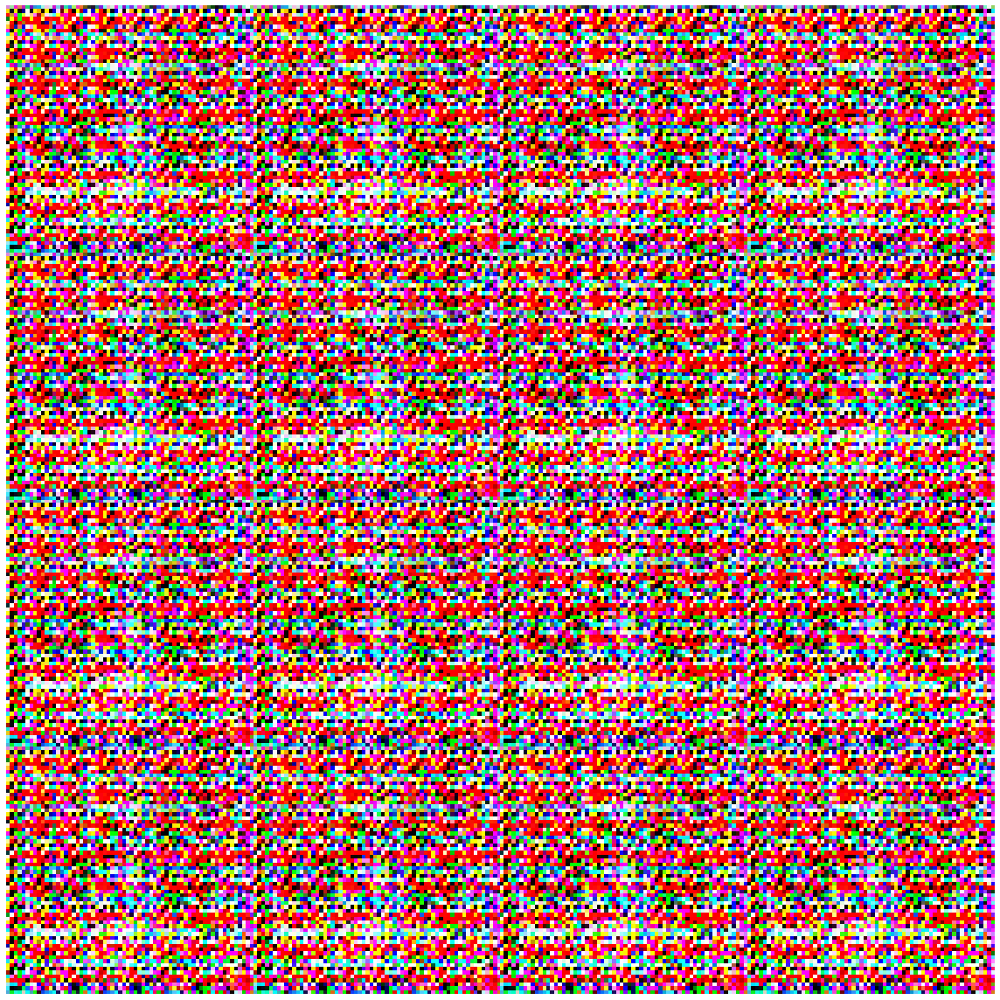

Disc: real loss: 1.263653 fake loss: 1.100017
GAN loss: 0.442402
Step 1000 completed. Time took: 1 secs.
Begin step:  1001
Disc: real loss: 1.280845 fake loss: 1.093927
GAN loss: 0.453494
Step 1001 completed. Time took: 0 secs.
Begin step:  1002
Disc: real loss: 1.256713 fake loss: 1.090497
GAN loss: 0.444271
Step 1002 completed. Time took: 0 secs.
Begin step:  1003
Disc: real loss: 1.254598 fake loss: 1.102720
GAN loss: 0.460028
Step 1003 completed. Time took: 0 secs.
Begin step:  1004
Disc: real loss: 1.289722 fake loss: 1.094115
GAN loss: 0.441527
Step 1004 completed. Time took: 0 secs.
Begin step:  1005
Disc: real loss: 1.267316 fake loss: 1.099411
GAN loss: 0.457260
Step 1005 completed. Time took: 0 secs.
Begin step:  1006
Disc: real loss: 1.285231 fake loss: 1.091122
GAN loss: 0.440226
Step 1006 completed. Time took: 0 secs.
Begin step:  1007
Disc: real loss: 1.316696 fake loss: 1.102598
GAN loss: 0.450174
Step 1007 completed. Time took: 0 secs.
Begin step:  1008
Disc: real loss:

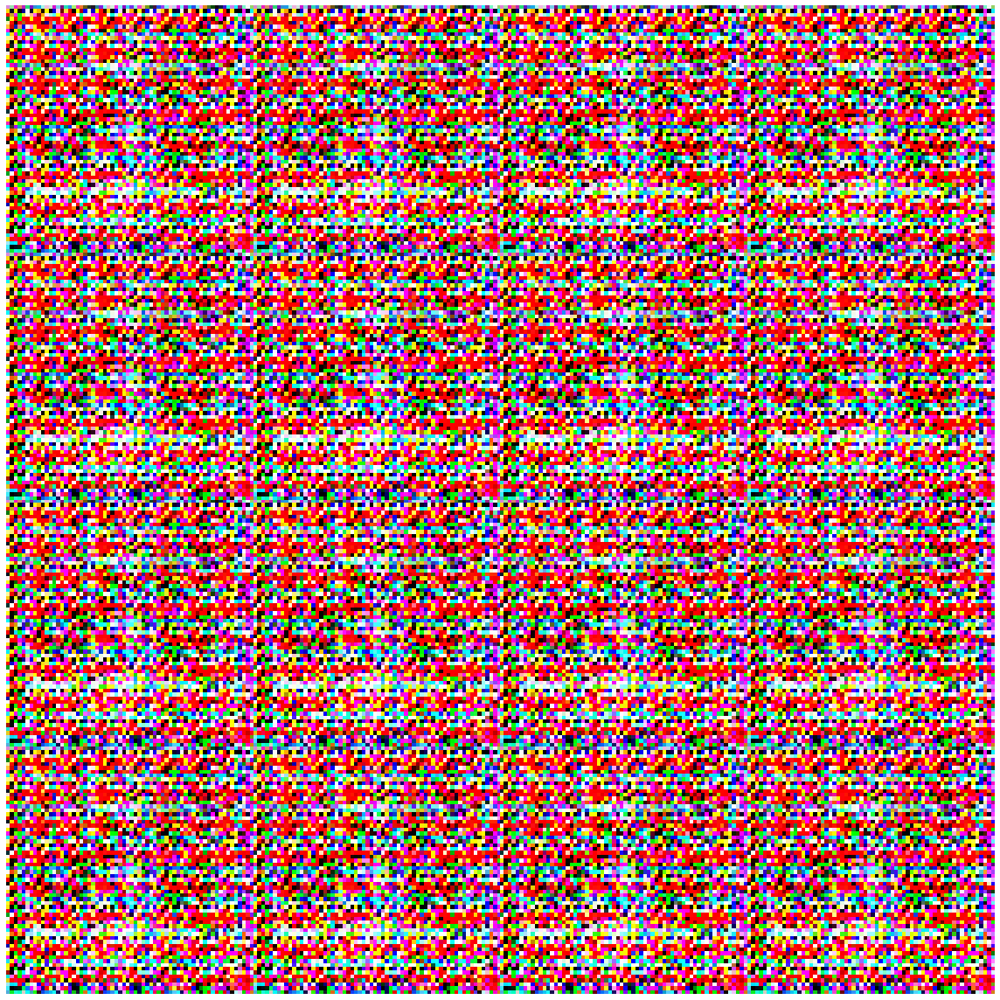

Disc: real loss: 1.260315 fake loss: 1.090420
GAN loss: 0.447807
Step 1100 completed. Time took: 1 secs.
Begin step:  1101
Disc: real loss: 1.250072 fake loss: 1.092073
GAN loss: 0.454480
Step 1101 completed. Time took: 0 secs.
Begin step:  1102
Disc: real loss: 1.274517 fake loss: 1.099559
GAN loss: 0.438124
Step 1102 completed. Time took: 0 secs.
Begin step:  1103
Disc: real loss: 1.257051 fake loss: 1.088344
GAN loss: 0.449306
Step 1103 completed. Time took: 0 secs.
Begin step:  1104
Disc: real loss: 1.291011 fake loss: 1.106226
GAN loss: 0.447357
Step 1104 completed. Time took: 0 secs.
Begin step:  1105
Disc: real loss: 1.286252 fake loss: 1.091895
GAN loss: 0.441805
Step 1105 completed. Time took: 0 secs.
Begin step:  1106
Disc: real loss: 1.282538 fake loss: 1.093052
GAN loss: 0.450218
Step 1106 completed. Time took: 0 secs.
Begin step:  1107
Disc: real loss: 1.280906 fake loss: 1.103541
GAN loss: 0.439757
Step 1107 completed. Time took: 0 secs.
Begin step:  1108
Disc: real loss:

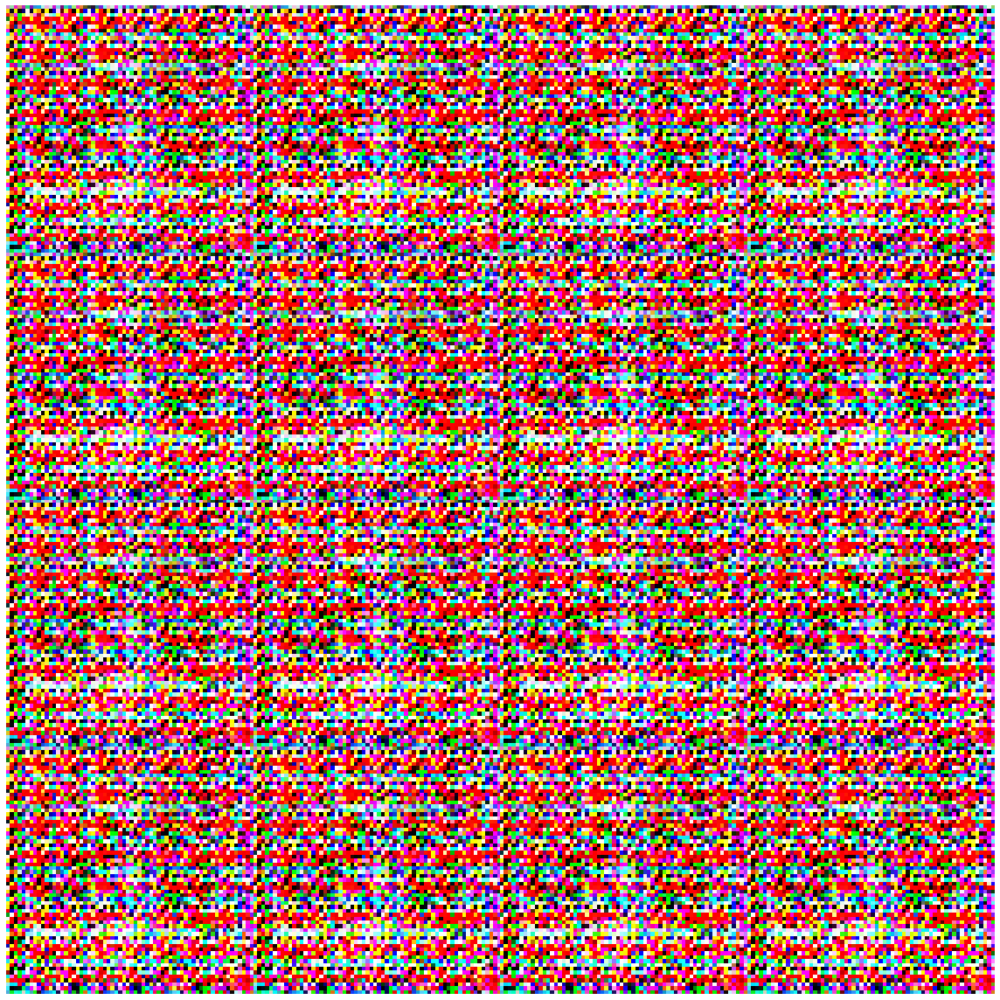

Disc: real loss: 1.326613 fake loss: 1.104939
GAN loss: 0.437545
Step 1200 completed. Time took: 1 secs.
Begin step:  1201
Disc: real loss: 1.302635 fake loss: 1.103398
GAN loss: 0.433576
Step 1201 completed. Time took: 0 secs.
Begin step:  1202
Disc: real loss: 1.249079 fake loss: 1.091780
GAN loss: 0.444453
Step 1202 completed. Time took: 0 secs.
Begin step:  1203
Disc: real loss: 1.304861 fake loss: 1.106685
GAN loss: 0.446069
Step 1203 completed. Time took: 0 secs.
Begin step:  1204
Disc: real loss: 1.271028 fake loss: 1.080347
GAN loss: 0.456645
Step 1204 completed. Time took: 0 secs.
Begin step:  1205
Disc: real loss: 1.309551 fake loss: 1.092233
GAN loss: 0.438811
Step 1205 completed. Time took: 0 secs.
Begin step:  1206
Disc: real loss: 1.274857 fake loss: 1.096232
GAN loss: 0.451682
Step 1206 completed. Time took: 0 secs.
Begin step:  1207
Disc: real loss: 1.278814 fake loss: 1.088588
GAN loss: 0.441980
Step 1207 completed. Time took: 0 secs.
Begin step:  1208
Disc: real loss:

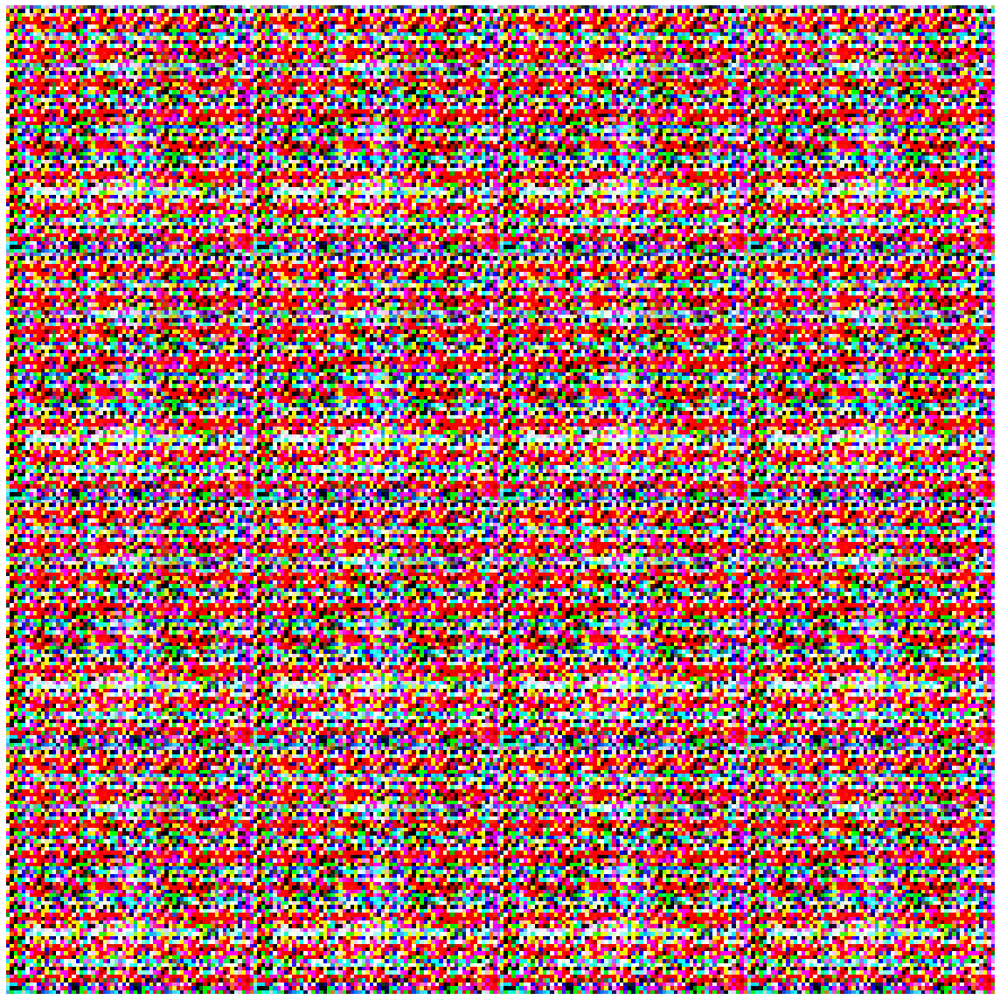

Disc: real loss: 1.282186 fake loss: 1.100062
GAN loss: 0.450192
Step 1300 completed. Time took: 1 secs.
Begin step:  1301
Disc: real loss: 1.305391 fake loss: 1.102104
GAN loss: 0.440761
Step 1301 completed. Time took: 0 secs.
Begin step:  1302
Disc: real loss: 1.256289 fake loss: 1.089360
GAN loss: 0.457040
Step 1302 completed. Time took: 0 secs.
Begin step:  1303
Disc: real loss: 1.291566 fake loss: 1.099512
GAN loss: 0.449375
Step 1303 completed. Time took: 0 secs.
Begin step:  1304
Disc: real loss: 1.310135 fake loss: 1.094736
GAN loss: 0.448621
Step 1304 completed. Time took: 0 secs.
Begin step:  1305
Disc: real loss: 1.267482 fake loss: 1.103417
GAN loss: 0.445611
Step 1305 completed. Time took: 0 secs.
Begin step:  1306
Disc: real loss: 1.244773 fake loss: 1.094108
GAN loss: 0.457494
Step 1306 completed. Time took: 0 secs.
Begin step:  1307
Disc: real loss: 1.284464 fake loss: 1.099859
GAN loss: 0.459266
Step 1307 completed. Time took: 0 secs.
Begin step:  1308
Disc: real loss:

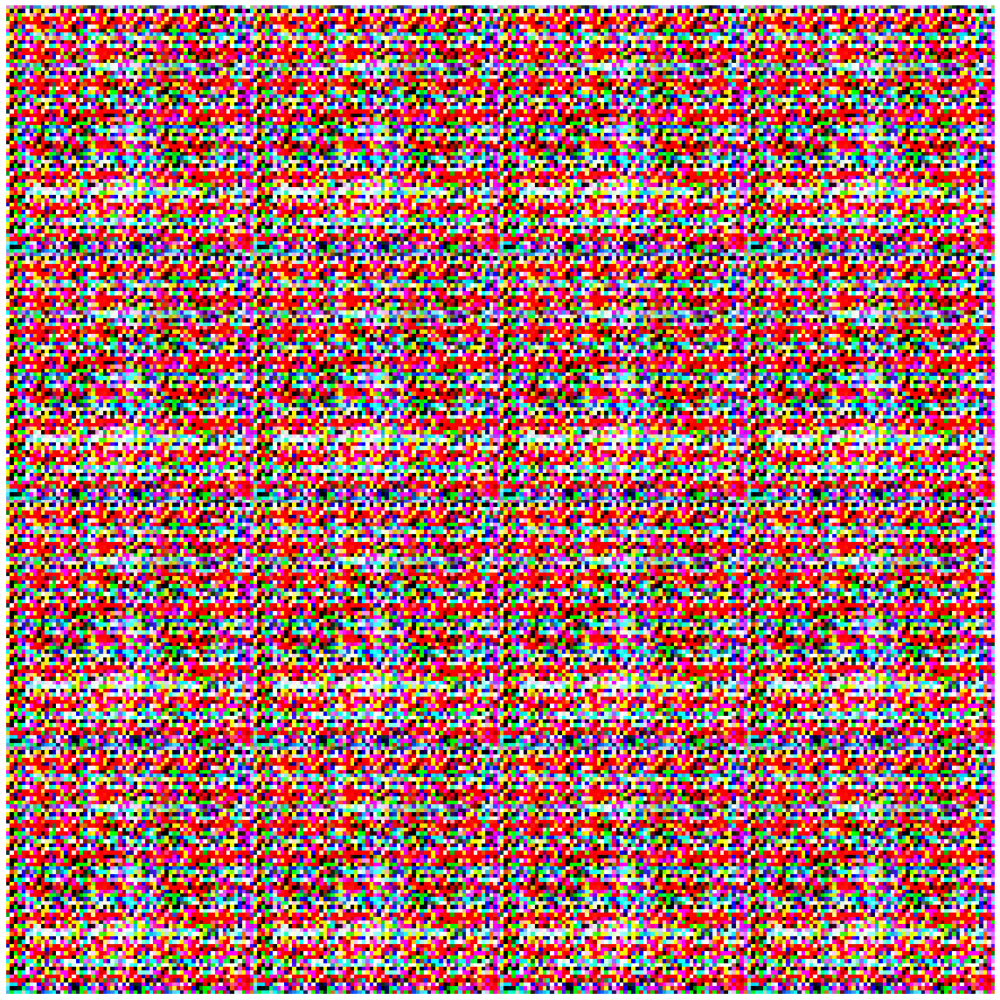

Disc: real loss: 1.272266 fake loss: 1.091354
GAN loss: 0.447479
Step 1400 completed. Time took: 1 secs.
Begin step:  1401
Disc: real loss: 1.267655 fake loss: 1.102941
GAN loss: 0.446876
Step 1401 completed. Time took: 0 secs.
Begin step:  1402
Disc: real loss: 1.275698 fake loss: 1.101933
GAN loss: 0.446848
Step 1402 completed. Time took: 0 secs.
Begin step:  1403
Disc: real loss: 1.266767 fake loss: 1.100371
GAN loss: 0.456644
Step 1403 completed. Time took: 0 secs.
Begin step:  1404
Disc: real loss: 1.283186 fake loss: 1.104571
GAN loss: 0.450966
Step 1404 completed. Time took: 0 secs.
Begin step:  1405
Disc: real loss: 1.290034 fake loss: 1.104425
GAN loss: 0.457604
Step 1405 completed. Time took: 0 secs.
Begin step:  1406
Disc: real loss: 1.308164 fake loss: 1.102298
GAN loss: 0.438517
Step 1406 completed. Time took: 0 secs.
Begin step:  1407
Disc: real loss: 1.258041 fake loss: 1.098265
GAN loss: 0.444445
Step 1407 completed. Time took: 0 secs.
Begin step:  1408
Disc: real loss:

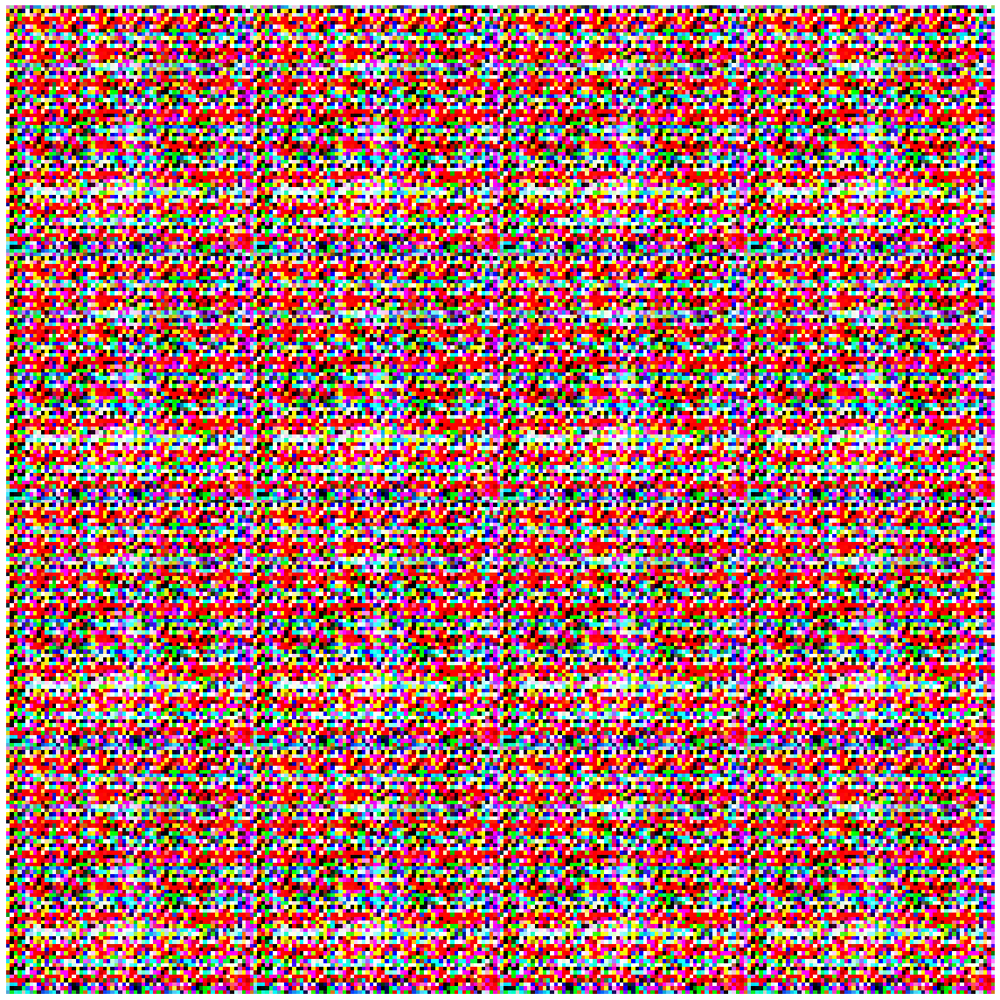

Begin step:  1500


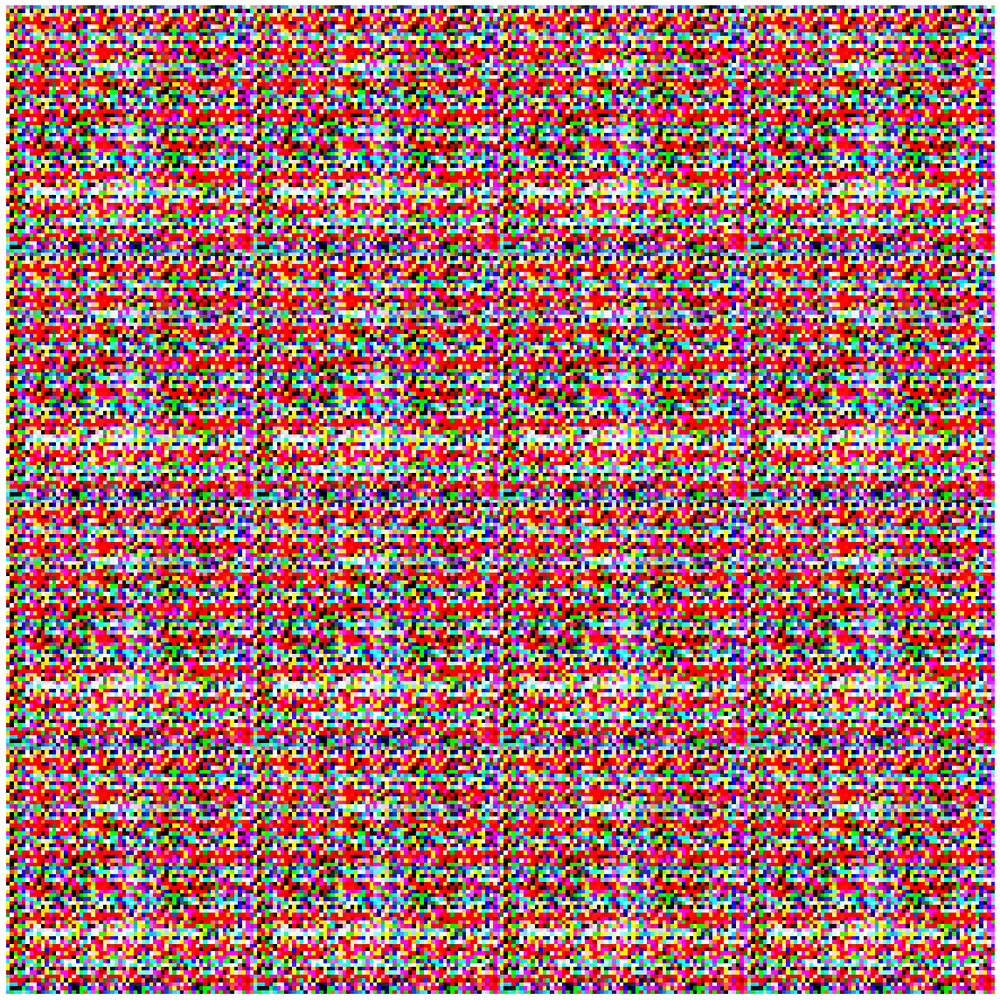

Disc: real loss: 1.284122 fake loss: 1.094929
GAN loss: 0.454321
Step 1500 completed. Time took: 1 secs.
Begin step:  1501
Disc: real loss: 1.291351 fake loss: 1.095004
GAN loss: 0.450692
Step 1501 completed. Time took: 0 secs.
Begin step:  1502
Disc: real loss: 1.297309 fake loss: 1.093604
GAN loss: 0.446749
Step 1502 completed. Time took: 0 secs.
Begin step:  1503
Disc: real loss: 1.272415 fake loss: 1.100656
GAN loss: 0.444573
Step 1503 completed. Time took: 0 secs.
Begin step:  1504
Disc: real loss: 1.280638 fake loss: 1.105887
GAN loss: 0.453574
Step 1504 completed. Time took: 0 secs.
Begin step:  1505
Disc: real loss: 1.262852 fake loss: 1.093581
GAN loss: 0.452264
Step 1505 completed. Time took: 0 secs.
Begin step:  1506
Disc: real loss: 1.244169 fake loss: 1.104748
GAN loss: 0.452096
Step 1506 completed. Time took: 0 secs.
Begin step:  1507
Disc: real loss: 1.272221 fake loss: 1.096176
GAN loss: 0.446059
Step 1507 completed. Time took: 0 secs.
Begin step:  1508
Disc: real loss:

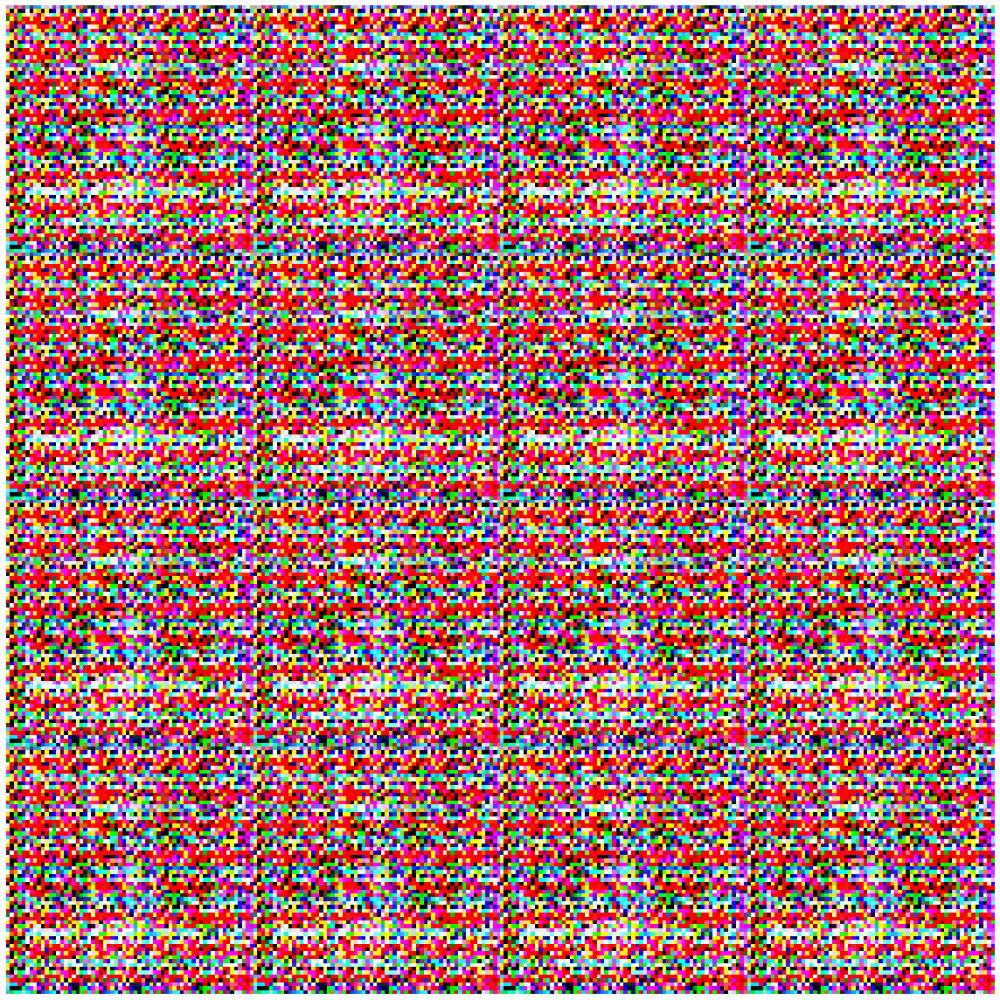

Disc: real loss: 1.230103 fake loss: 1.095679
GAN loss: 0.452644
Step 1600 completed. Time took: 1 secs.
Begin step:  1601
Disc: real loss: 1.279033 fake loss: 1.097257
GAN loss: 0.446451
Step 1601 completed. Time took: 0 secs.
Begin step:  1602
Disc: real loss: 1.280524 fake loss: 1.098796
GAN loss: 0.445339
Step 1602 completed. Time took: 0 secs.
Begin step:  1603
Disc: real loss: 1.255506 fake loss: 1.093276
GAN loss: 0.459352
Step 1603 completed. Time took: 0 secs.
Begin step:  1604
Disc: real loss: 1.282922 fake loss: 1.093208
GAN loss: 0.444998
Step 1604 completed. Time took: 0 secs.
Begin step:  1605
Disc: real loss: 1.262670 fake loss: 1.106931
GAN loss: 0.451049
Step 1605 completed. Time took: 0 secs.
Begin step:  1606
Disc: real loss: 1.269435 fake loss: 1.096391
GAN loss: 0.452006
Step 1606 completed. Time took: 0 secs.
Begin step:  1607
Disc: real loss: 1.301972 fake loss: 1.100233
GAN loss: 0.442236
Step 1607 completed. Time took: 0 secs.
Begin step:  1608
Disc: real loss:

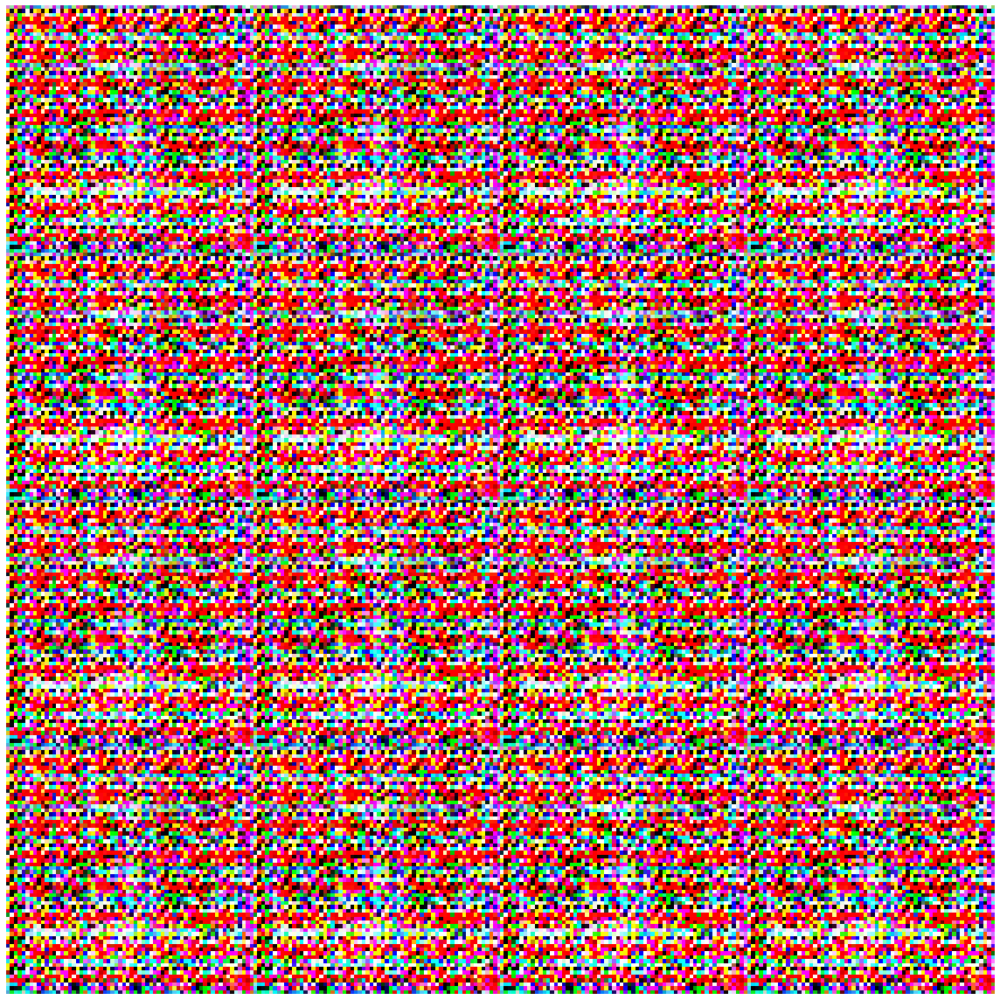

Disc: real loss: 1.285351 fake loss: 1.103295
GAN loss: 0.445722
Step 1700 completed. Time took: 1 secs.
Begin step:  1701
Disc: real loss: 1.268290 fake loss: 1.096284
GAN loss: 0.450235
Step 1701 completed. Time took: 0 secs.
Begin step:  1702
Disc: real loss: 1.268655 fake loss: 1.099948
GAN loss: 0.447422
Step 1702 completed. Time took: 0 secs.
Begin step:  1703
Disc: real loss: 1.317501 fake loss: 1.095478
GAN loss: 0.447852
Step 1703 completed. Time took: 0 secs.
Begin step:  1704
Disc: real loss: 1.273551 fake loss: 1.099423
GAN loss: 0.452863
Step 1704 completed. Time took: 0 secs.
Begin step:  1705
Disc: real loss: 1.285258 fake loss: 1.102761
GAN loss: 0.451056
Step 1705 completed. Time took: 0 secs.
Begin step:  1706
Disc: real loss: 1.259648 fake loss: 1.105052
GAN loss: 0.445385
Step 1706 completed. Time took: 0 secs.
Begin step:  1707
Disc: real loss: 1.282128 fake loss: 1.098735
GAN loss: 0.447999
Step 1707 completed. Time took: 0 secs.
Begin step:  1708
Disc: real loss:

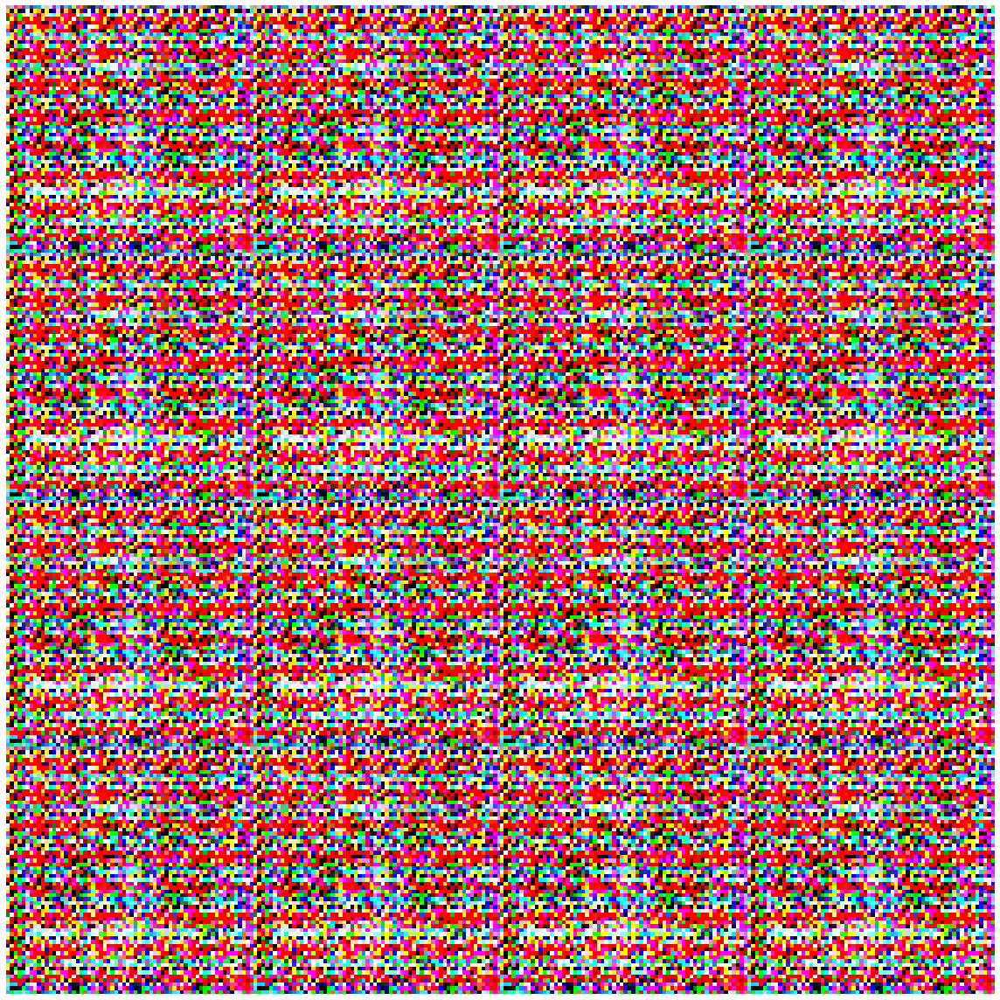

Disc: real loss: 1.290861 fake loss: 1.085801
GAN loss: 0.456032
Step 1800 completed. Time took: 1 secs.
Begin step:  1801
Disc: real loss: 1.263419 fake loss: 1.095111
GAN loss: 0.457190
Step 1801 completed. Time took: 0 secs.
Begin step:  1802
Disc: real loss: 1.272726 fake loss: 1.093172
GAN loss: 0.453797
Step 1802 completed. Time took: 0 secs.
Begin step:  1803
Disc: real loss: 1.235984 fake loss: 1.113338
GAN loss: 0.452552
Step 1803 completed. Time took: 0 secs.
Begin step:  1804
Disc: real loss: 1.277284 fake loss: 1.094289
GAN loss: 0.450844
Step 1804 completed. Time took: 0 secs.
Begin step:  1805
Disc: real loss: 1.289609 fake loss: 1.103310
GAN loss: 0.454176
Step 1805 completed. Time took: 0 secs.
Begin step:  1806
Disc: real loss: 1.309102 fake loss: 1.097716
GAN loss: 0.449973
Step 1806 completed. Time took: 0 secs.
Begin step:  1807
Disc: real loss: 1.276553 fake loss: 1.096404
GAN loss: 0.451236
Step 1807 completed. Time took: 0 secs.
Begin step:  1808
Disc: real loss:

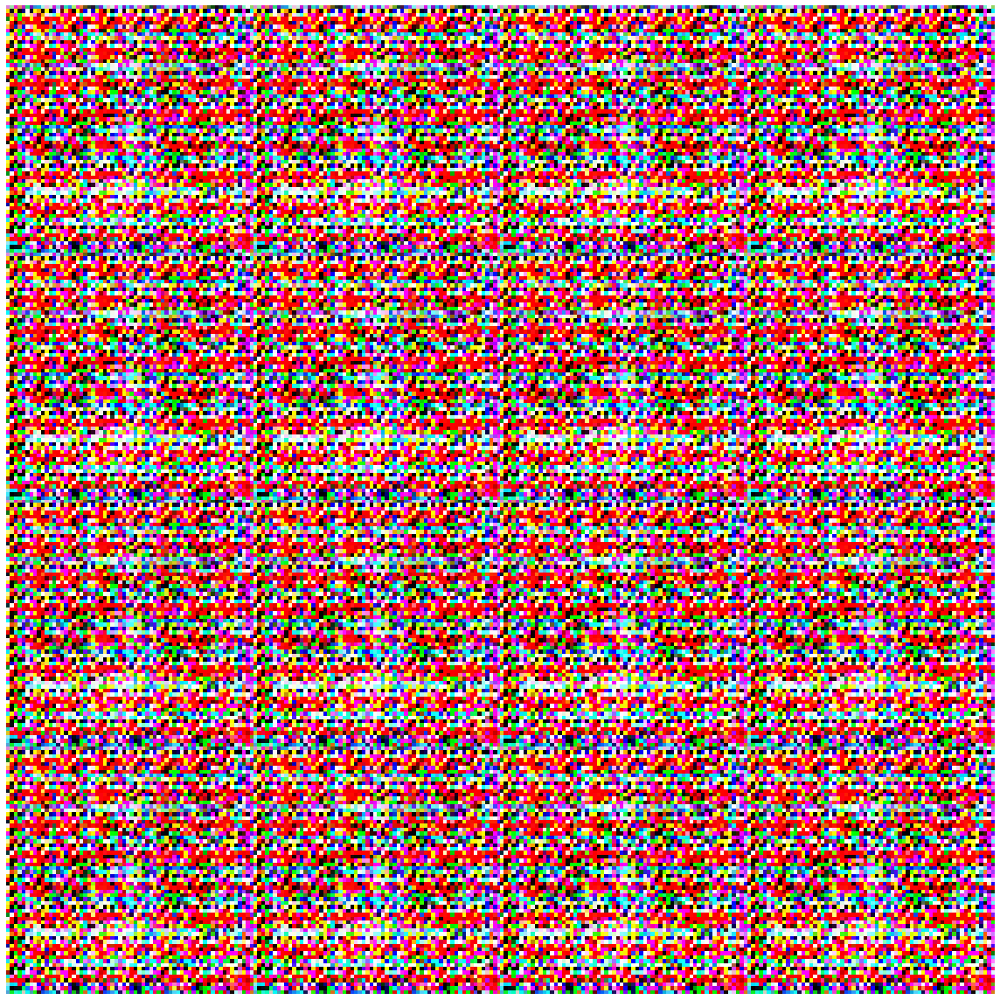

Disc: real loss: 1.280852 fake loss: 1.088359
GAN loss: 0.447339
Step 1900 completed. Time took: 1 secs.
Begin step:  1901
Disc: real loss: 1.298011 fake loss: 1.104011
GAN loss: 0.447429
Step 1901 completed. Time took: 0 secs.
Begin step:  1902
Disc: real loss: 1.260623 fake loss: 1.097984
GAN loss: 0.451256
Step 1902 completed. Time took: 0 secs.
Begin step:  1903
Disc: real loss: 1.274274 fake loss: 1.094562
GAN loss: 0.453693
Step 1903 completed. Time took: 0 secs.
Begin step:  1904
Disc: real loss: 1.258502 fake loss: 1.085736
GAN loss: 0.466011
Step 1904 completed. Time took: 0 secs.
Begin step:  1905
Disc: real loss: 1.260312 fake loss: 1.094937
GAN loss: 0.442831
Step 1905 completed. Time took: 0 secs.
Begin step:  1906
Disc: real loss: 1.279384 fake loss: 1.094665
GAN loss: 0.444504
Step 1906 completed. Time took: 0 secs.
Begin step:  1907
Disc: real loss: 1.269696 fake loss: 1.091805
GAN loss: 0.443900
Step 1907 completed. Time took: 0 secs.
Begin step:  1908
Disc: real loss:

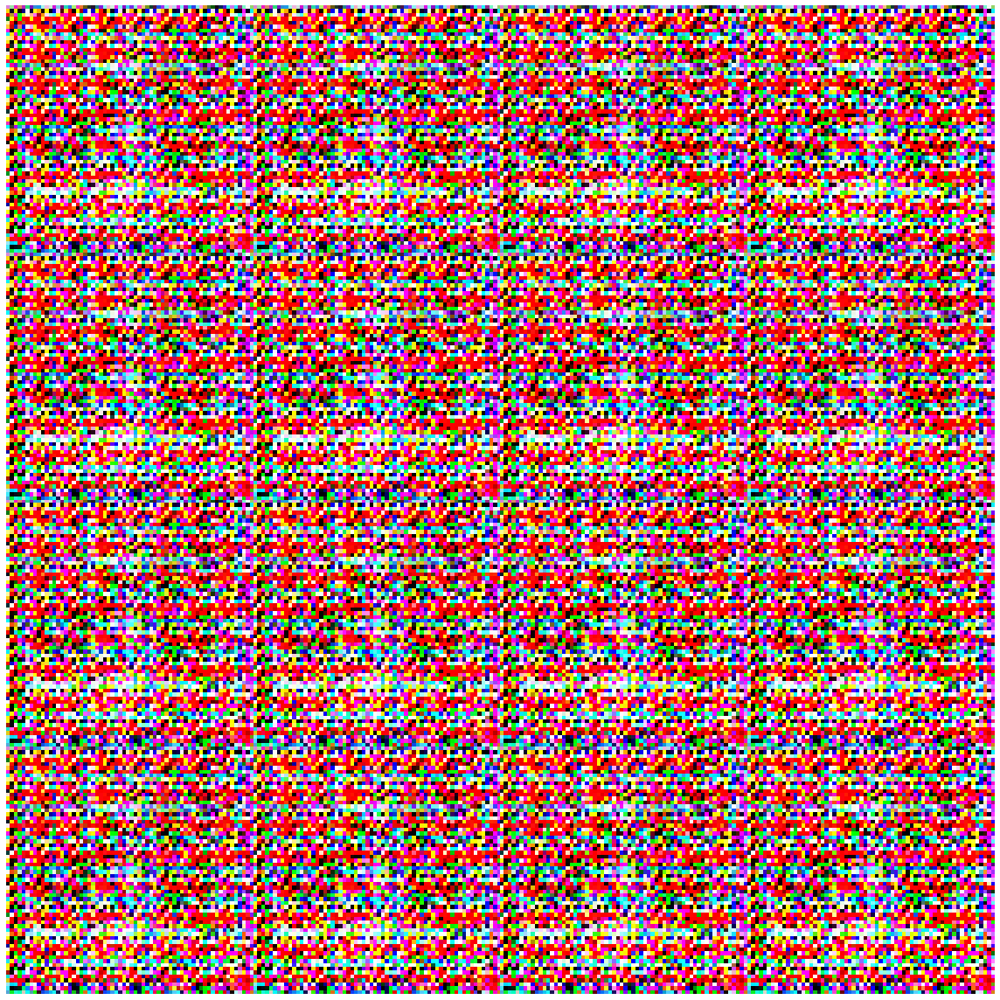

Begin step:  2000


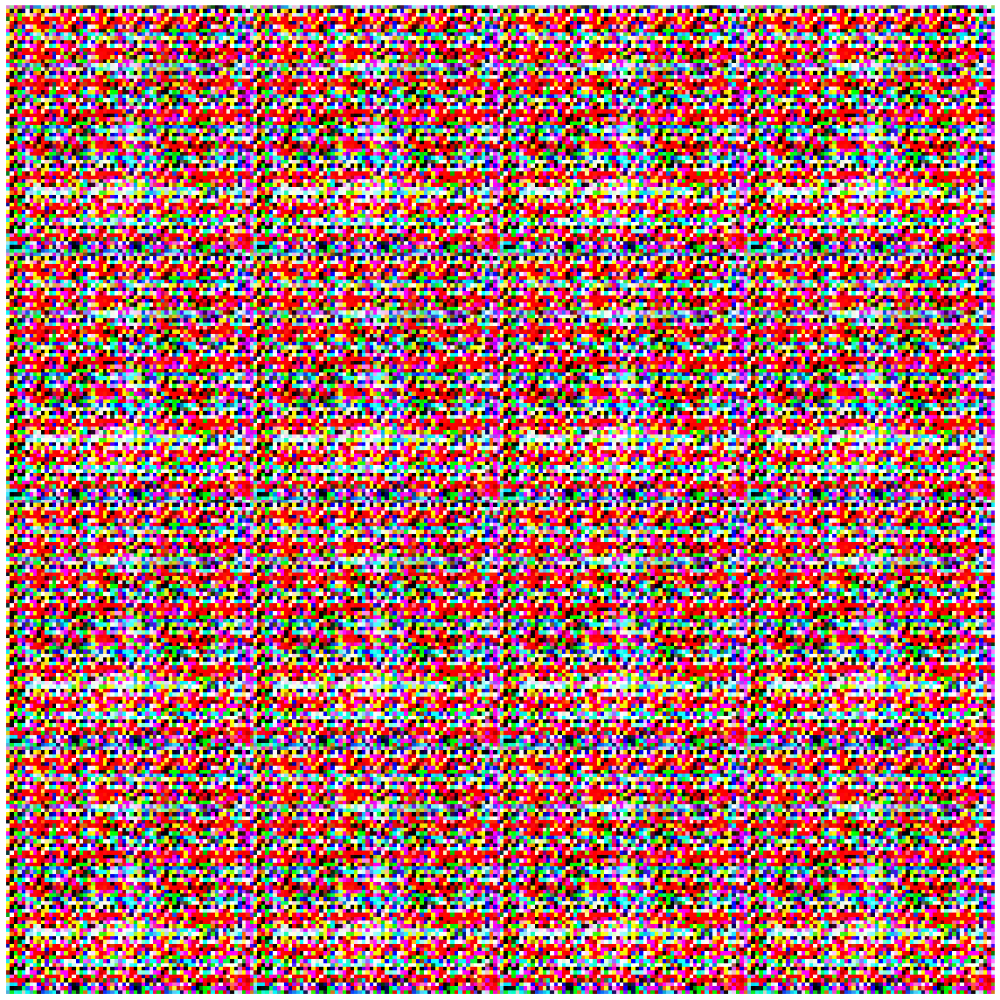

Disc: real loss: 1.280238 fake loss: 1.090315
GAN loss: 0.447480
Step 2000 completed. Time took: 1 secs.
Begin step:  2001
Disc: real loss: 1.281462 fake loss: 1.088517
GAN loss: 0.449719
Step 2001 completed. Time took: 0 secs.
Begin step:  2002
Disc: real loss: 1.255591 fake loss: 1.096642
GAN loss: 0.450158
Step 2002 completed. Time took: 0 secs.
Begin step:  2003
Disc: real loss: 1.289832 fake loss: 1.087988
GAN loss: 0.445999
Step 2003 completed. Time took: 0 secs.
Begin step:  2004
Disc: real loss: 1.272717 fake loss: 1.090486
GAN loss: 0.444399
Step 2004 completed. Time took: 0 secs.
Begin step:  2005
Disc: real loss: 1.248980 fake loss: 1.096218
GAN loss: 0.452211
Step 2005 completed. Time took: 0 secs.
Begin step:  2006
Disc: real loss: 1.280781 fake loss: 1.098719
GAN loss: 0.446589
Step 2006 completed. Time took: 0 secs.
Begin step:  2007
Disc: real loss: 1.271659 fake loss: 1.093493
GAN loss: 0.455862
Step 2007 completed. Time took: 0 secs.
Begin step:  2008
Disc: real loss:

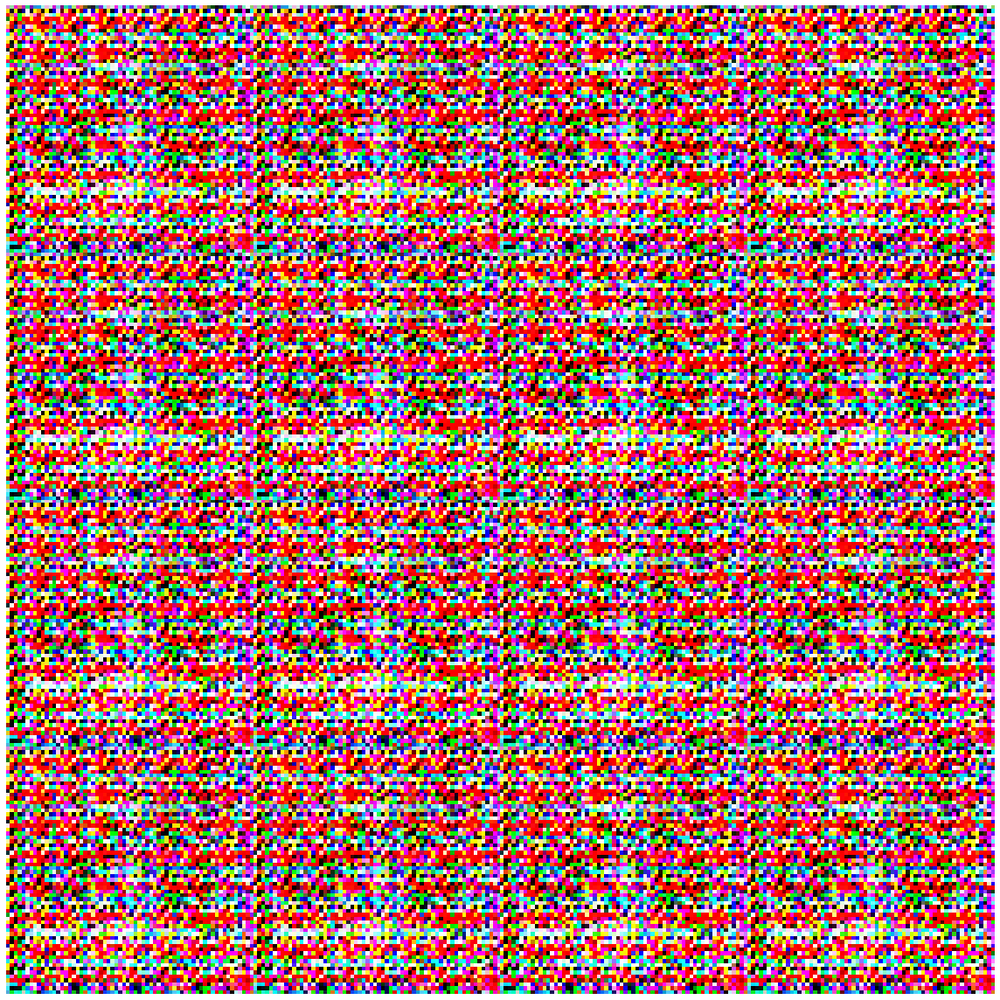

Disc: real loss: 1.286763 fake loss: 1.087152
GAN loss: 0.447090
Step 2100 completed. Time took: 1 secs.
Begin step:  2101
Disc: real loss: 1.278707 fake loss: 1.097952
GAN loss: 0.451267
Step 2101 completed. Time took: 0 secs.
Begin step:  2102
Disc: real loss: 1.293849 fake loss: 1.089487
GAN loss: 0.446024
Step 2102 completed. Time took: 0 secs.
Begin step:  2103
Disc: real loss: 1.280435 fake loss: 1.099197
GAN loss: 0.444360
Step 2103 completed. Time took: 0 secs.
Begin step:  2104
Disc: real loss: 1.260728 fake loss: 1.099206
GAN loss: 0.449335
Step 2104 completed. Time took: 0 secs.
Begin step:  2105
Disc: real loss: 1.266145 fake loss: 1.089919
GAN loss: 0.442224
Step 2105 completed. Time took: 0 secs.
Begin step:  2106
Disc: real loss: 1.251145 fake loss: 1.091648
GAN loss: 0.444816
Step 2106 completed. Time took: 0 secs.
Begin step:  2107
Disc: real loss: 1.264208 fake loss: 1.104290
GAN loss: 0.462998
Step 2107 completed. Time took: 0 secs.
Begin step:  2108
Disc: real loss:

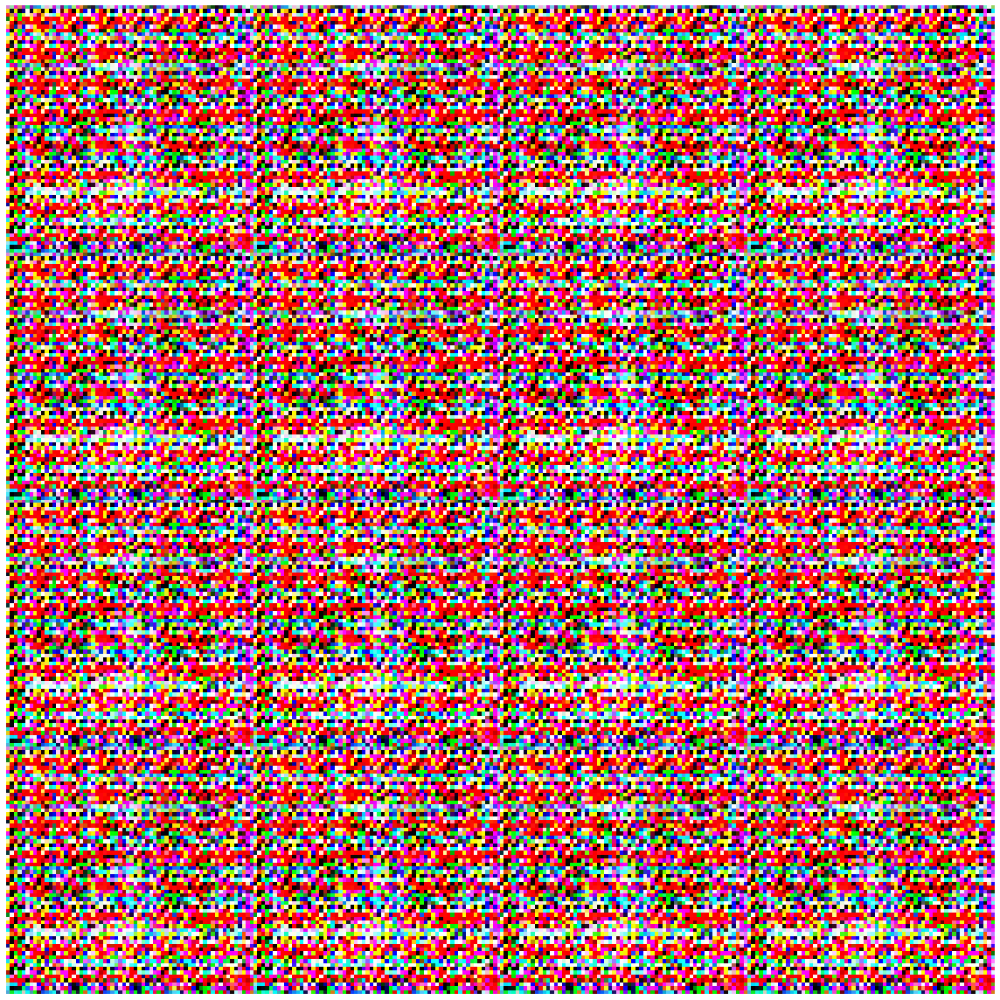

Disc: real loss: 1.259360 fake loss: 1.089676
GAN loss: 0.455373
Step 2200 completed. Time took: 1 secs.
Begin step:  2201
Disc: real loss: 1.291154 fake loss: 1.100473
GAN loss: 0.447945
Step 2201 completed. Time took: 0 secs.
Begin step:  2202
Disc: real loss: 1.255619 fake loss: 1.098448
GAN loss: 0.453620
Step 2202 completed. Time took: 0 secs.
Begin step:  2203
Disc: real loss: 1.237100 fake loss: 1.098323
GAN loss: 0.448878
Step 2203 completed. Time took: 0 secs.
Begin step:  2204
Disc: real loss: 1.266866 fake loss: 1.100559
GAN loss: 0.461196
Step 2204 completed. Time took: 0 secs.
Begin step:  2205
Disc: real loss: 1.262769 fake loss: 1.101111
GAN loss: 0.452160
Step 2205 completed. Time took: 0 secs.
Begin step:  2206
Disc: real loss: 1.244690 fake loss: 1.103776
GAN loss: 0.456875
Step 2206 completed. Time took: 0 secs.
Begin step:  2207
Disc: real loss: 1.289379 fake loss: 1.114454
GAN loss: 0.449512
Step 2207 completed. Time took: 0 secs.
Begin step:  2208
Disc: real loss:

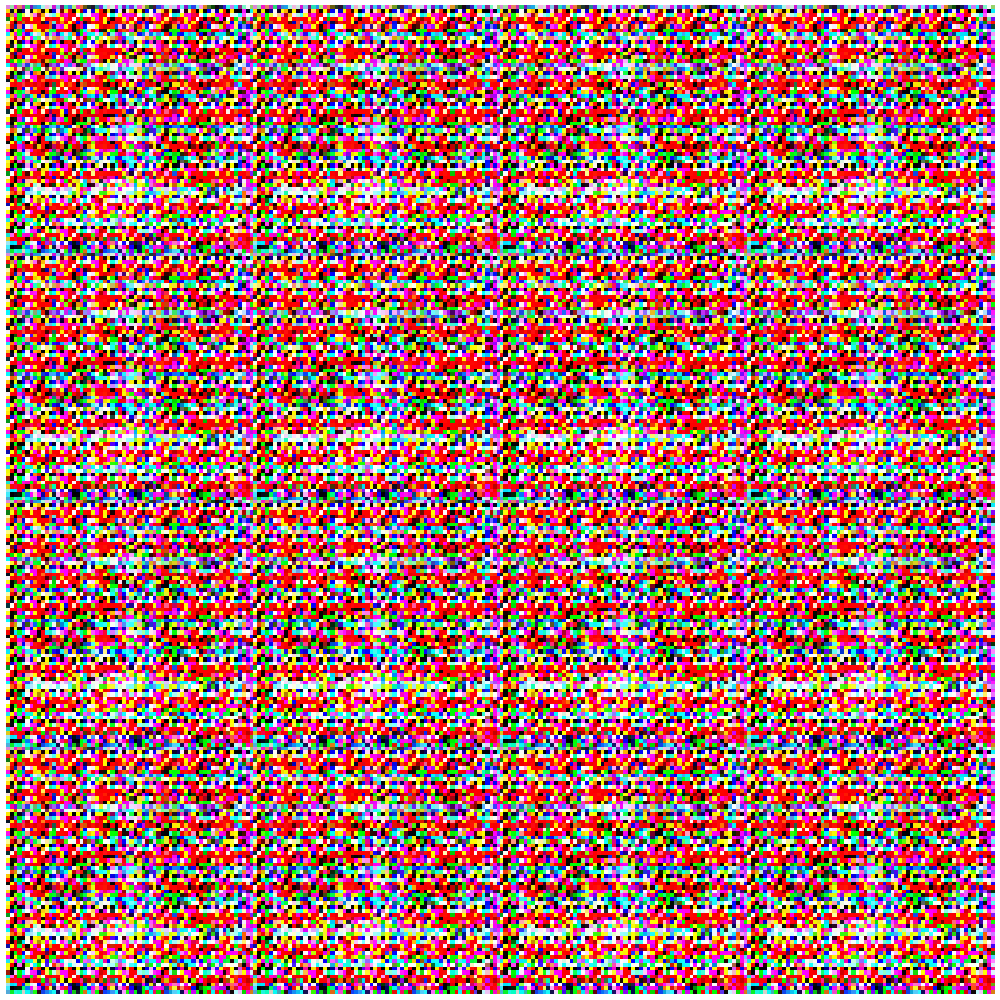

Disc: real loss: 1.279901 fake loss: 1.099449
GAN loss: 0.441905
Step 2300 completed. Time took: 1 secs.
Begin step:  2301
Disc: real loss: 1.280533 fake loss: 1.102625
GAN loss: 0.445041
Step 2301 completed. Time took: 0 secs.
Begin step:  2302
Disc: real loss: 1.263109 fake loss: 1.094961
GAN loss: 0.454056
Step 2302 completed. Time took: 0 secs.
Begin step:  2303
Disc: real loss: 1.270991 fake loss: 1.094235
GAN loss: 0.447019
Step 2303 completed. Time took: 0 secs.
Begin step:  2304
Disc: real loss: 1.280002 fake loss: 1.094191
GAN loss: 0.444840
Step 2304 completed. Time took: 0 secs.
Begin step:  2305
Disc: real loss: 1.235969 fake loss: 1.095108
GAN loss: 0.459273
Step 2305 completed. Time took: 0 secs.
Begin step:  2306
Disc: real loss: 1.268207 fake loss: 1.101694
GAN loss: 0.447282
Step 2306 completed. Time took: 0 secs.
Begin step:  2307
Disc: real loss: 1.290432 fake loss: 1.101847
GAN loss: 0.439063
Step 2307 completed. Time took: 0 secs.
Begin step:  2308
Disc: real loss:

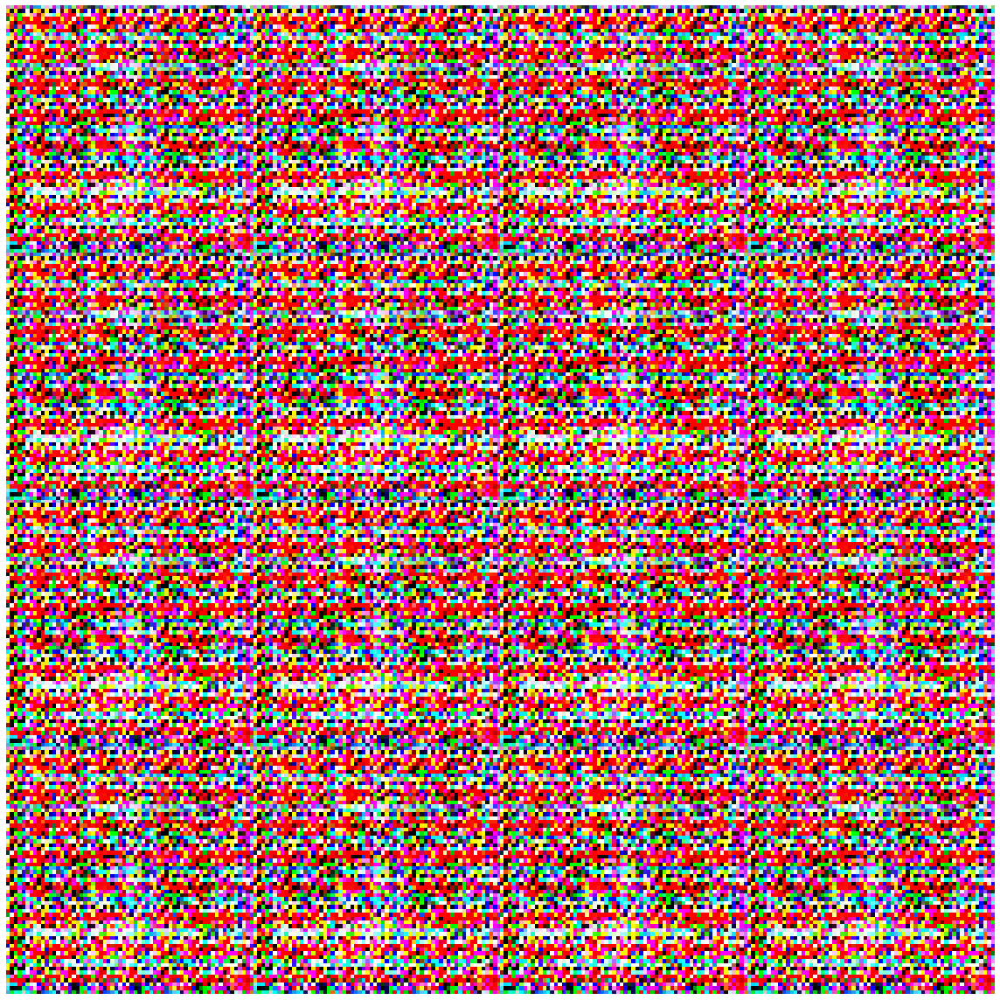

Disc: real loss: 1.297971 fake loss: 1.097728
GAN loss: 0.458933
Step 2400 completed. Time took: 1 secs.
Begin step:  2401
Disc: real loss: 1.275907 fake loss: 1.094537
GAN loss: 0.444208
Step 2401 completed. Time took: 0 secs.
Begin step:  2402
Disc: real loss: 1.291114 fake loss: 1.095641
GAN loss: 0.443794
Step 2402 completed. Time took: 0 secs.
Begin step:  2403
Disc: real loss: 1.285536 fake loss: 1.101247
GAN loss: 0.444395
Step 2403 completed. Time took: 0 secs.
Begin step:  2404
Disc: real loss: 1.261434 fake loss: 1.088631
GAN loss: 0.447231
Step 2404 completed. Time took: 0 secs.
Begin step:  2405
Disc: real loss: 1.312093 fake loss: 1.096547
GAN loss: 0.438927
Step 2405 completed. Time took: 0 secs.
Begin step:  2406
Disc: real loss: 1.261816 fake loss: 1.102048
GAN loss: 0.450457
Step 2406 completed. Time took: 0 secs.
Begin step:  2407
Disc: real loss: 1.280779 fake loss: 1.103489
GAN loss: 0.447810
Step 2407 completed. Time took: 0 secs.
Begin step:  2408
Disc: real loss:

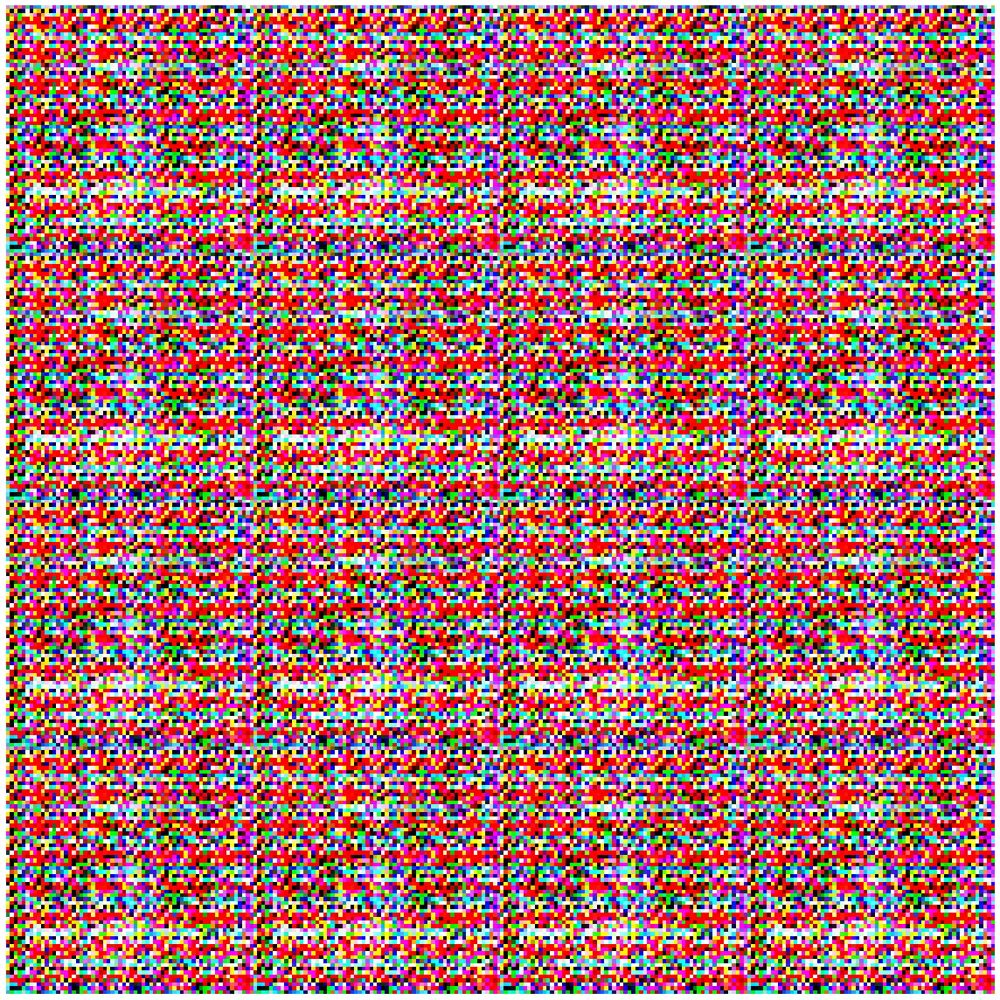

Begin step:  2500


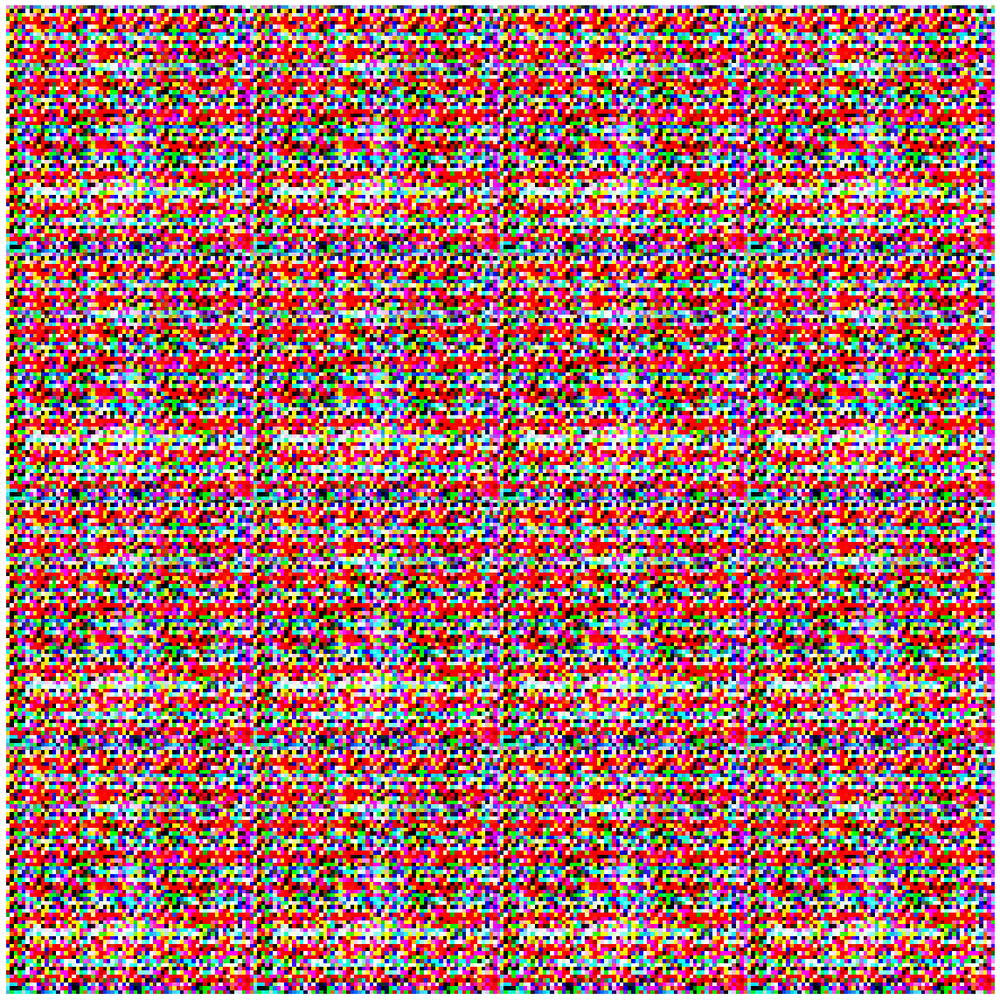

Disc: real loss: 1.289947 fake loss: 1.100383
GAN loss: 0.441992
Step 2500 completed. Time took: 1 secs.
Begin step:  2501
Disc: real loss: 1.261919 fake loss: 1.093597
GAN loss: 0.446440
Step 2501 completed. Time took: 0 secs.
Begin step:  2502
Disc: real loss: 1.267208 fake loss: 1.090026
GAN loss: 0.450776
Step 2502 completed. Time took: 0 secs.
Begin step:  2503
Disc: real loss: 1.288801 fake loss: 1.097072
GAN loss: 0.439990
Step 2503 completed. Time took: 0 secs.
Begin step:  2504
Disc: real loss: 1.279148 fake loss: 1.097370
GAN loss: 0.444201
Step 2504 completed. Time took: 0 secs.
Begin step:  2505
Disc: real loss: 1.279241 fake loss: 1.083661
GAN loss: 0.454589
Step 2505 completed. Time took: 0 secs.
Begin step:  2506
Disc: real loss: 1.252473 fake loss: 1.091497
GAN loss: 0.449561
Step 2506 completed. Time took: 0 secs.
Begin step:  2507
Disc: real loss: 1.294996 fake loss: 1.098520
GAN loss: 0.458111
Step 2507 completed. Time took: 0 secs.
Begin step:  2508
Disc: real loss:

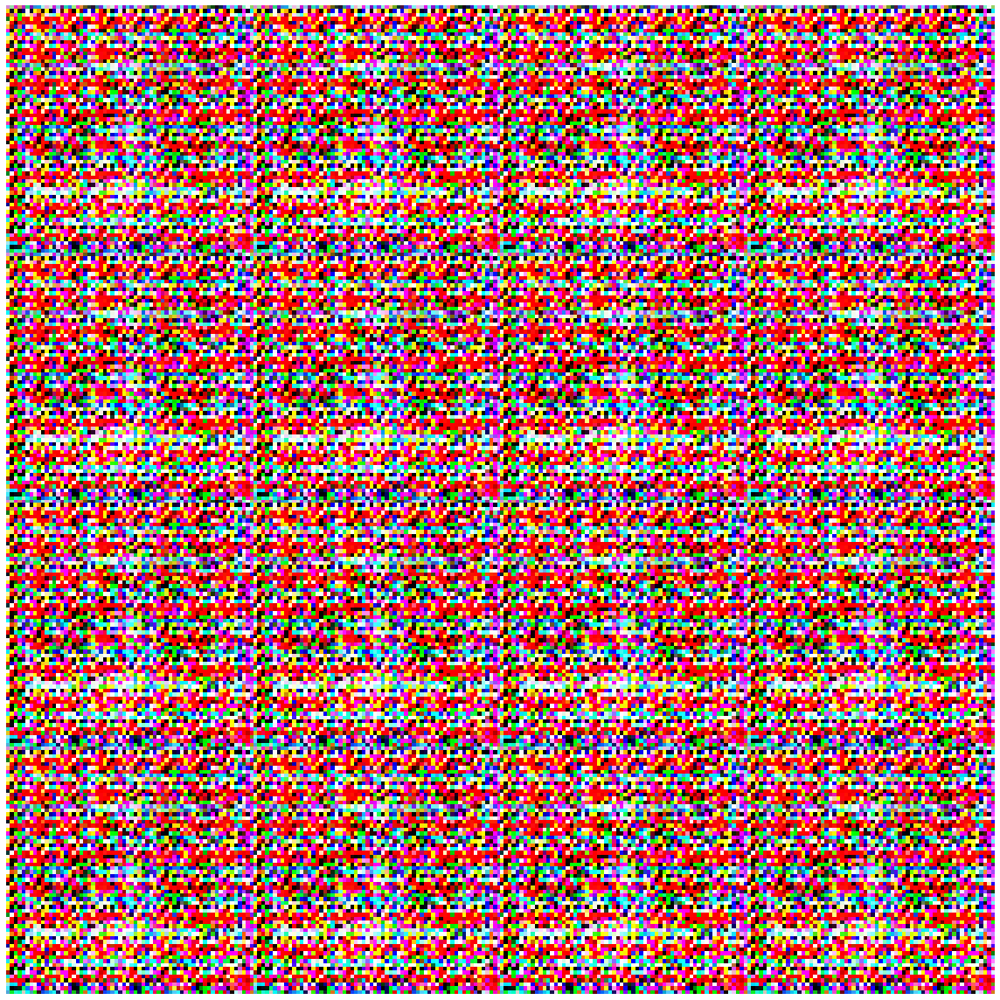

Disc: real loss: 1.282584 fake loss: 1.104281
GAN loss: 0.447612
Step 2600 completed. Time took: 1 secs.
Begin step:  2601
Disc: real loss: 1.283319 fake loss: 1.092392
GAN loss: 0.443134
Step 2601 completed. Time took: 0 secs.
Begin step:  2602
Disc: real loss: 1.278547 fake loss: 1.097018
GAN loss: 0.452795
Step 2602 completed. Time took: 0 secs.
Begin step:  2603
Disc: real loss: 1.296338 fake loss: 1.097855
GAN loss: 0.451099
Step 2603 completed. Time took: 0 secs.
Begin step:  2604
Disc: real loss: 1.295716 fake loss: 1.099690
GAN loss: 0.451156
Step 2604 completed. Time took: 0 secs.
Begin step:  2605
Disc: real loss: 1.280287 fake loss: 1.099790
GAN loss: 0.448155
Step 2605 completed. Time took: 0 secs.
Begin step:  2606
Disc: real loss: 1.264145 fake loss: 1.109598
GAN loss: 0.458295
Step 2606 completed. Time took: 0 secs.
Begin step:  2607
Disc: real loss: 1.246570 fake loss: 1.094717
GAN loss: 0.444700
Step 2607 completed. Time took: 0 secs.
Begin step:  2608
Disc: real loss:

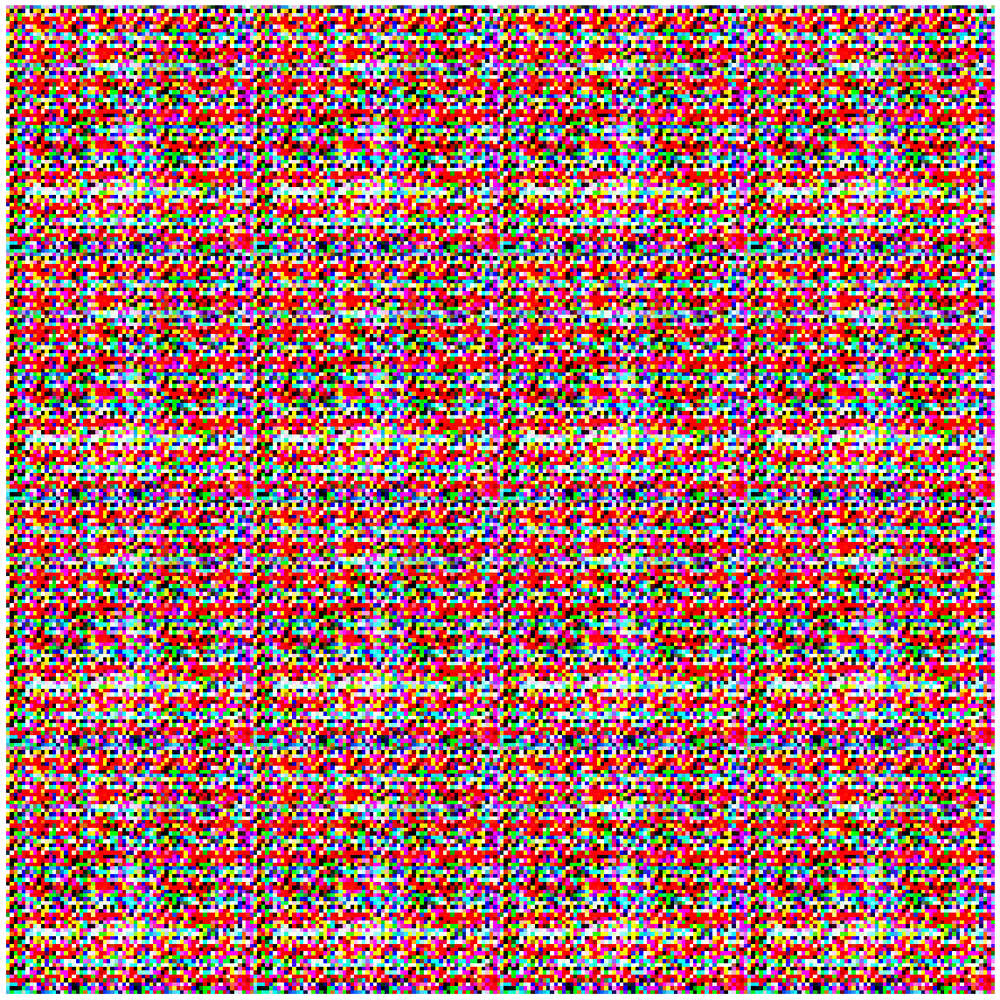

Disc: real loss: 1.271964 fake loss: 1.098878
GAN loss: 0.444098
Step 2700 completed. Time took: 1 secs.
Begin step:  2701
Disc: real loss: 1.272166 fake loss: 1.091406
GAN loss: 0.455744
Step 2701 completed. Time took: 0 secs.
Begin step:  2702
Disc: real loss: 1.262999 fake loss: 1.090247
GAN loss: 0.450221
Step 2702 completed. Time took: 0 secs.
Begin step:  2703
Disc: real loss: 1.270623 fake loss: 1.090501
GAN loss: 0.449151
Step 2703 completed. Time took: 0 secs.
Begin step:  2704
Disc: real loss: 1.273906 fake loss: 1.093873
GAN loss: 0.450580
Step 2704 completed. Time took: 0 secs.
Begin step:  2705
Disc: real loss: 1.263385 fake loss: 1.094375
GAN loss: 0.452129
Step 2705 completed. Time took: 0 secs.
Begin step:  2706
Disc: real loss: 1.266047 fake loss: 1.088700
GAN loss: 0.442600
Step 2706 completed. Time took: 0 secs.
Begin step:  2707
Disc: real loss: 1.269679 fake loss: 1.104139
GAN loss: 0.451476
Step 2707 completed. Time took: 0 secs.
Begin step:  2708
Disc: real loss:

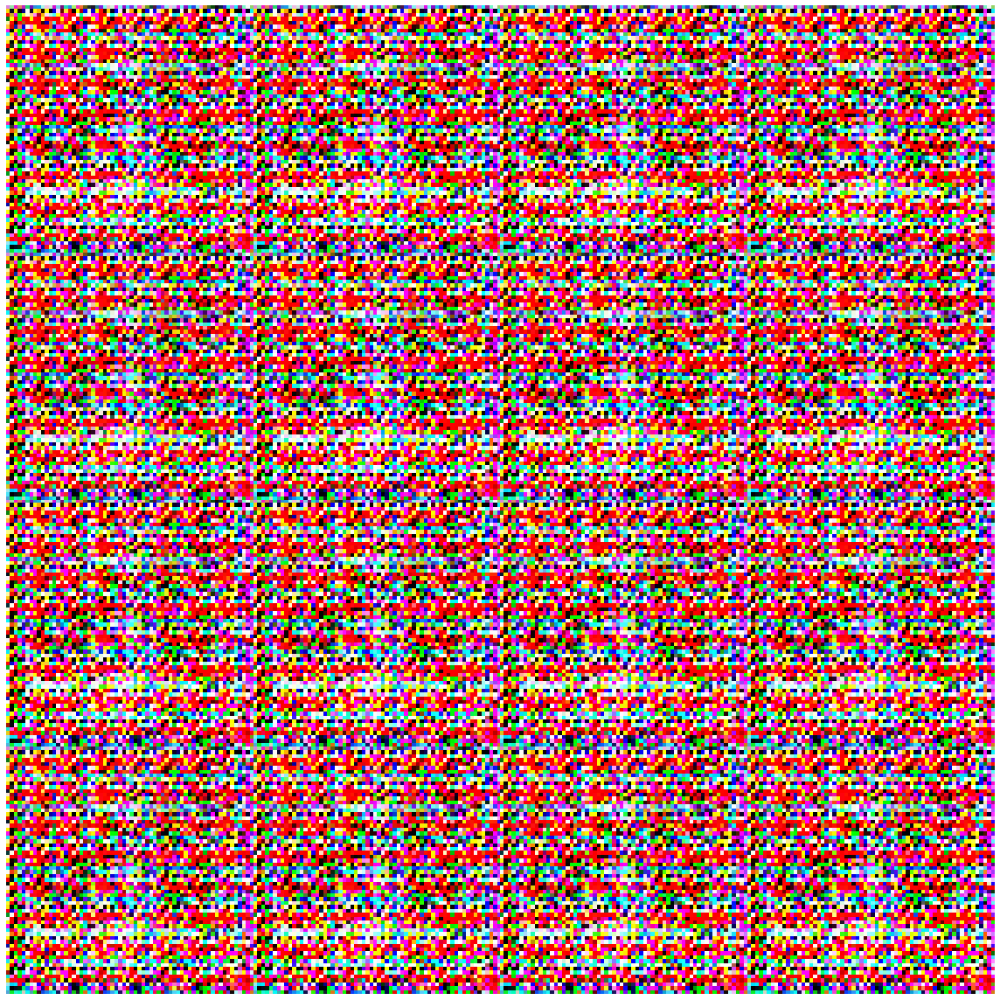

Disc: real loss: 1.267256 fake loss: 1.097420
GAN loss: 0.457954
Step 2800 completed. Time took: 1 secs.
Begin step:  2801
Disc: real loss: 1.264682 fake loss: 1.097234
GAN loss: 0.447402
Step 2801 completed. Time took: 0 secs.
Begin step:  2802
Disc: real loss: 1.292722 fake loss: 1.096361
GAN loss: 0.445745
Step 2802 completed. Time took: 0 secs.
Begin step:  2803
Disc: real loss: 1.254760 fake loss: 1.099254
GAN loss: 0.456582
Step 2803 completed. Time took: 0 secs.
Begin step:  2804
Disc: real loss: 1.267114 fake loss: 1.089970
GAN loss: 0.445185
Step 2804 completed. Time took: 0 secs.
Begin step:  2805
Disc: real loss: 1.262743 fake loss: 1.098766
GAN loss: 0.457331
Step 2805 completed. Time took: 0 secs.
Begin step:  2806
Disc: real loss: 1.266810 fake loss: 1.098284
GAN loss: 0.462312
Step 2806 completed. Time took: 0 secs.
Begin step:  2807
Disc: real loss: 1.282903 fake loss: 1.093096
GAN loss: 0.446001
Step 2807 completed. Time took: 0 secs.
Begin step:  2808
Disc: real loss:

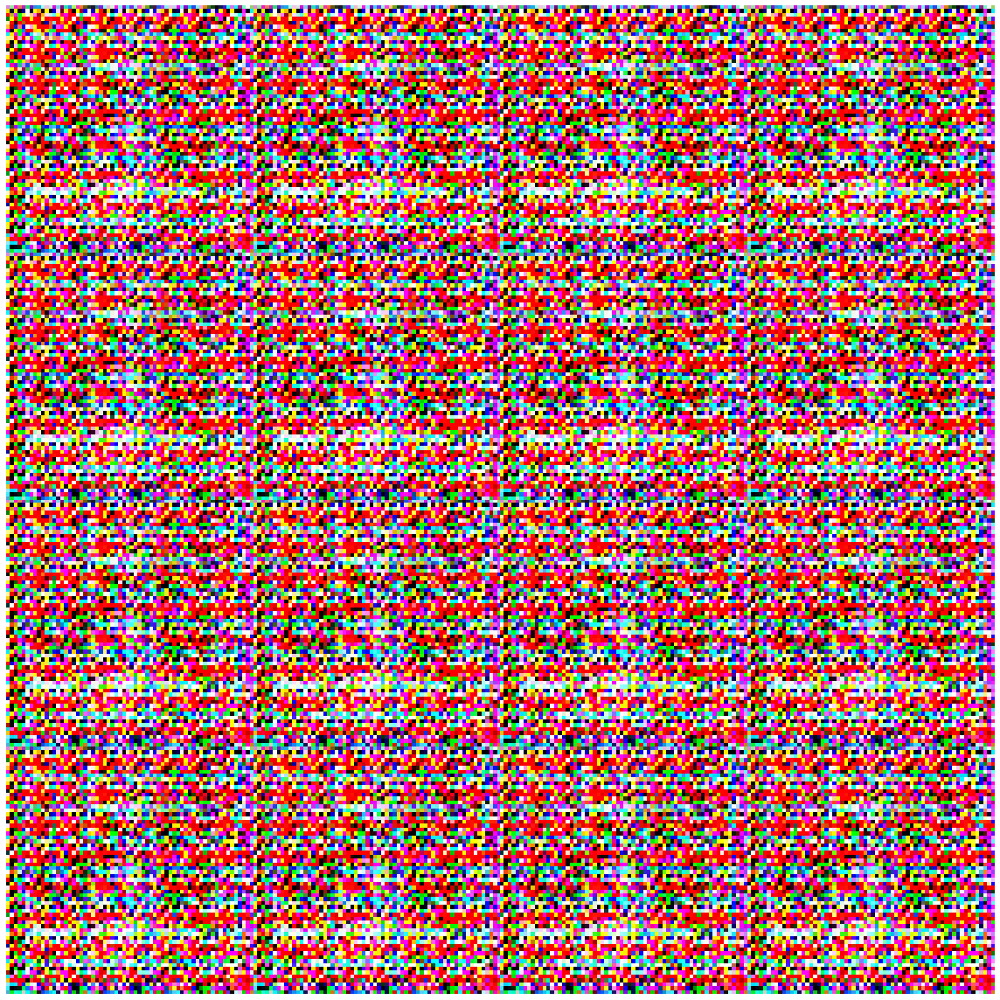

Disc: real loss: 1.301108 fake loss: 1.100394
GAN loss: 0.443774
Step 2900 completed. Time took: 1 secs.
Begin step:  2901
Disc: real loss: 1.279544 fake loss: 1.097924
GAN loss: 0.443801
Step 2901 completed. Time took: 0 secs.
Begin step:  2902
Disc: real loss: 1.267308 fake loss: 1.087962
GAN loss: 0.445184
Step 2902 completed. Time took: 0 secs.
Begin step:  2903
Disc: real loss: 1.294248 fake loss: 1.101691
GAN loss: 0.441375
Step 2903 completed. Time took: 0 secs.
Begin step:  2904
Disc: real loss: 1.248583 fake loss: 1.100199
GAN loss: 0.459495
Step 2904 completed. Time took: 0 secs.
Begin step:  2905
Disc: real loss: 1.268178 fake loss: 1.102021
GAN loss: 0.452225
Step 2905 completed. Time took: 0 secs.
Begin step:  2906
Disc: real loss: 1.290068 fake loss: 1.098237
GAN loss: 0.435004
Step 2906 completed. Time took: 0 secs.
Begin step:  2907
Disc: real loss: 1.275774 fake loss: 1.097630
GAN loss: 0.450042
Step 2907 completed. Time took: 0 secs.
Begin step:  2908
Disc: real loss:

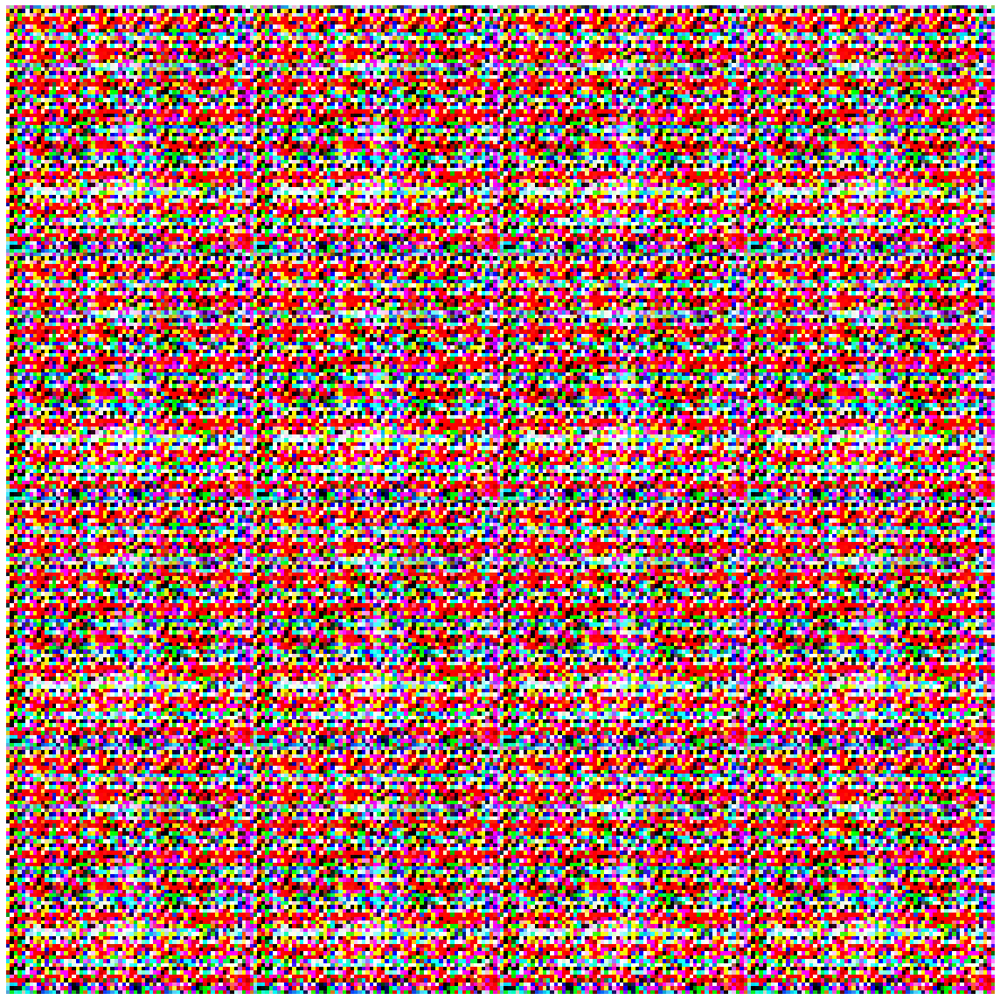

Begin step:  3000


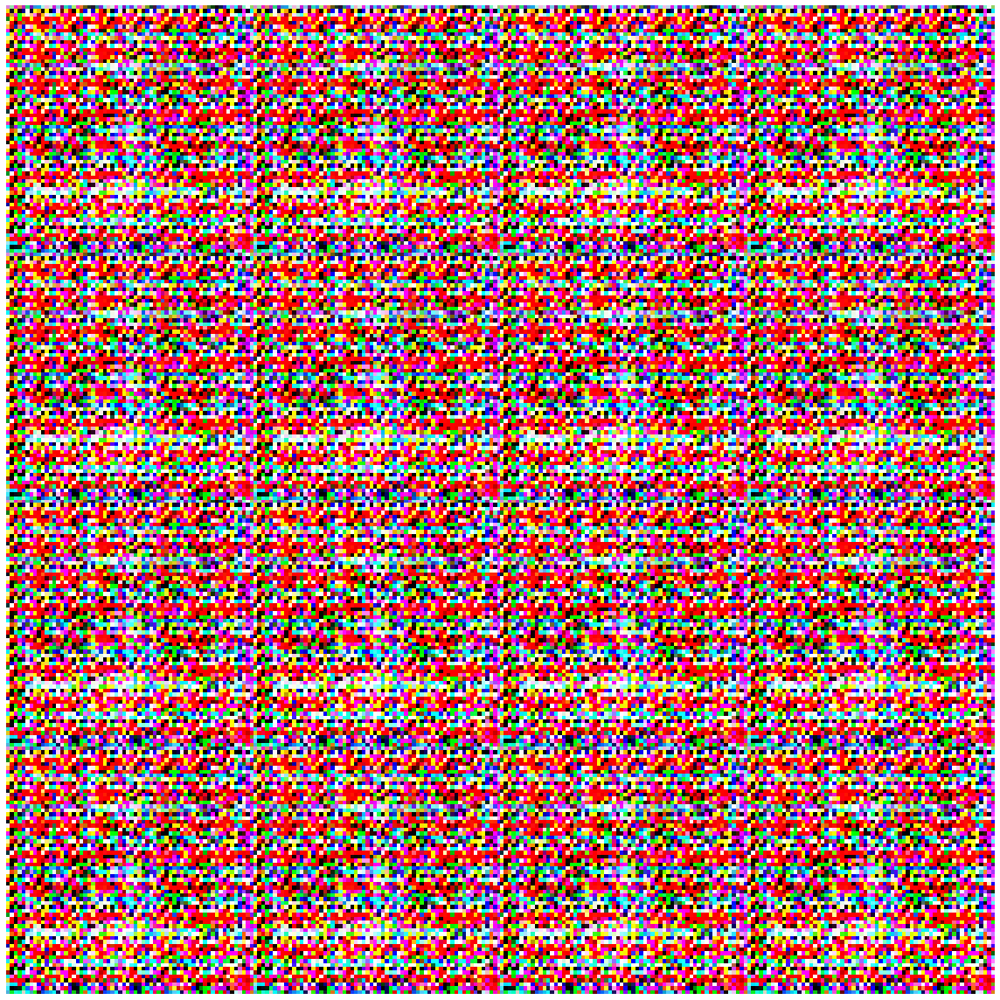

Disc: real loss: 1.245350 fake loss: 1.090255
GAN loss: 0.455758
Step 3000 completed. Time took: 1 secs.
Begin step:  3001
Disc: real loss: 1.273013 fake loss: 1.098179
GAN loss: 0.452964
Step 3001 completed. Time took: 0 secs.
Begin step:  3002
Disc: real loss: 1.263882 fake loss: 1.097224
GAN loss: 0.452913
Step 3002 completed. Time took: 0 secs.
Begin step:  3003
Disc: real loss: 1.300335 fake loss: 1.095433
GAN loss: 0.450236
Step 3003 completed. Time took: 0 secs.
Begin step:  3004
Disc: real loss: 1.272739 fake loss: 1.106201
GAN loss: 0.457793
Step 3004 completed. Time took: 0 secs.
Begin step:  3005
Disc: real loss: 1.284024 fake loss: 1.104286
GAN loss: 0.445307
Step 3005 completed. Time took: 0 secs.
Begin step:  3006
Disc: real loss: 1.270984 fake loss: 1.099501
GAN loss: 0.448960
Step 3006 completed. Time took: 0 secs.
Begin step:  3007
Disc: real loss: 1.294220 fake loss: 1.092870
GAN loss: 0.444595
Step 3007 completed. Time took: 0 secs.
Begin step:  3008
Disc: real loss:

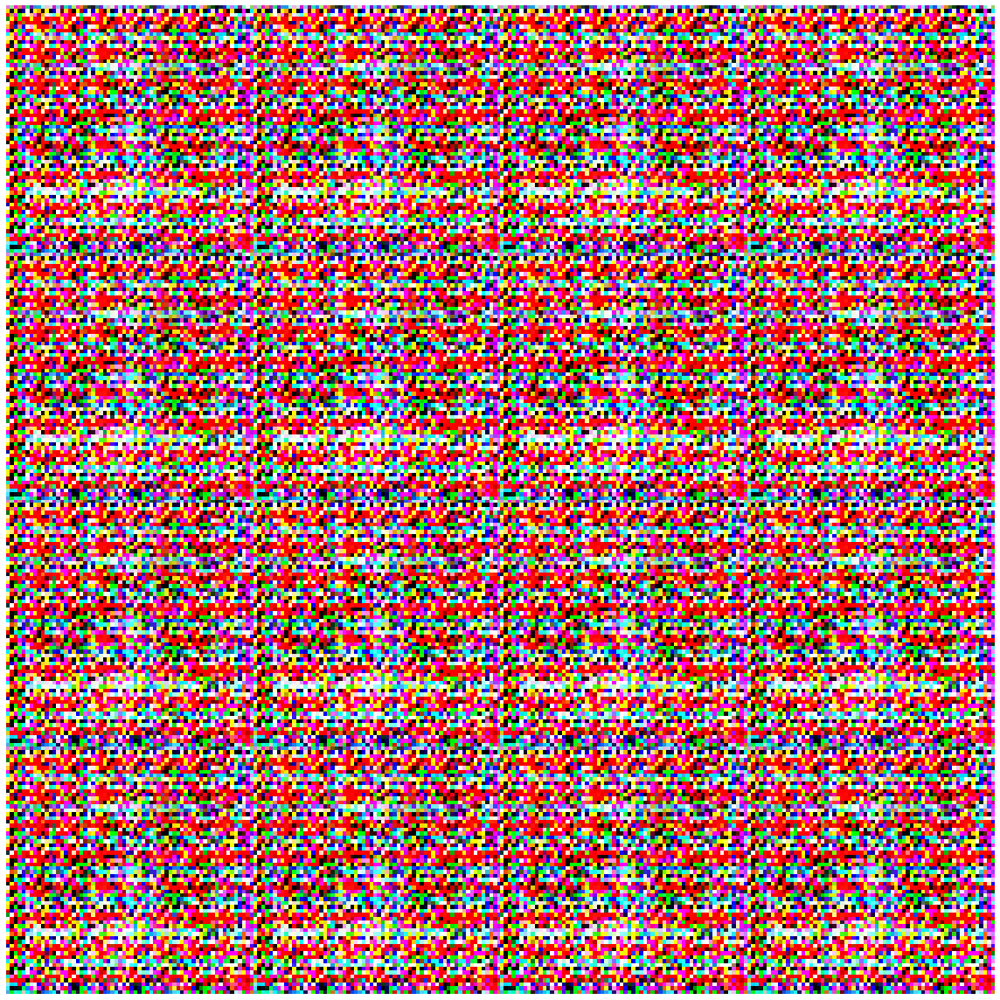

Disc: real loss: 1.284349 fake loss: 1.105442
GAN loss: 0.453262
Step 3100 completed. Time took: 1 secs.
Begin step:  3101
Disc: real loss: 1.306031 fake loss: 1.103798
GAN loss: 0.442515
Step 3101 completed. Time took: 0 secs.
Begin step:  3102
Disc: real loss: 1.263213 fake loss: 1.108886
GAN loss: 0.449992
Step 3102 completed. Time took: 0 secs.
Begin step:  3103
Disc: real loss: 1.285864 fake loss: 1.088200
GAN loss: 0.446964
Step 3103 completed. Time took: 0 secs.
Begin step:  3104
Disc: real loss: 1.312836 fake loss: 1.101886
GAN loss: 0.436267
Step 3104 completed. Time took: 0 secs.
Begin step:  3105
Disc: real loss: 1.267538 fake loss: 1.091550
GAN loss: 0.442282
Step 3105 completed. Time took: 0 secs.
Begin step:  3106
Disc: real loss: 1.256969 fake loss: 1.089060
GAN loss: 0.445058
Step 3106 completed. Time took: 0 secs.
Begin step:  3107
Disc: real loss: 1.294805 fake loss: 1.098194
GAN loss: 0.446460
Step 3107 completed. Time took: 0 secs.
Begin step:  3108
Disc: real loss:

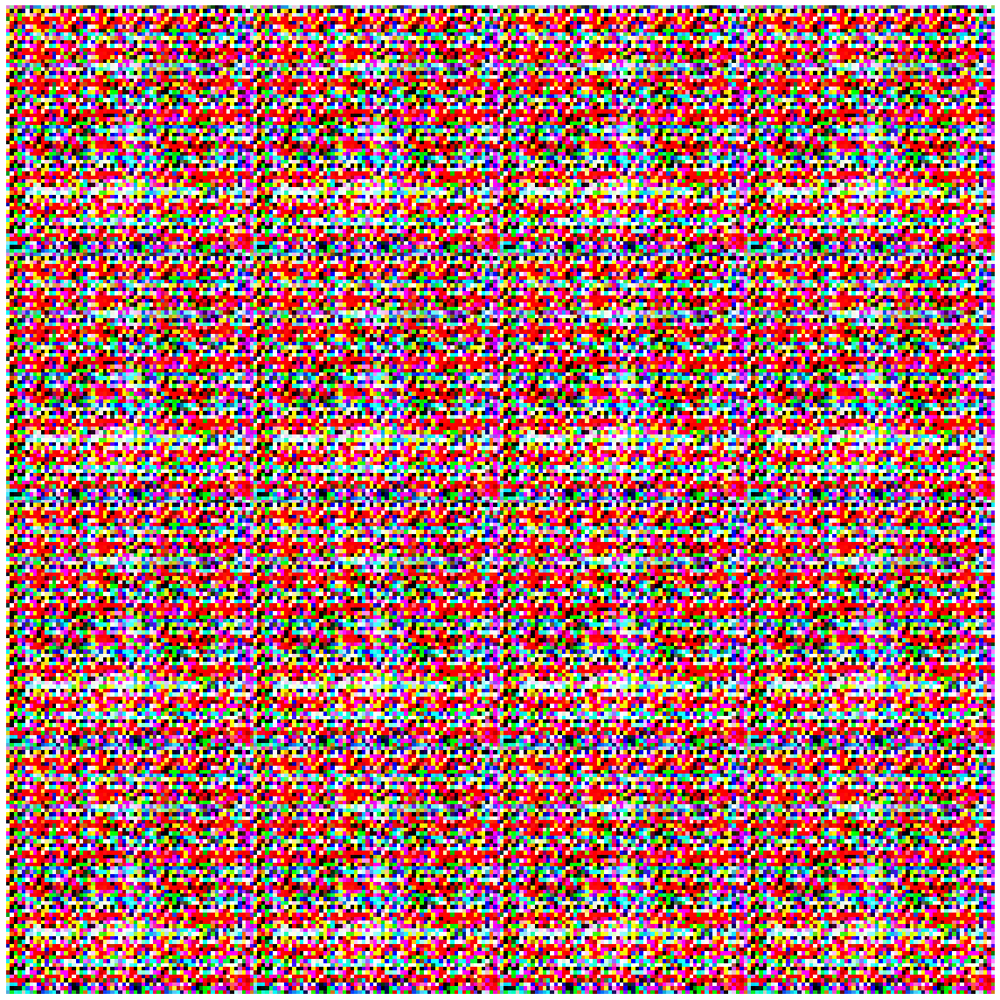

Disc: real loss: 1.273365 fake loss: 1.092197
GAN loss: 0.447883
Step 3200 completed. Time took: 1 secs.
Begin step:  3201
Disc: real loss: 1.276102 fake loss: 1.096273
GAN loss: 0.455926
Step 3201 completed. Time took: 0 secs.
Begin step:  3202
Disc: real loss: 1.245640 fake loss: 1.095964
GAN loss: 0.452149
Step 3202 completed. Time took: 0 secs.
Begin step:  3203
Disc: real loss: 1.290019 fake loss: 1.096514
GAN loss: 0.444323
Step 3203 completed. Time took: 0 secs.
Begin step:  3204
Disc: real loss: 1.281899 fake loss: 1.091616
GAN loss: 0.453824
Step 3204 completed. Time took: 0 secs.
Begin step:  3205
Disc: real loss: 1.270545 fake loss: 1.089846
GAN loss: 0.448245
Step 3205 completed. Time took: 0 secs.
Begin step:  3206
Disc: real loss: 1.273238 fake loss: 1.090102
GAN loss: 0.441951
Step 3206 completed. Time took: 0 secs.
Begin step:  3207
Disc: real loss: 1.268544 fake loss: 1.108043
GAN loss: 0.457139
Step 3207 completed. Time took: 0 secs.
Begin step:  3208
Disc: real loss:

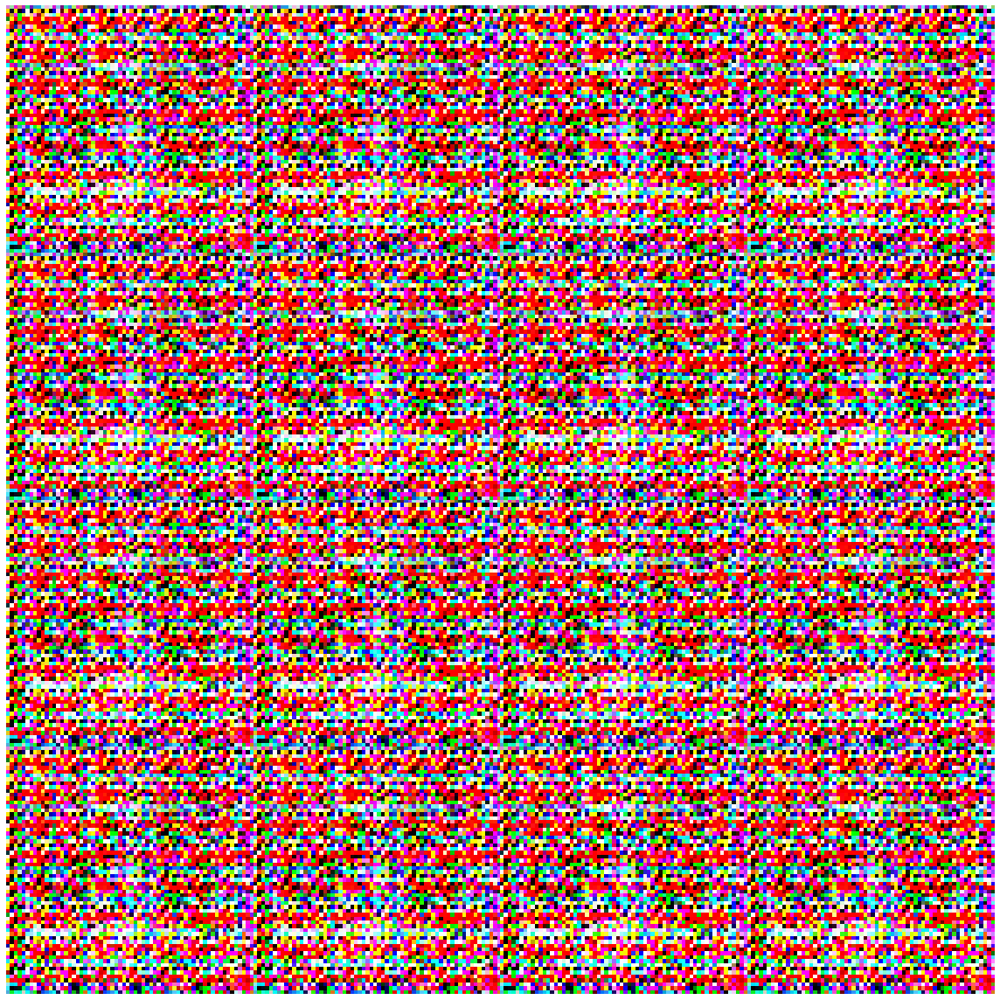

Disc: real loss: 1.283610 fake loss: 1.094127
GAN loss: 0.459244
Step 3300 completed. Time took: 1 secs.
Begin step:  3301
Disc: real loss: 1.269312 fake loss: 1.088661
GAN loss: 0.450465
Step 3301 completed. Time took: 0 secs.
Begin step:  3302
Disc: real loss: 1.282427 fake loss: 1.095839
GAN loss: 0.448848
Step 3302 completed. Time took: 0 secs.
Begin step:  3303
Disc: real loss: 1.267806 fake loss: 1.104304
GAN loss: 0.455860
Step 3303 completed. Time took: 0 secs.
Begin step:  3304
Disc: real loss: 1.278204 fake loss: 1.098799
GAN loss: 0.436351
Step 3304 completed. Time took: 0 secs.
Begin step:  3305
Disc: real loss: 1.281822 fake loss: 1.094056
GAN loss: 0.447760
Step 3305 completed. Time took: 0 secs.
Begin step:  3306
Disc: real loss: 1.290107 fake loss: 1.087907
GAN loss: 0.447124
Step 3306 completed. Time took: 0 secs.
Begin step:  3307
Disc: real loss: 1.264427 fake loss: 1.100108
GAN loss: 0.455297
Step 3307 completed. Time took: 0 secs.
Begin step:  3308
Disc: real loss:

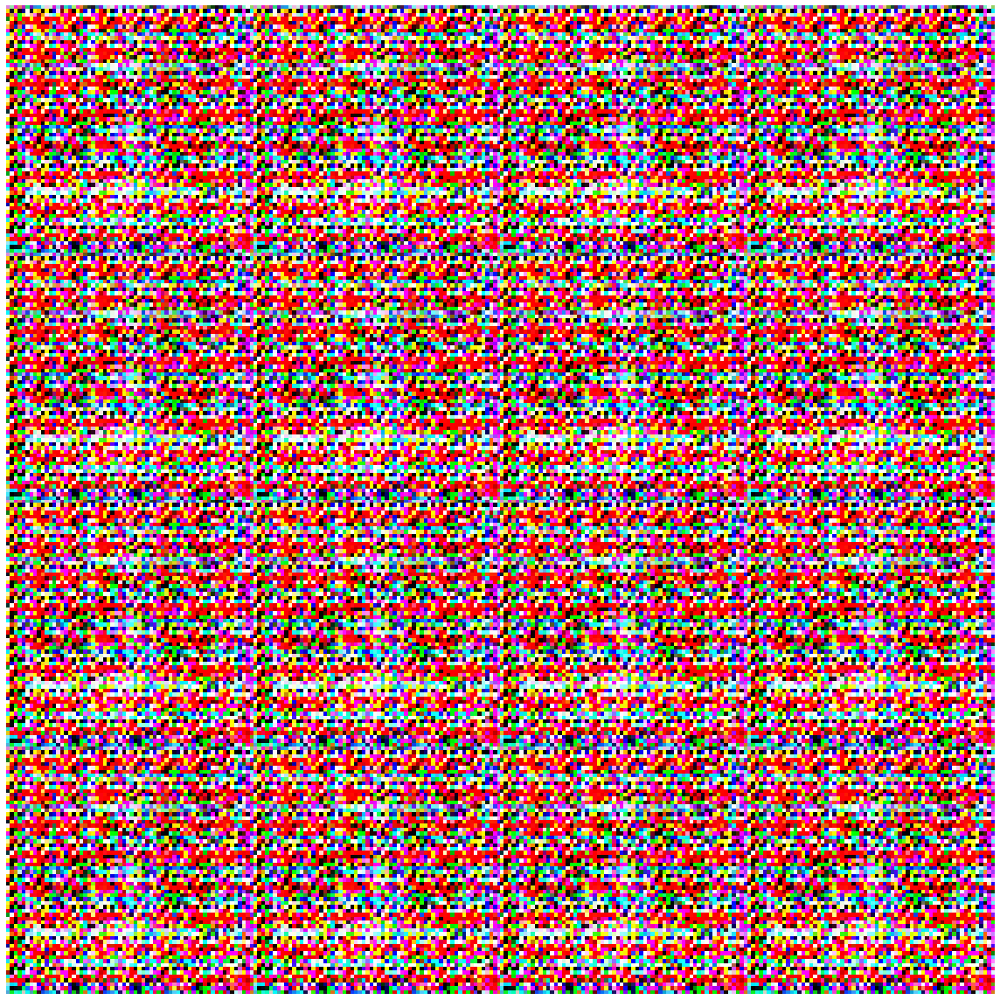

Disc: real loss: 1.269744 fake loss: 1.091906
GAN loss: 0.437487
Step 3400 completed. Time took: 1 secs.
Begin step:  3401
Disc: real loss: 1.273191 fake loss: 1.096565
GAN loss: 0.448686
Step 3401 completed. Time took: 0 secs.
Begin step:  3402
Disc: real loss: 1.245616 fake loss: 1.083553
GAN loss: 0.454541
Step 3402 completed. Time took: 0 secs.
Begin step:  3403
Disc: real loss: 1.281496 fake loss: 1.083158
GAN loss: 0.447778
Step 3403 completed. Time took: 0 secs.
Begin step:  3404
Disc: real loss: 1.258873 fake loss: 1.101554
GAN loss: 0.454616
Step 3404 completed. Time took: 0 secs.
Begin step:  3405
Disc: real loss: 1.290568 fake loss: 1.100525
GAN loss: 0.447622
Step 3405 completed. Time took: 0 secs.
Begin step:  3406
Disc: real loss: 1.287584 fake loss: 1.108250
GAN loss: 0.445706
Step 3406 completed. Time took: 0 secs.
Begin step:  3407
Disc: real loss: 1.253713 fake loss: 1.094514
GAN loss: 0.448857
Step 3407 completed. Time took: 0 secs.
Begin step:  3408
Disc: real loss:

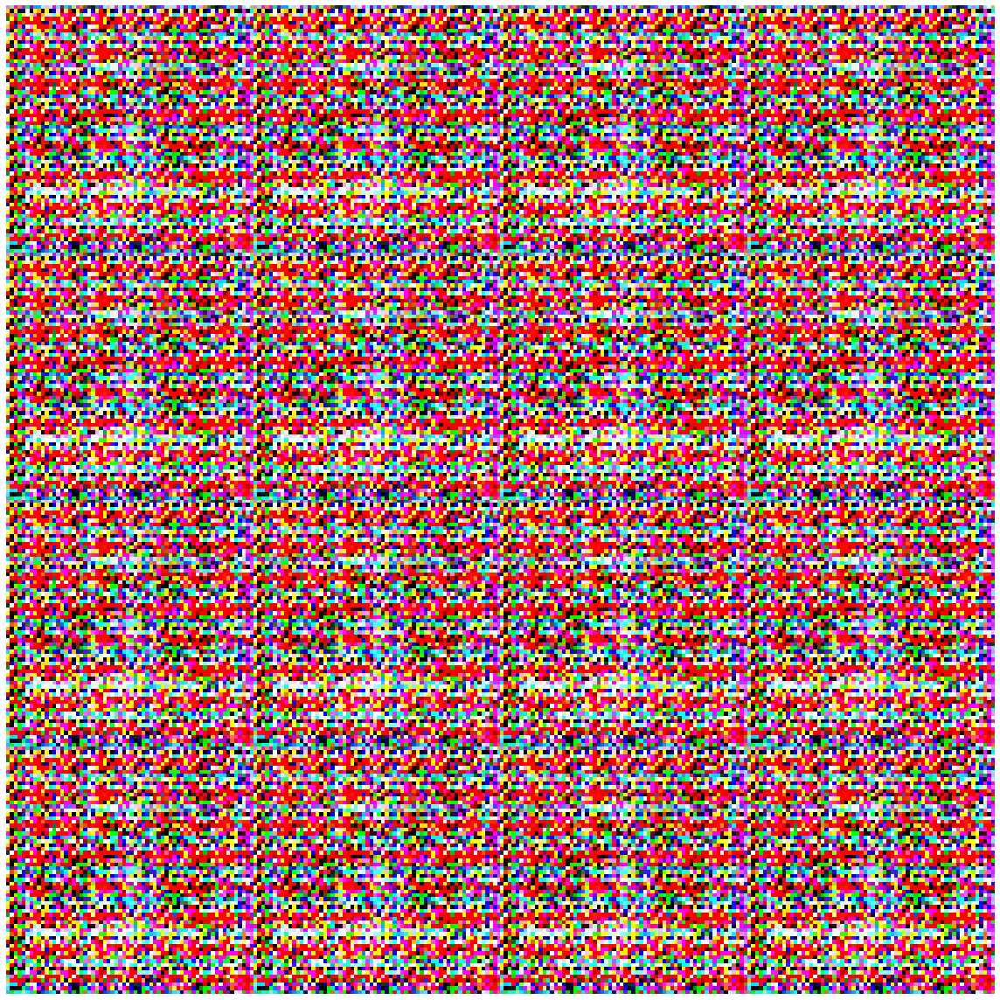

Begin step:  3500


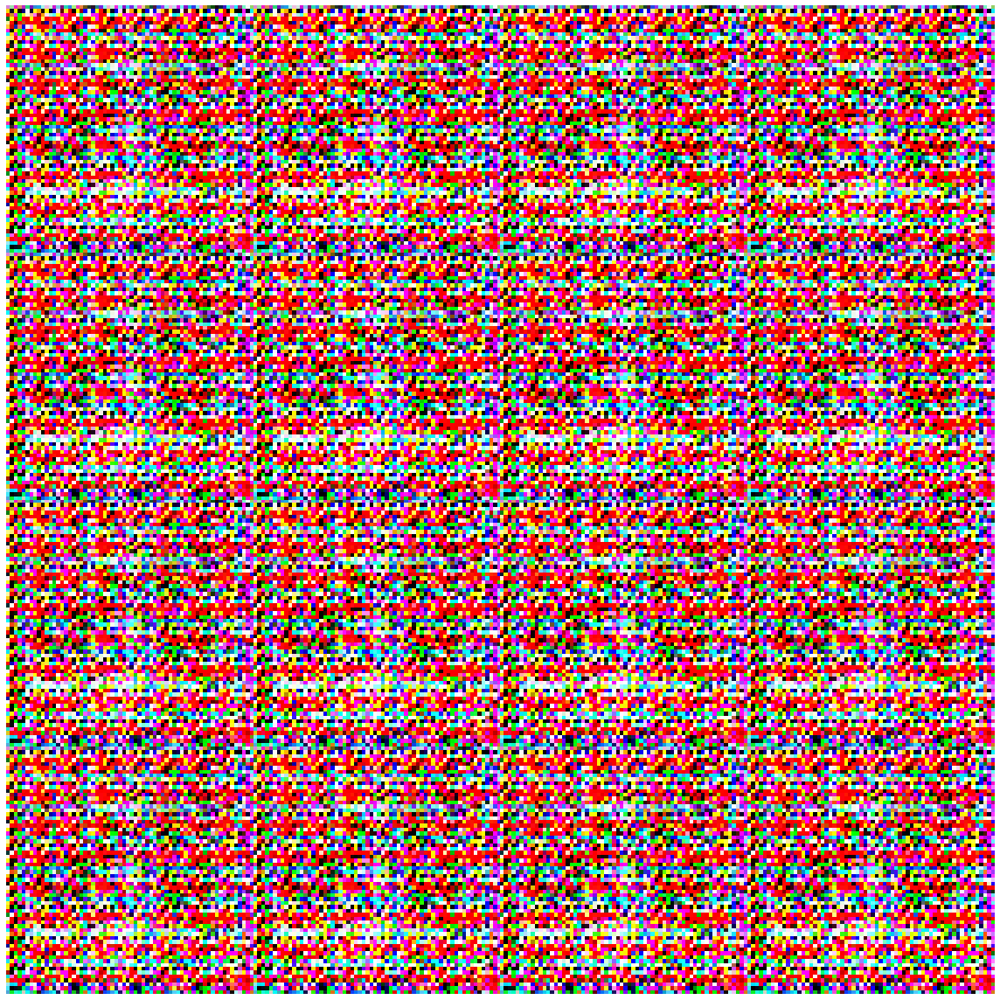

Disc: real loss: 1.306084 fake loss: 1.092790
GAN loss: 0.441964
Step 3500 completed. Time took: 1 secs.
Begin step:  3501
Disc: real loss: 1.293160 fake loss: 1.101782
GAN loss: 0.445531
Step 3501 completed. Time took: 0 secs.
Begin step:  3502
Disc: real loss: 1.262214 fake loss: 1.101872
GAN loss: 0.457113
Step 3502 completed. Time took: 0 secs.
Begin step:  3503
Disc: real loss: 1.289787 fake loss: 1.095251
GAN loss: 0.434822
Step 3503 completed. Time took: 0 secs.
Begin step:  3504
Disc: real loss: 1.294764 fake loss: 1.088717
GAN loss: 0.448414
Step 3504 completed. Time took: 0 secs.
Begin step:  3505
Disc: real loss: 1.293953 fake loss: 1.094432
GAN loss: 0.443938
Step 3505 completed. Time took: 0 secs.
Begin step:  3506
Disc: real loss: 1.300987 fake loss: 1.097434
GAN loss: 0.449899
Step 3506 completed. Time took: 0 secs.
Begin step:  3507
Disc: real loss: 1.256070 fake loss: 1.094826
GAN loss: 0.447031
Step 3507 completed. Time took: 0 secs.
Begin step:  3508
Disc: real loss:

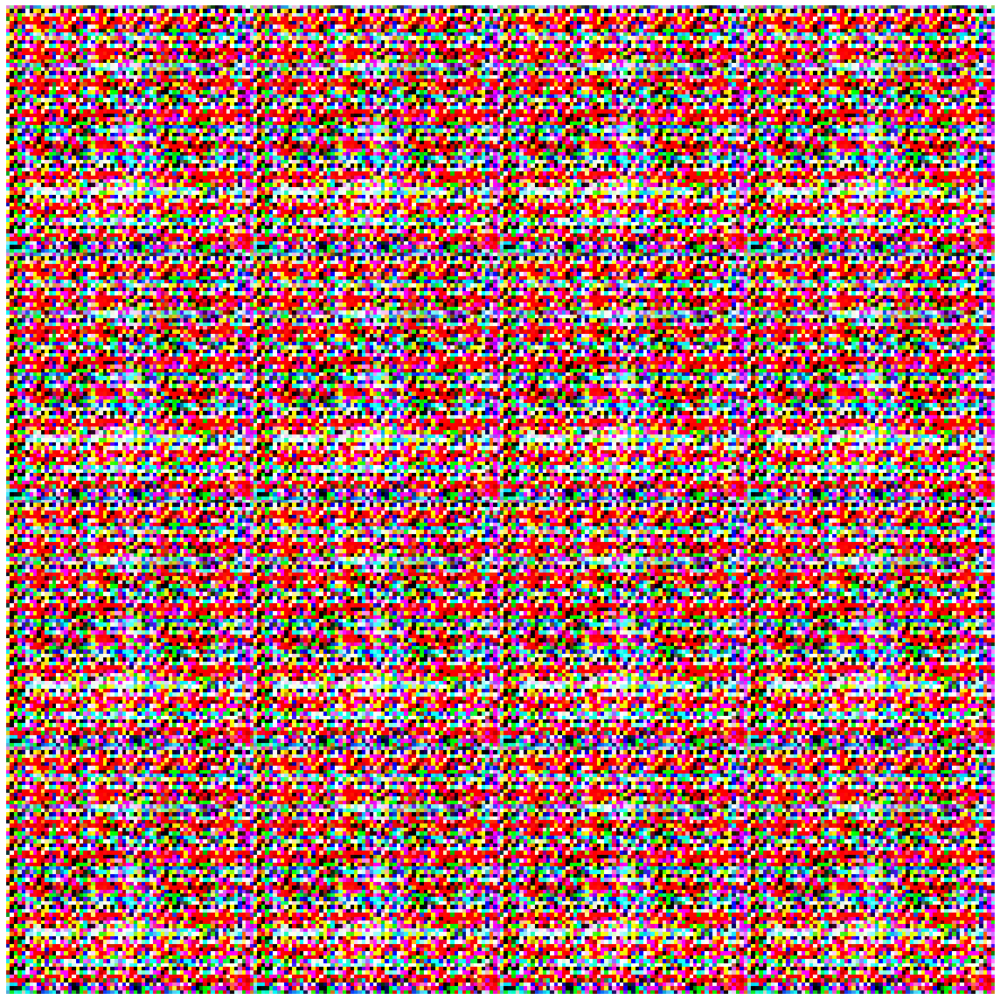

Disc: real loss: 1.303882 fake loss: 1.088903
GAN loss: 0.441356
Step 3600 completed. Time took: 1 secs.
Begin step:  3601
Disc: real loss: 1.259281 fake loss: 1.091879
GAN loss: 0.448940
Step 3601 completed. Time took: 0 secs.
Begin step:  3602
Disc: real loss: 1.276406 fake loss: 1.096477
GAN loss: 0.454396
Step 3602 completed. Time took: 0 secs.
Begin step:  3603
Disc: real loss: 1.288397 fake loss: 1.088819
GAN loss: 0.446941
Step 3603 completed. Time took: 0 secs.
Begin step:  3604
Disc: real loss: 1.293677 fake loss: 1.104851
GAN loss: 0.451816
Step 3604 completed. Time took: 0 secs.
Begin step:  3605
Disc: real loss: 1.279439 fake loss: 1.101094
GAN loss: 0.452380
Step 3605 completed. Time took: 0 secs.
Begin step:  3606
Disc: real loss: 1.272986 fake loss: 1.096683
GAN loss: 0.451982
Step 3606 completed. Time took: 0 secs.
Begin step:  3607
Disc: real loss: 1.300860 fake loss: 1.089886
GAN loss: 0.456245
Step 3607 completed. Time took: 0 secs.
Begin step:  3608
Disc: real loss:

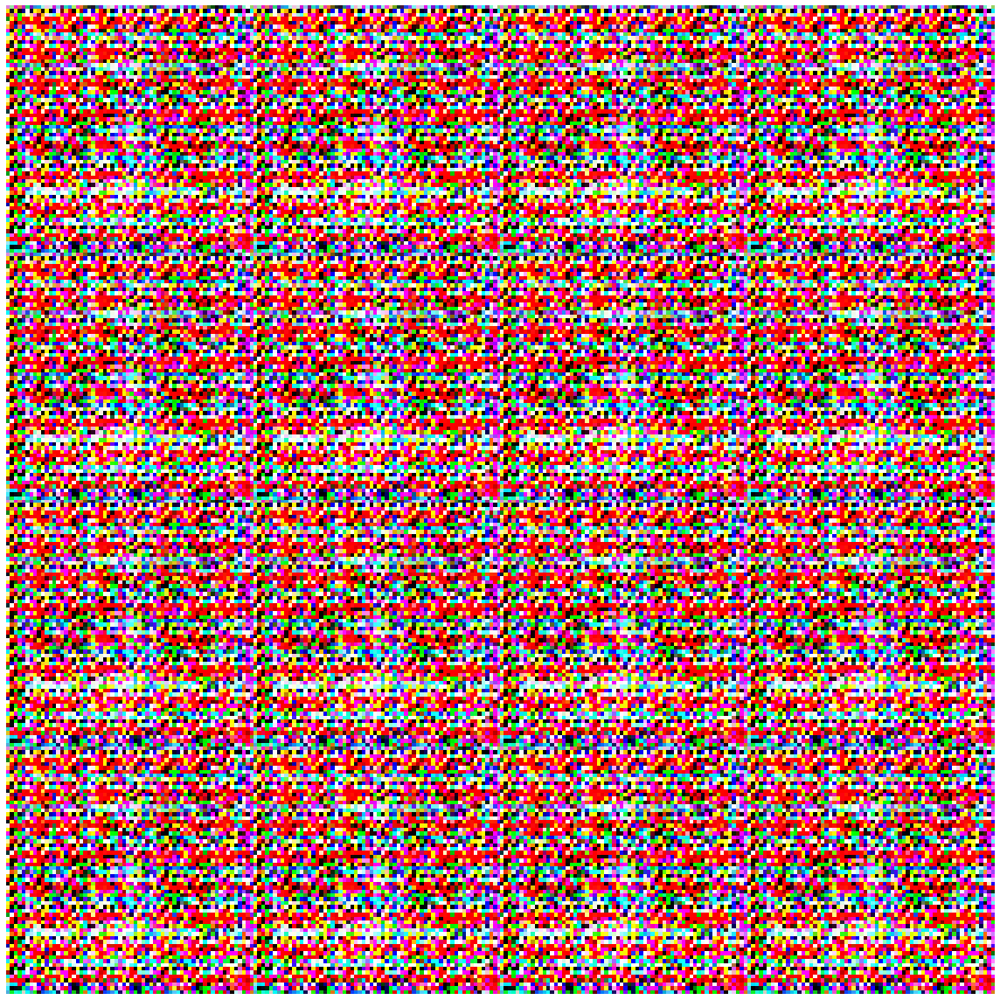

Disc: real loss: 1.278892 fake loss: 1.092853
GAN loss: 0.455809
Step 3700 completed. Time took: 1 secs.
Begin step:  3701
Disc: real loss: 1.284414 fake loss: 1.099965
GAN loss: 0.440840
Step 3701 completed. Time took: 0 secs.
Begin step:  3702
Disc: real loss: 1.261860 fake loss: 1.097878
GAN loss: 0.451302
Step 3702 completed. Time took: 0 secs.
Begin step:  3703
Disc: real loss: 1.270862 fake loss: 1.093389
GAN loss: 0.449984
Step 3703 completed. Time took: 0 secs.
Begin step:  3704
Disc: real loss: 1.279736 fake loss: 1.099944
GAN loss: 0.442086
Step 3704 completed. Time took: 0 secs.
Begin step:  3705
Disc: real loss: 1.276397 fake loss: 1.096059
GAN loss: 0.448531
Step 3705 completed. Time took: 0 secs.
Begin step:  3706
Disc: real loss: 1.291922 fake loss: 1.093276
GAN loss: 0.437029
Step 3706 completed. Time took: 0 secs.
Begin step:  3707
Disc: real loss: 1.318285 fake loss: 1.097202
GAN loss: 0.445873
Step 3707 completed. Time took: 0 secs.
Begin step:  3708
Disc: real loss:

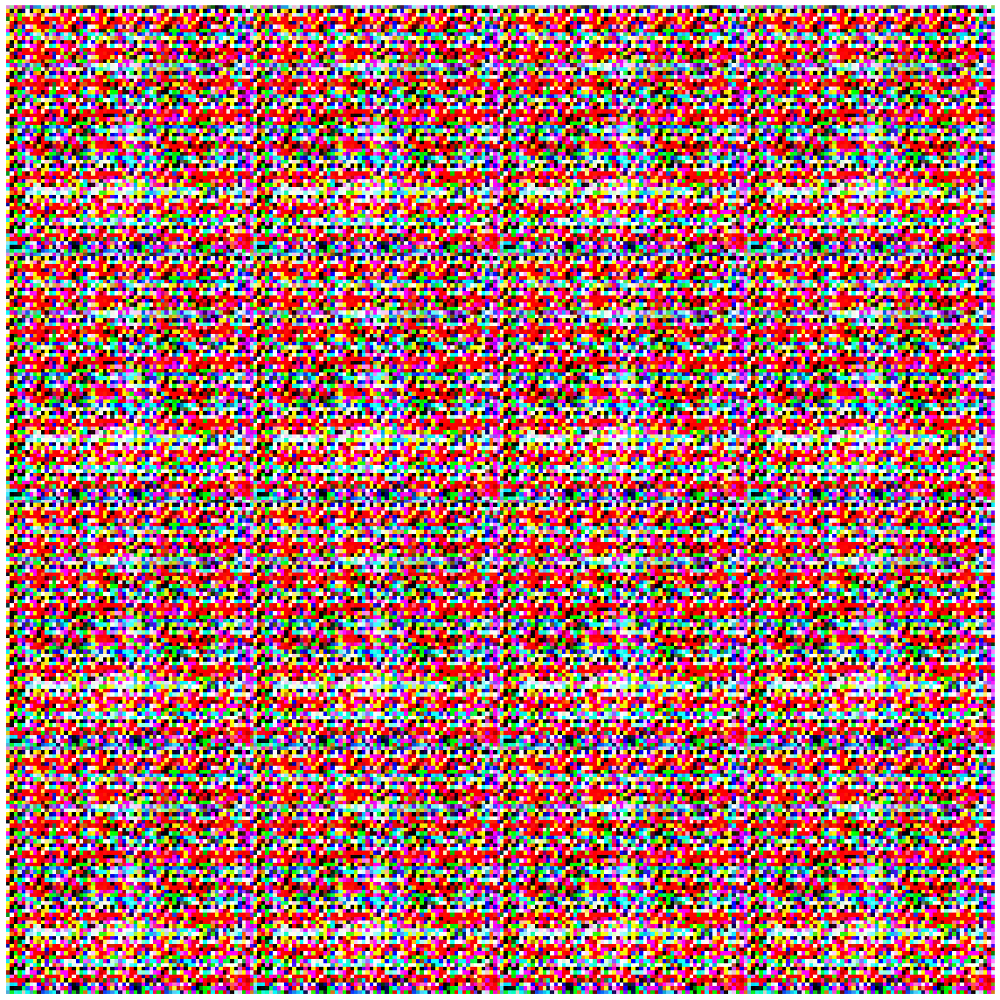

Disc: real loss: 1.254735 fake loss: 1.102132
GAN loss: 0.447185
Step 3800 completed. Time took: 1 secs.
Begin step:  3801
Disc: real loss: 1.278198 fake loss: 1.096642
GAN loss: 0.450919
Step 3801 completed. Time took: 0 secs.
Begin step:  3802
Disc: real loss: 1.305884 fake loss: 1.094268
GAN loss: 0.449432
Step 3802 completed. Time took: 0 secs.
Begin step:  3803
Disc: real loss: 1.264247 fake loss: 1.092197
GAN loss: 0.445236
Step 3803 completed. Time took: 0 secs.
Begin step:  3804
Disc: real loss: 1.261180 fake loss: 1.100145
GAN loss: 0.460698
Step 3804 completed. Time took: 0 secs.
Begin step:  3805
Disc: real loss: 1.265589 fake loss: 1.104491
GAN loss: 0.441946
Step 3805 completed. Time took: 0 secs.
Begin step:  3806
Disc: real loss: 1.237234 fake loss: 1.097615
GAN loss: 0.446723
Step 3806 completed. Time took: 0 secs.
Begin step:  3807
Disc: real loss: 1.294064 fake loss: 1.102047
GAN loss: 0.445753
Step 3807 completed. Time took: 0 secs.
Begin step:  3808
Disc: real loss:

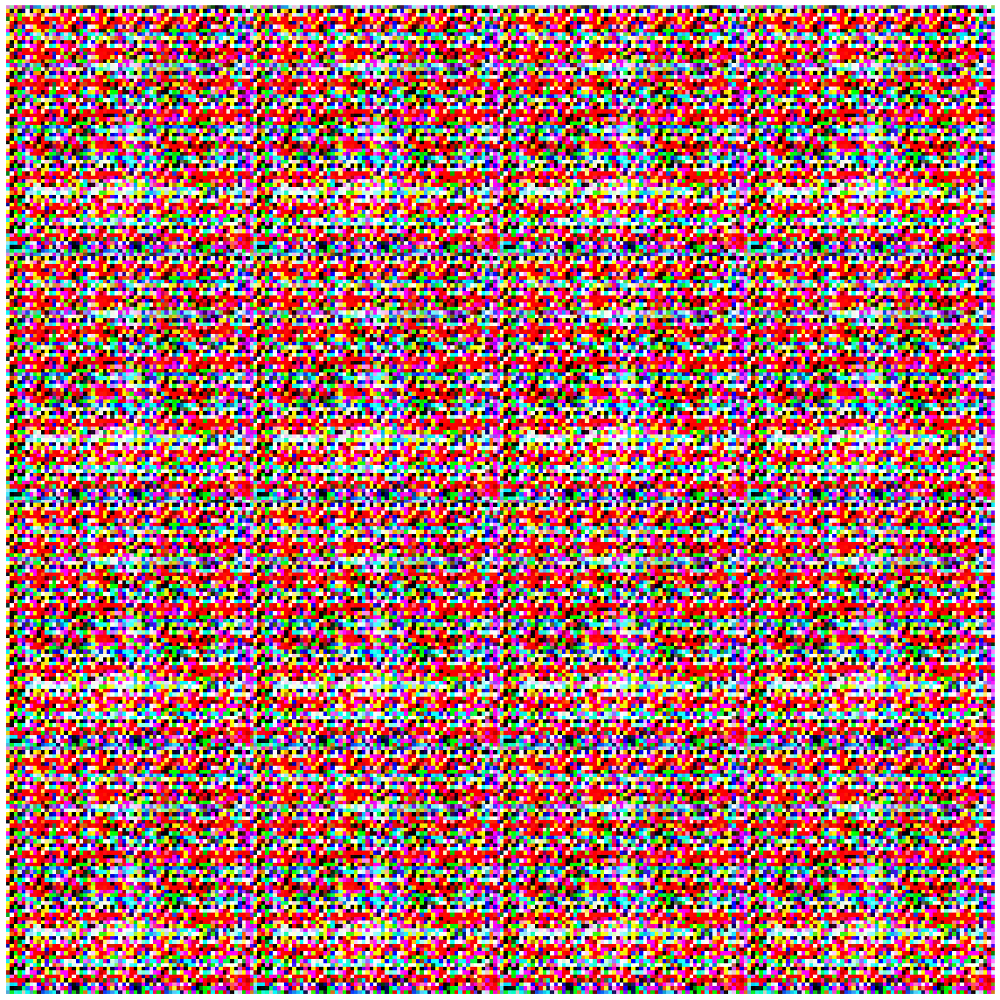

Disc: real loss: 1.285628 fake loss: 1.102490
GAN loss: 0.450589
Step 3900 completed. Time took: 1 secs.
Begin step:  3901
Disc: real loss: 1.285932 fake loss: 1.097630
GAN loss: 0.448608
Step 3901 completed. Time took: 0 secs.
Begin step:  3902
Disc: real loss: 1.255852 fake loss: 1.095406
GAN loss: 0.447443
Step 3902 completed. Time took: 0 secs.
Begin step:  3903
Disc: real loss: 1.296829 fake loss: 1.100958
GAN loss: 0.443732
Step 3903 completed. Time took: 0 secs.
Begin step:  3904
Disc: real loss: 1.280226 fake loss: 1.085919
GAN loss: 0.443640
Step 3904 completed. Time took: 0 secs.
Begin step:  3905
Disc: real loss: 1.270480 fake loss: 1.102355
GAN loss: 0.451979
Step 3905 completed. Time took: 0 secs.
Begin step:  3906
Disc: real loss: 1.254066 fake loss: 1.098639
GAN loss: 0.449199
Step 3906 completed. Time took: 0 secs.
Begin step:  3907
Disc: real loss: 1.279296 fake loss: 1.099030
GAN loss: 0.447149
Step 3907 completed. Time took: 0 secs.
Begin step:  3908
Disc: real loss:

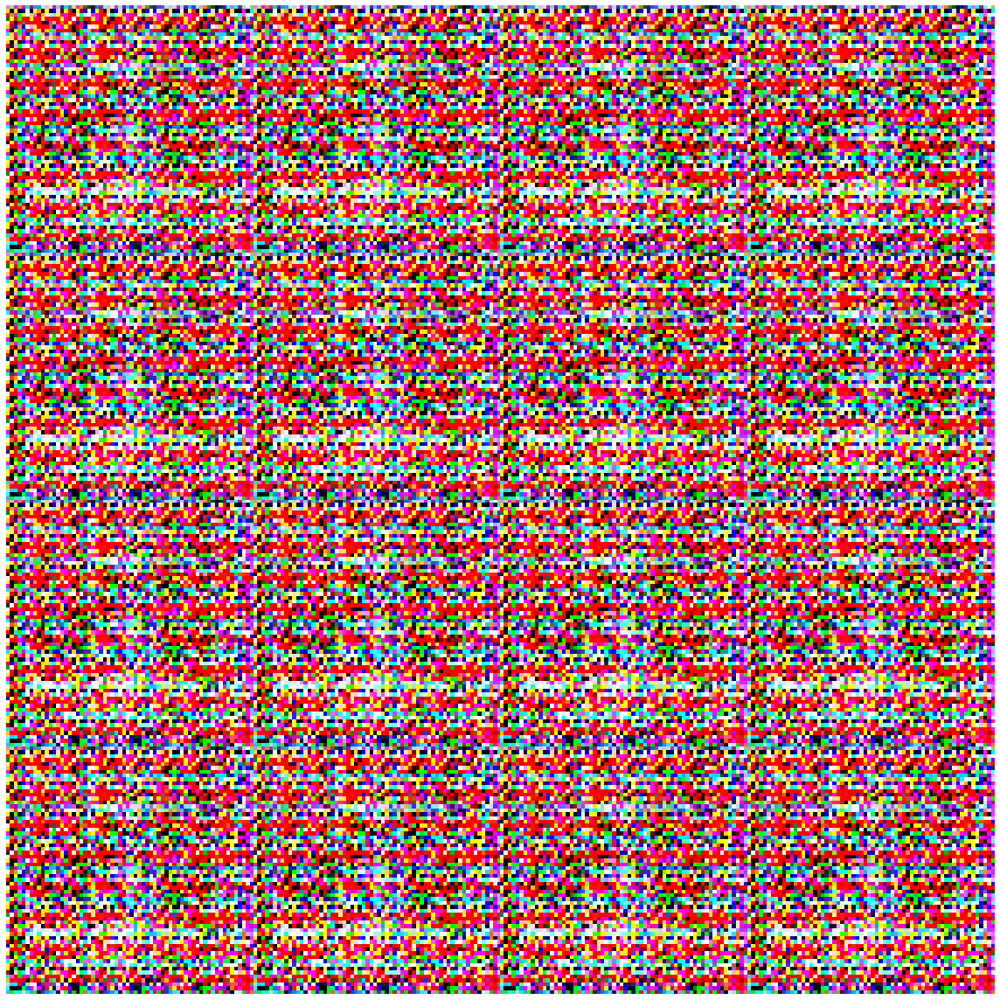

Begin step:  4000


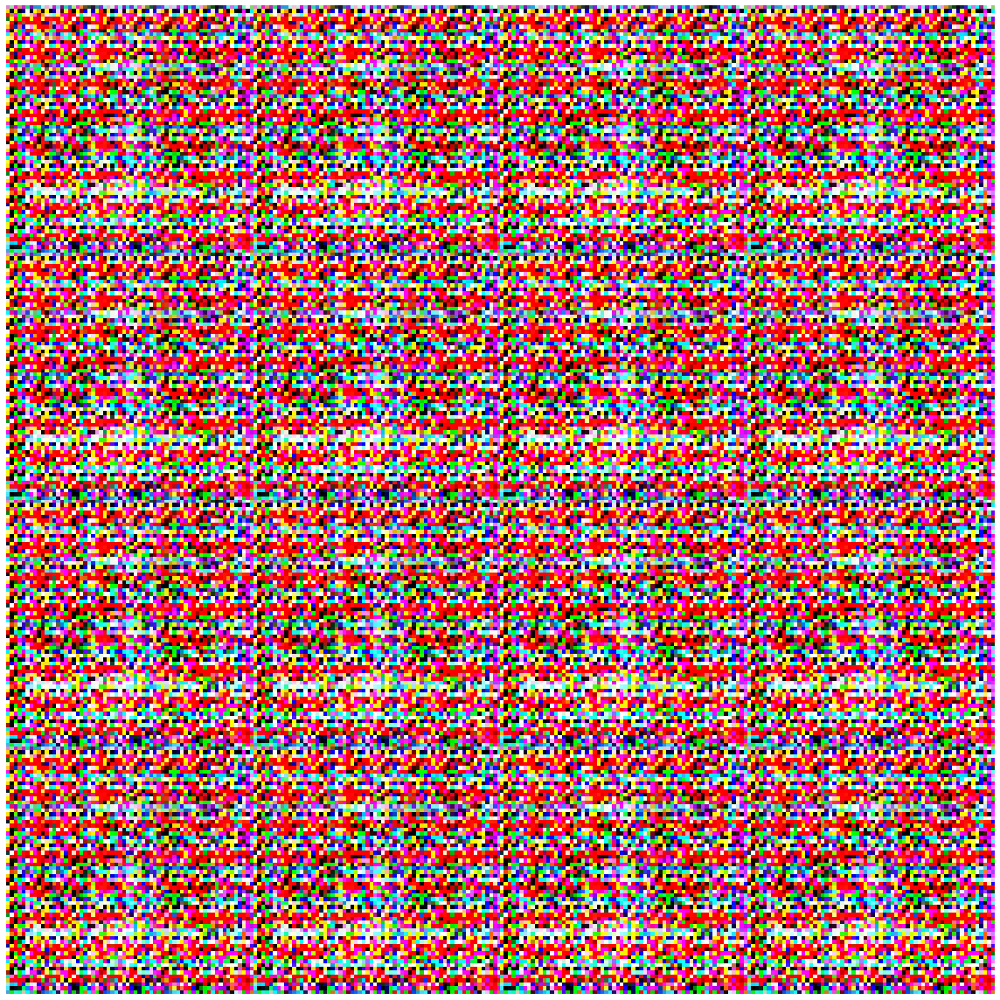

Disc: real loss: 1.281802 fake loss: 1.094422
GAN loss: 0.445524
Step 4000 completed. Time took: 1 secs.
Begin step:  4001
Disc: real loss: 1.293334 fake loss: 1.091502
GAN loss: 0.440814
Step 4001 completed. Time took: 0 secs.
Begin step:  4002
Disc: real loss: 1.269843 fake loss: 1.098778
GAN loss: 0.451334
Step 4002 completed. Time took: 0 secs.
Begin step:  4003
Disc: real loss: 1.276952 fake loss: 1.096251
GAN loss: 0.443793
Step 4003 completed. Time took: 0 secs.
Begin step:  4004
Disc: real loss: 1.269636 fake loss: 1.108289
GAN loss: 0.444840
Step 4004 completed. Time took: 0 secs.
Begin step:  4005
Disc: real loss: 1.252131 fake loss: 1.094005
GAN loss: 0.460191
Step 4005 completed. Time took: 0 secs.
Begin step:  4006
Disc: real loss: 1.288544 fake loss: 1.099002
GAN loss: 0.442967
Step 4006 completed. Time took: 0 secs.
Begin step:  4007
Disc: real loss: 1.306515 fake loss: 1.093134
GAN loss: 0.437262
Step 4007 completed. Time took: 0 secs.
Begin step:  4008
Disc: real loss:

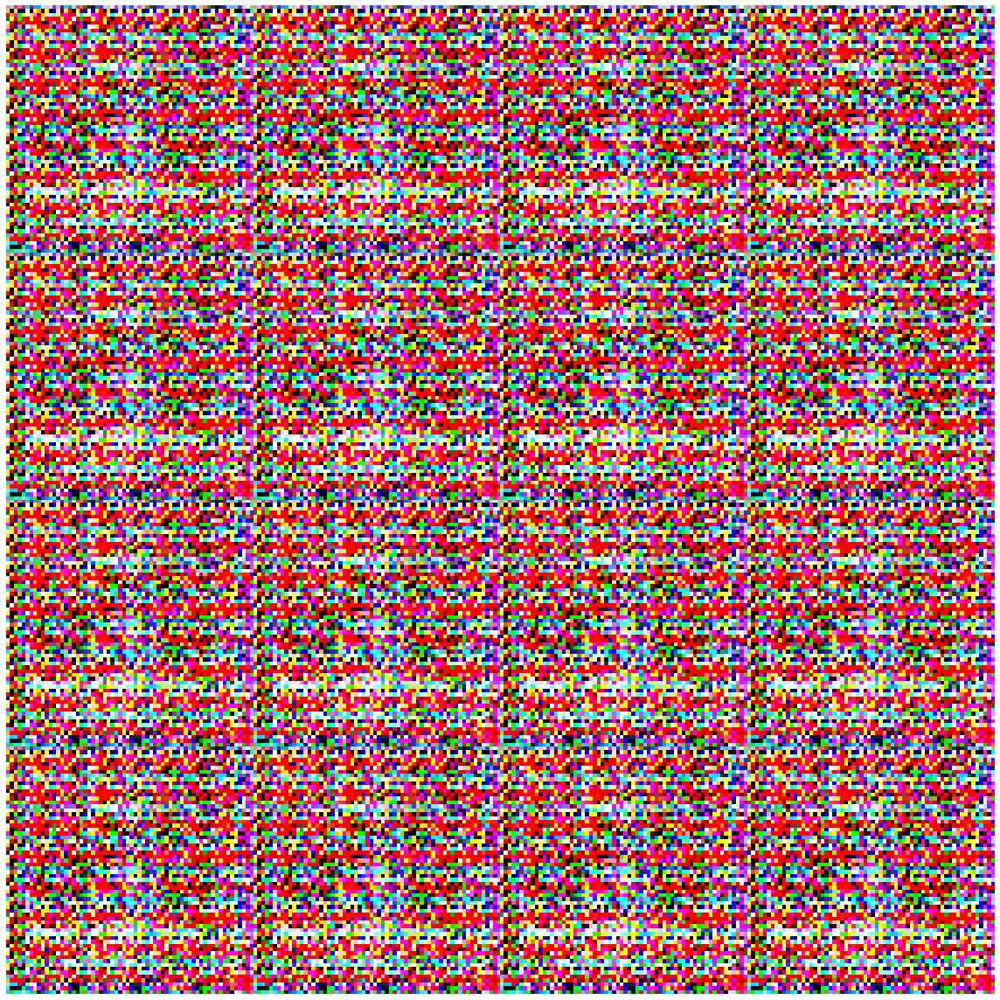

Disc: real loss: 1.257104 fake loss: 1.107276
GAN loss: 0.448285
Step 4100 completed. Time took: 1 secs.
Begin step:  4101
Disc: real loss: 1.256348 fake loss: 1.096296
GAN loss: 0.452834
Step 4101 completed. Time took: 0 secs.
Begin step:  4102
Disc: real loss: 1.277487 fake loss: 1.094481
GAN loss: 0.457824
Step 4102 completed. Time took: 0 secs.
Begin step:  4103
Disc: real loss: 1.269164 fake loss: 1.085828
GAN loss: 0.452286
Step 4103 completed. Time took: 0 secs.
Begin step:  4104
Disc: real loss: 1.295784 fake loss: 1.104857
GAN loss: 0.446065
Step 4104 completed. Time took: 0 secs.
Begin step:  4105
Disc: real loss: 1.283659 fake loss: 1.096055
GAN loss: 0.447506
Step 4105 completed. Time took: 0 secs.
Begin step:  4106
Disc: real loss: 1.260133 fake loss: 1.091180
GAN loss: 0.450266
Step 4106 completed. Time took: 0 secs.
Begin step:  4107
Disc: real loss: 1.269877 fake loss: 1.106276
GAN loss: 0.456051
Step 4107 completed. Time took: 0 secs.
Begin step:  4108
Disc: real loss:

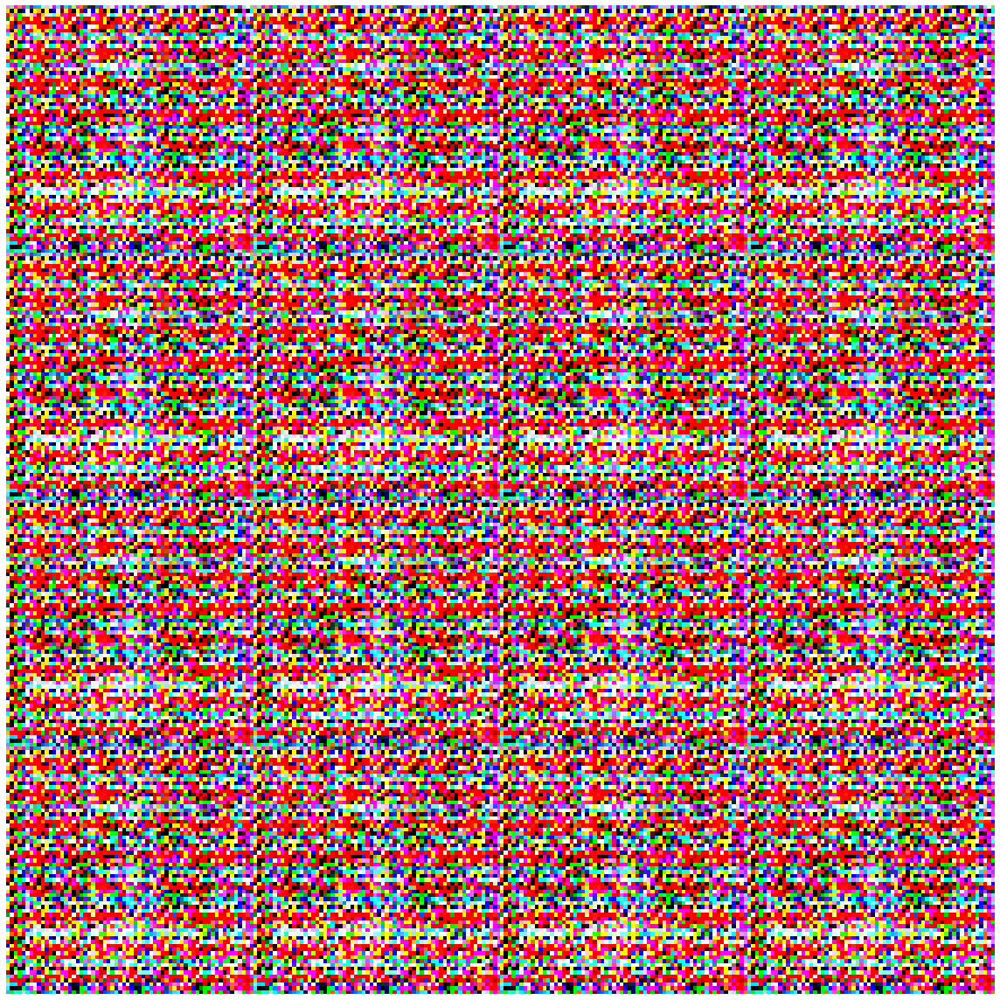

Disc: real loss: 1.331333 fake loss: 1.098809
GAN loss: 0.441181
Step 4200 completed. Time took: 1 secs.
Begin step:  4201
Disc: real loss: 1.292148 fake loss: 1.100176
GAN loss: 0.439735
Step 4201 completed. Time took: 0 secs.
Begin step:  4202
Disc: real loss: 1.266511 fake loss: 1.103202
GAN loss: 0.447103
Step 4202 completed. Time took: 0 secs.
Begin step:  4203
Disc: real loss: 1.285263 fake loss: 1.094722
GAN loss: 0.449245
Step 4203 completed. Time took: 0 secs.
Begin step:  4204
Disc: real loss: 1.269962 fake loss: 1.099323
GAN loss: 0.465804
Step 4204 completed. Time took: 0 secs.
Begin step:  4205
Disc: real loss: 1.280534 fake loss: 1.093197
GAN loss: 0.451498
Step 4205 completed. Time took: 0 secs.
Begin step:  4206
Disc: real loss: 1.291116 fake loss: 1.100887
GAN loss: 0.444968
Step 4206 completed. Time took: 0 secs.
Begin step:  4207
Disc: real loss: 1.271489 fake loss: 1.089680
GAN loss: 0.452740
Step 4207 completed. Time took: 0 secs.
Begin step:  4208
Disc: real loss:

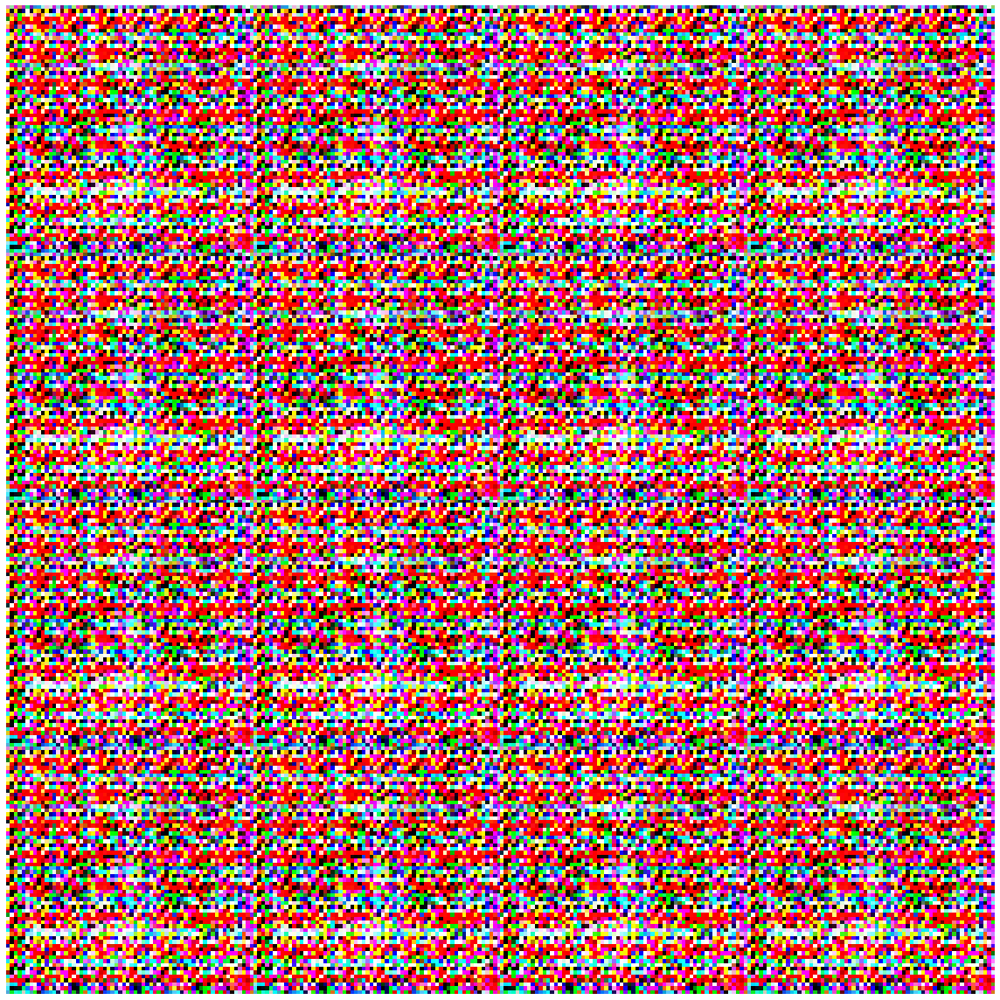

Disc: real loss: 1.307226 fake loss: 1.096505
GAN loss: 0.447431
Step 4300 completed. Time took: 1 secs.
Begin step:  4301
Disc: real loss: 1.239467 fake loss: 1.106516
GAN loss: 0.455931
Step 4301 completed. Time took: 0 secs.
Begin step:  4302
Disc: real loss: 1.282588 fake loss: 1.096154
GAN loss: 0.450002
Step 4302 completed. Time took: 0 secs.
Begin step:  4303
Disc: real loss: 1.281180 fake loss: 1.099687
GAN loss: 0.443469
Step 4303 completed. Time took: 0 secs.
Begin step:  4304
Disc: real loss: 1.267019 fake loss: 1.101251
GAN loss: 0.446901
Step 4304 completed. Time took: 0 secs.
Begin step:  4305
Disc: real loss: 1.282375 fake loss: 1.100111
GAN loss: 0.445919
Step 4305 completed. Time took: 0 secs.
Begin step:  4306
Disc: real loss: 1.270525 fake loss: 1.093036
GAN loss: 0.445019
Step 4306 completed. Time took: 0 secs.
Begin step:  4307
Disc: real loss: 1.259320 fake loss: 1.095758
GAN loss: 0.457585
Step 4307 completed. Time took: 0 secs.
Begin step:  4308
Disc: real loss:

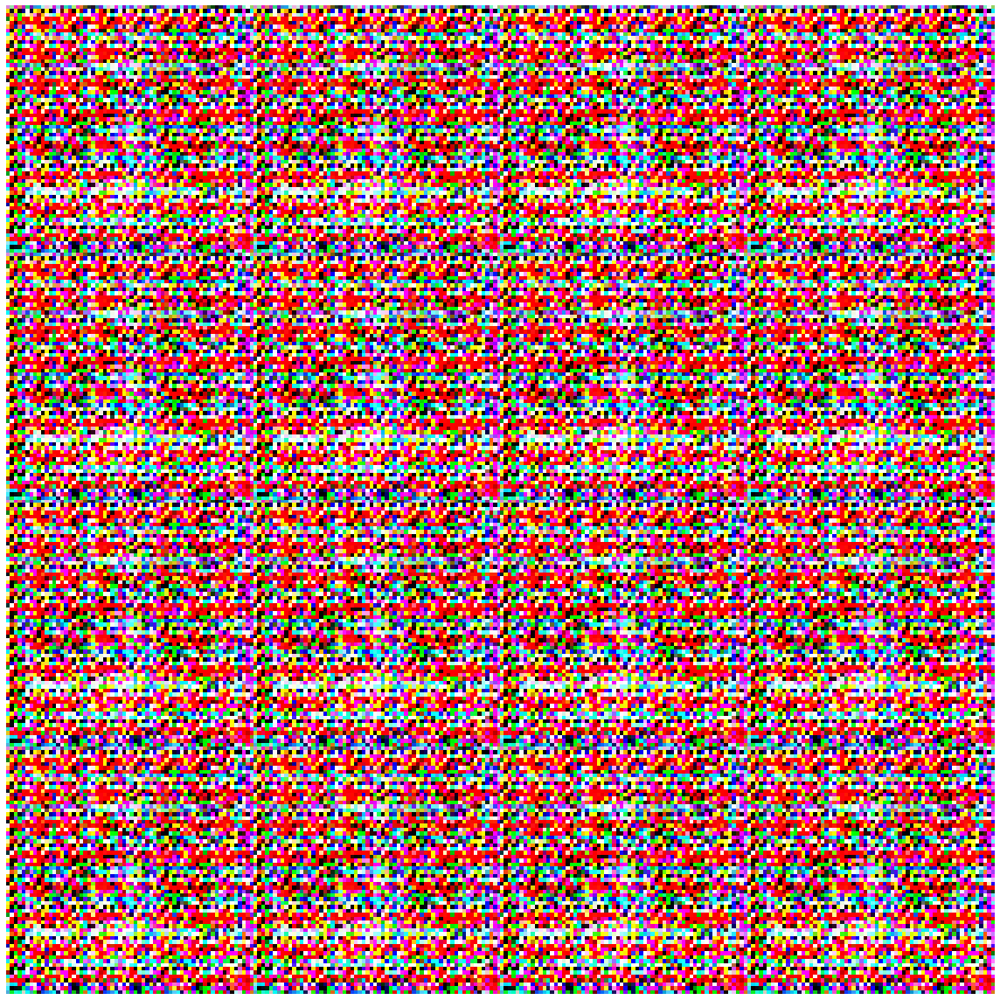

Disc: real loss: 1.285958 fake loss: 1.099690
GAN loss: 0.459537
Step 4400 completed. Time took: 1 secs.
Begin step:  4401
Disc: real loss: 1.316412 fake loss: 1.074157
GAN loss: 0.448756
Step 4401 completed. Time took: 0 secs.
Begin step:  4402
Disc: real loss: 1.268269 fake loss: 1.092989
GAN loss: 0.449147
Step 4402 completed. Time took: 0 secs.
Begin step:  4403
Disc: real loss: 1.256505 fake loss: 1.095141
GAN loss: 0.447348
Step 4403 completed. Time took: 0 secs.
Begin step:  4404
Disc: real loss: 1.270748 fake loss: 1.097433
GAN loss: 0.444571
Step 4404 completed. Time took: 0 secs.
Begin step:  4405
Disc: real loss: 1.270721 fake loss: 1.087291
GAN loss: 0.452245
Step 4405 completed. Time took: 0 secs.
Begin step:  4406
Disc: real loss: 1.266175 fake loss: 1.088445
GAN loss: 0.444672
Step 4406 completed. Time took: 0 secs.
Begin step:  4407
Disc: real loss: 1.276901 fake loss: 1.106826
GAN loss: 0.437118
Step 4407 completed. Time took: 0 secs.
Begin step:  4408
Disc: real loss:

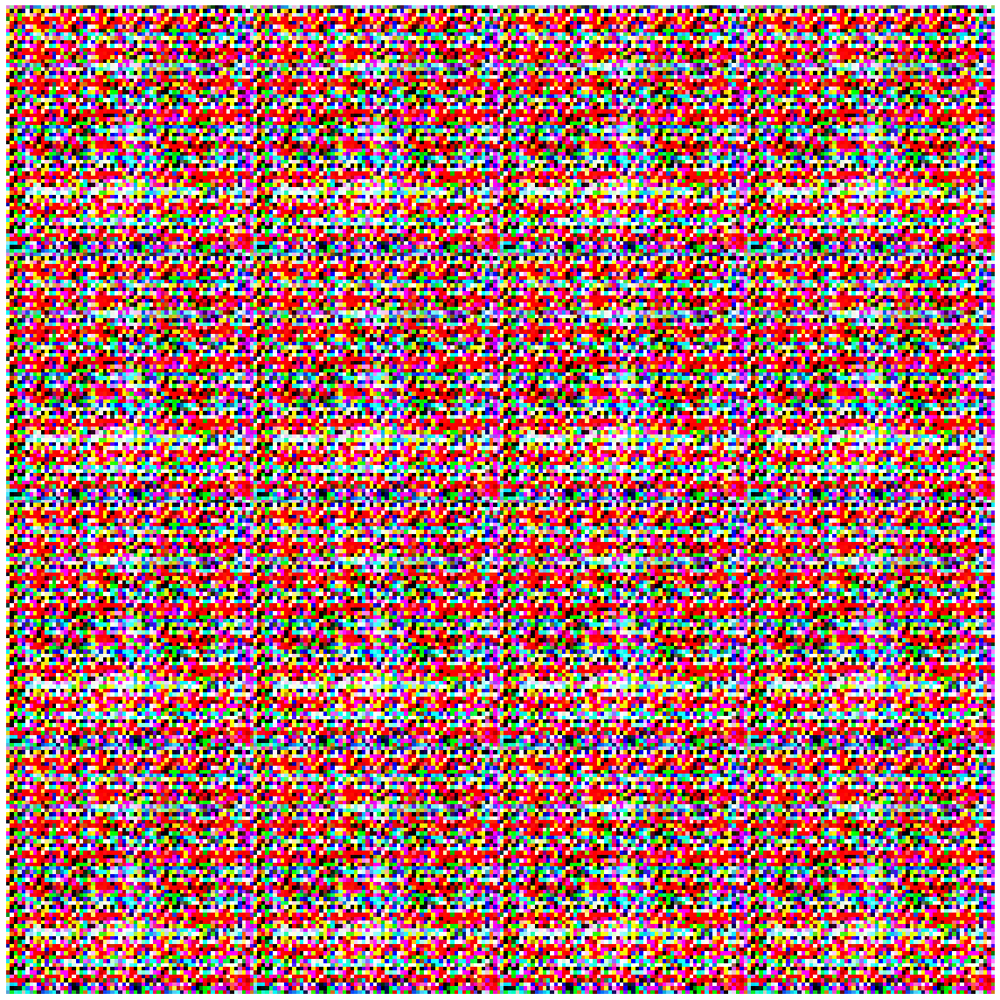

Begin step:  4500


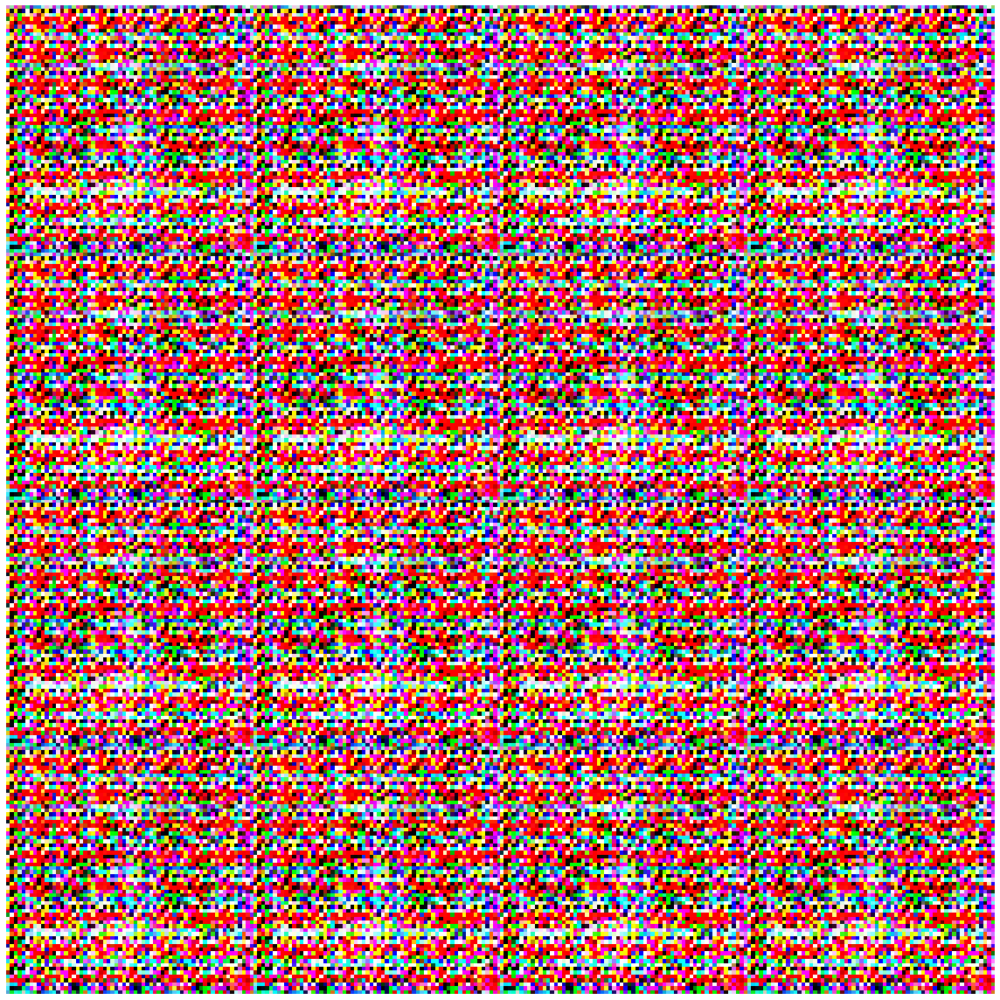

Disc: real loss: 1.281446 fake loss: 1.092828
GAN loss: 0.450781
Step 4500 completed. Time took: 1 secs.
Begin step:  4501
Disc: real loss: 1.292476 fake loss: 1.094911
GAN loss: 0.450253
Step 4501 completed. Time took: 0 secs.
Begin step:  4502
Disc: real loss: 1.305850 fake loss: 1.089064
GAN loss: 0.446362
Step 4502 completed. Time took: 0 secs.
Begin step:  4503
Disc: real loss: 1.299461 fake loss: 1.096977
GAN loss: 0.439189
Step 4503 completed. Time took: 0 secs.
Begin step:  4504
Disc: real loss: 1.289288 fake loss: 1.095857
GAN loss: 0.446660
Step 4504 completed. Time took: 0 secs.
Begin step:  4505
Disc: real loss: 1.270644 fake loss: 1.103088
GAN loss: 0.452883
Step 4505 completed. Time took: 0 secs.
Begin step:  4506
Disc: real loss: 1.254079 fake loss: 1.096973
GAN loss: 0.454731
Step 4506 completed. Time took: 0 secs.
Begin step:  4507
Disc: real loss: 1.265064 fake loss: 1.095259
GAN loss: 0.449310
Step 4507 completed. Time took: 0 secs.
Begin step:  4508
Disc: real loss:

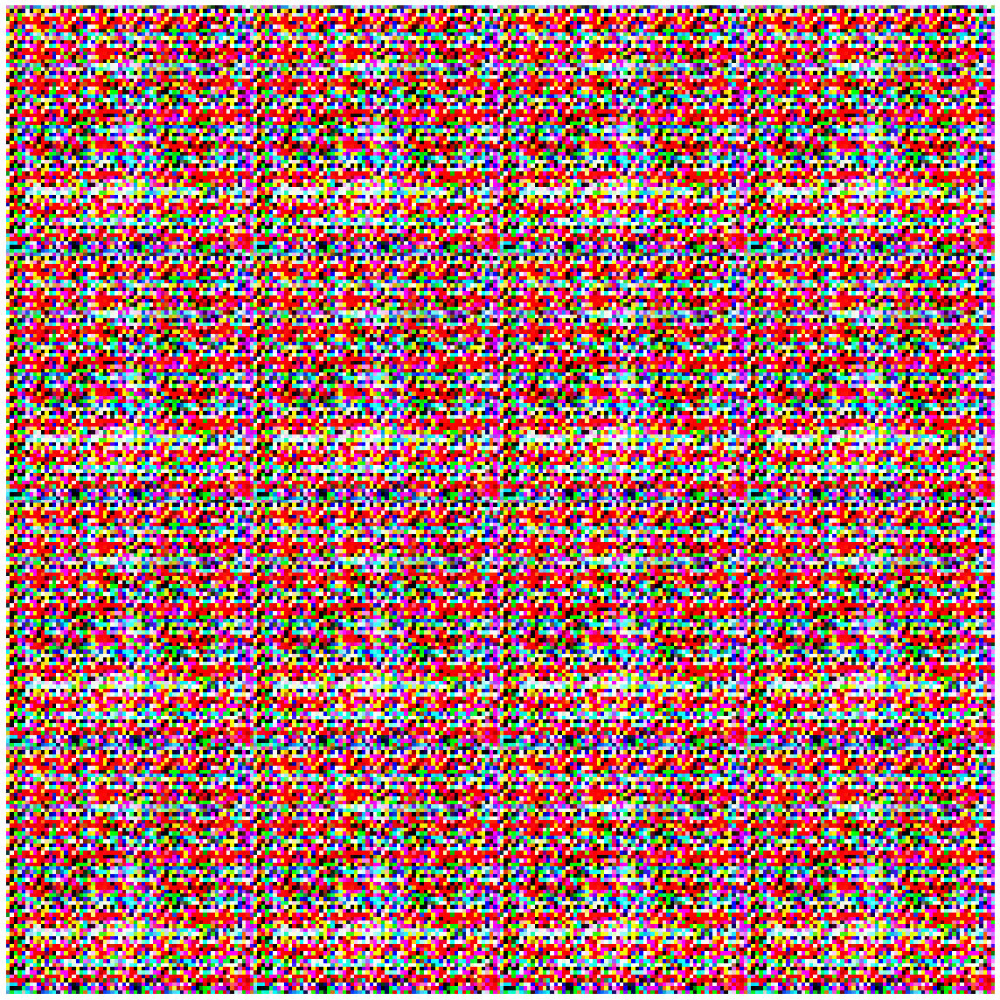

Disc: real loss: 1.247504 fake loss: 1.102303
GAN loss: 0.450865
Step 4600 completed. Time took: 1 secs.
Begin step:  4601
Disc: real loss: 1.298164 fake loss: 1.093389
GAN loss: 0.447110
Step 4601 completed. Time took: 0 secs.
Begin step:  4602
Disc: real loss: 1.311221 fake loss: 1.096021
GAN loss: 0.441886
Step 4602 completed. Time took: 0 secs.
Begin step:  4603
Disc: real loss: 1.298549 fake loss: 1.101260
GAN loss: 0.442006
Step 4603 completed. Time took: 0 secs.
Begin step:  4604
Disc: real loss: 1.294029 fake loss: 1.098795
GAN loss: 0.449897
Step 4604 completed. Time took: 0 secs.
Begin step:  4605
Disc: real loss: 1.285770 fake loss: 1.095891
GAN loss: 0.449993
Step 4605 completed. Time took: 0 secs.
Begin step:  4606
Disc: real loss: 1.294165 fake loss: 1.095624
GAN loss: 0.443365
Step 4606 completed. Time took: 0 secs.
Begin step:  4607
Disc: real loss: 1.291316 fake loss: 1.089459
GAN loss: 0.446645
Step 4607 completed. Time took: 0 secs.
Begin step:  4608
Disc: real loss:

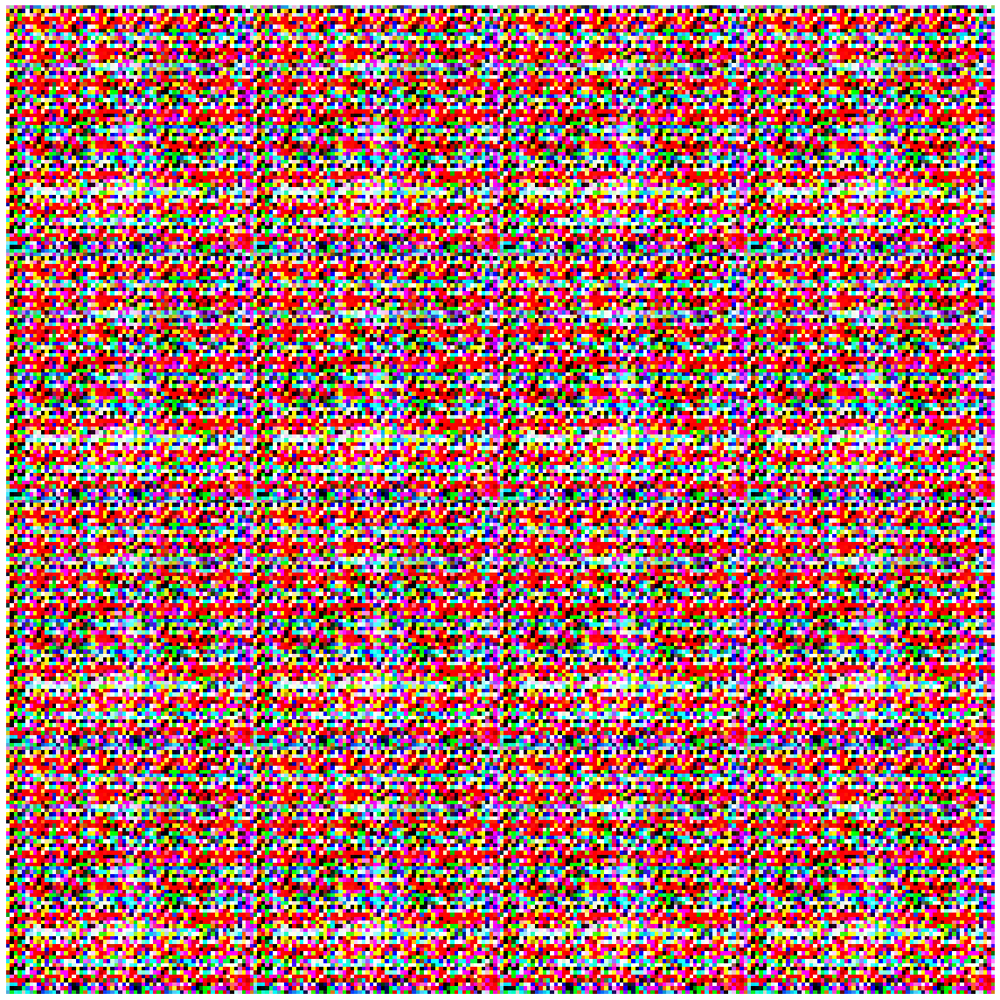

Disc: real loss: 1.278143 fake loss: 1.086562
GAN loss: 0.459618
Step 4700 completed. Time took: 1 secs.
Begin step:  4701
Disc: real loss: 1.303077 fake loss: 1.093558
GAN loss: 0.437068
Step 4701 completed. Time took: 0 secs.
Begin step:  4702
Disc: real loss: 1.316459 fake loss: 1.102383
GAN loss: 0.447442
Step 4702 completed. Time took: 0 secs.
Begin step:  4703
Disc: real loss: 1.260441 fake loss: 1.097749
GAN loss: 0.449985
Step 4703 completed. Time took: 0 secs.
Begin step:  4704
Disc: real loss: 1.307044 fake loss: 1.106140
GAN loss: 0.438565
Step 4704 completed. Time took: 0 secs.
Begin step:  4705
Disc: real loss: 1.310442 fake loss: 1.086540
GAN loss: 0.441266
Step 4705 completed. Time took: 0 secs.
Begin step:  4706
Disc: real loss: 1.274146 fake loss: 1.099643
GAN loss: 0.444715
Step 4706 completed. Time took: 0 secs.
Begin step:  4707
Disc: real loss: 1.279152 fake loss: 1.090091
GAN loss: 0.444030
Step 4707 completed. Time took: 0 secs.
Begin step:  4708
Disc: real loss:

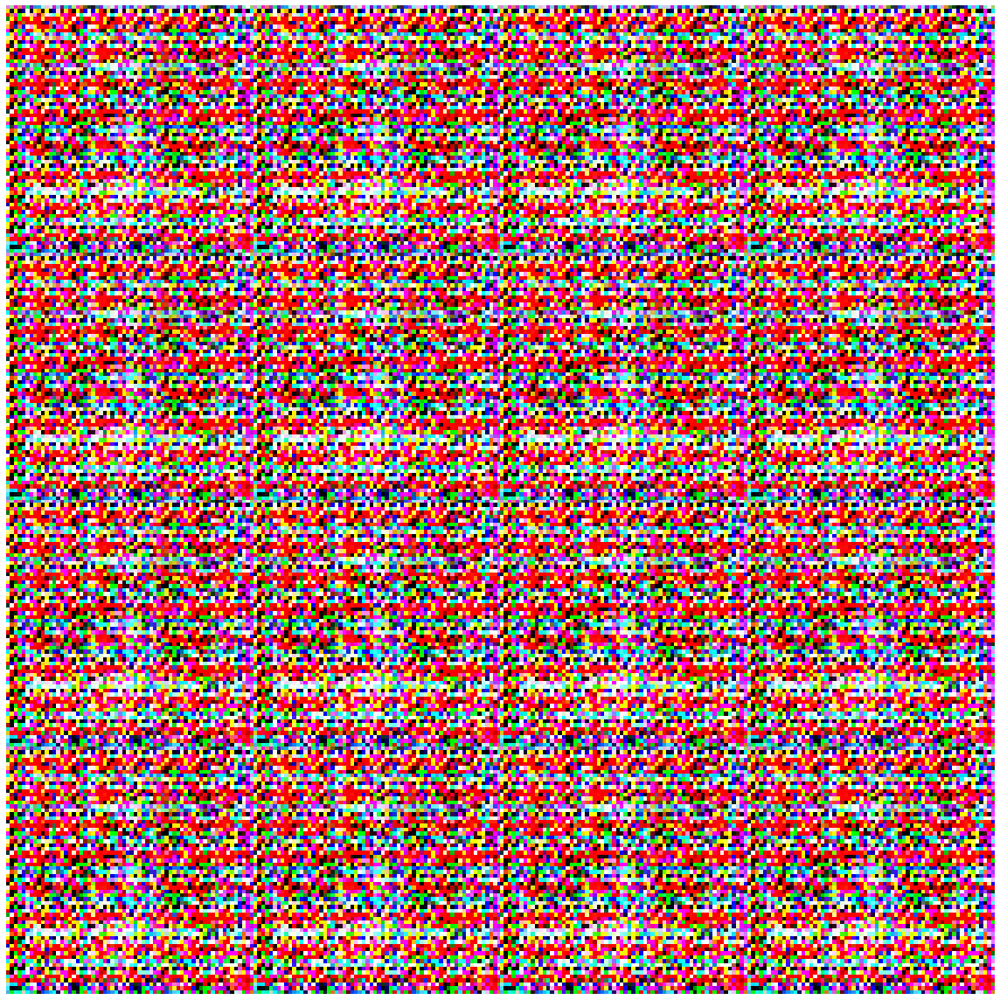

Disc: real loss: 1.314040 fake loss: 1.091308
GAN loss: 0.440485
Step 4800 completed. Time took: 1 secs.
Begin step:  4801
Disc: real loss: 1.313580 fake loss: 1.093436
GAN loss: 0.441577
Step 4801 completed. Time took: 0 secs.
Begin step:  4802
Disc: real loss: 1.300549 fake loss: 1.091273
GAN loss: 0.439682
Step 4802 completed. Time took: 0 secs.
Begin step:  4803
Disc: real loss: 1.290972 fake loss: 1.104015
GAN loss: 0.445035
Step 4803 completed. Time took: 0 secs.
Begin step:  4804
Disc: real loss: 1.273795 fake loss: 1.093581
GAN loss: 0.447442
Step 4804 completed. Time took: 0 secs.
Begin step:  4805
Disc: real loss: 1.279753 fake loss: 1.092323
GAN loss: 0.442815
Step 4805 completed. Time took: 0 secs.
Begin step:  4806
Disc: real loss: 1.275215 fake loss: 1.093436
GAN loss: 0.446010
Step 4806 completed. Time took: 0 secs.
Begin step:  4807
Disc: real loss: 1.274726 fake loss: 1.108428
GAN loss: 0.451549
Step 4807 completed. Time took: 0 secs.
Begin step:  4808
Disc: real loss:

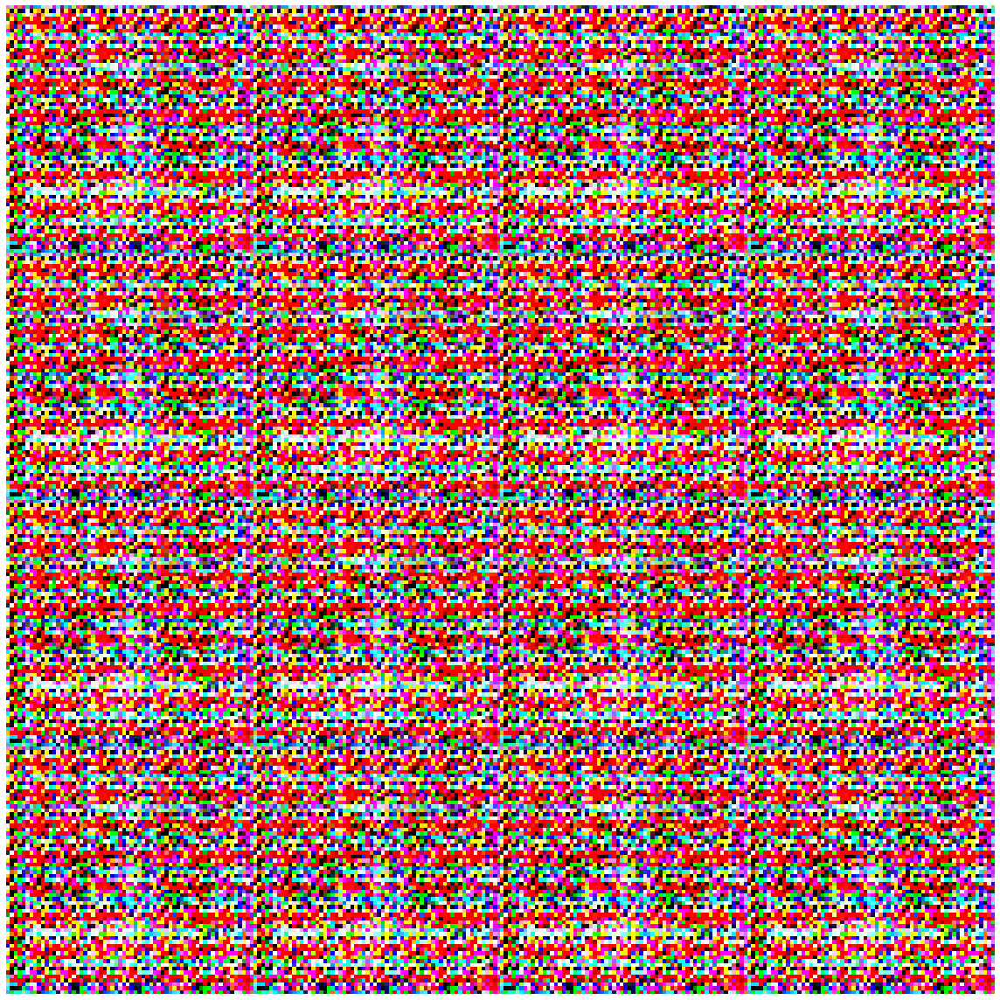

Disc: real loss: 1.252047 fake loss: 1.083298
GAN loss: 0.453740
Step 4900 completed. Time took: 1 secs.
Begin step:  4901
Disc: real loss: 1.270568 fake loss: 1.111017
GAN loss: 0.446816
Step 4901 completed. Time took: 0 secs.
Begin step:  4902
Disc: real loss: 1.276189 fake loss: 1.093857
GAN loss: 0.448515
Step 4902 completed. Time took: 0 secs.
Begin step:  4903
Disc: real loss: 1.254596 fake loss: 1.091115
GAN loss: 0.457310
Step 4903 completed. Time took: 0 secs.
Begin step:  4904
Disc: real loss: 1.275080 fake loss: 1.096856
GAN loss: 0.449996
Step 4904 completed. Time took: 0 secs.
Begin step:  4905
Disc: real loss: 1.285604 fake loss: 1.095146
GAN loss: 0.448932
Step 4905 completed. Time took: 0 secs.
Begin step:  4906
Disc: real loss: 1.275721 fake loss: 1.097748
GAN loss: 0.450914
Step 4906 completed. Time took: 0 secs.
Begin step:  4907
Disc: real loss: 1.274405 fake loss: 1.099987
GAN loss: 0.452215
Step 4907 completed. Time took: 0 secs.
Begin step:  4908
Disc: real loss:

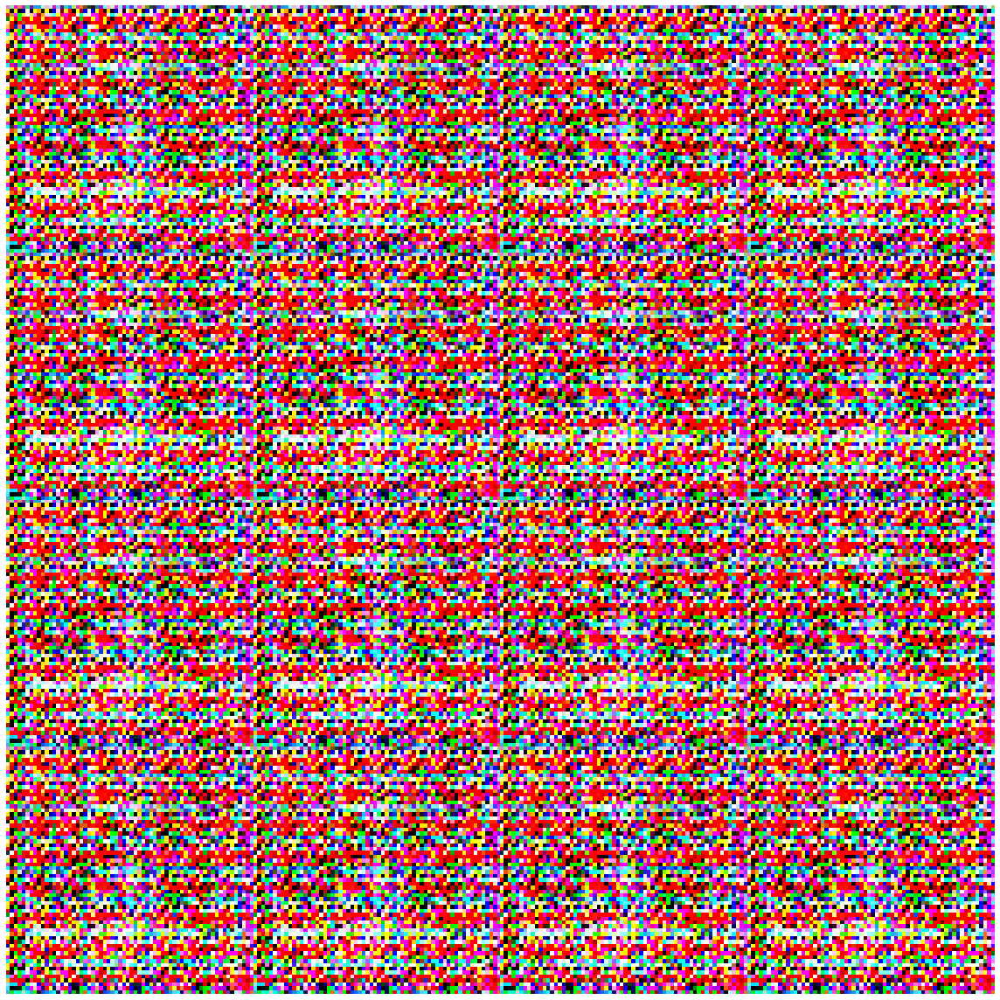

In [ ]:
noise_shape = (1, 1, 100) # 100 d latent space
num_steps = 5000
batch_size = 64
image_shape = (64, 64, 3)
img_save_dir = '/content/drive/MyDrive/anime gan gen'
data_dir = '/content/kaggle/images/*'
log_dir = '/content/drive/MyDrive/anime gan gen'
save_model_dir = '/content/drive/MyDrive/anime gan gen'

# Use a fixed noise vector to see how the GAN Images transition through time on a fixed noise. 
fixed_noise = gen_noise(16,noise_shape)

# To keep Track of losses
avg_disc_fake_loss = []
avg_disc_real_loss = []
avg_GAN_loss = []

# we will run for num_steps iterations
for step in range(num_steps):
  tot_step = step
  print("Begin step: ", tot_step)
  # to keep track of time per step
  step_begin_time = time.time()

  
  # sample a batch of normalized images from the dataset
  real_data_X = sample_from_dataset(batch_size = batch_size, image_shape = image_shape, data_dir = data_dir)

  # Genearate noise to send as input to the generator
  noise = gen_noise(batch_size, noise_shape)

  # Use generator to create(predict) images
  fake_data_X = generator(noise)

  # Save predicted images from the generator every 10th step
  if (tot_step % 100) == 0:
      step_num = str(tot_step).zfill(4)
      save_img_batch(fake_data_X, img_save_dir+step_num+"_image.png")

  # Create the labels for real and fake data. We don't give exact ones and zeros but add a small amount of noise. This is an important GAN training trick
  real_data_Y = np.ones(batch_size) - np.random.random_sample(batch_size)*0.2
  fake_data_Y = np.random.random_sample(batch_size)*0.2

  # train the discriminator using data and labels
  discriminator.trainable = True
  generator.trainable = False

  # Training Discriminator seperately on real data
  dis_metrics_real = discriminator.train_on_batch(real_data_X, real_data_Y)

  # training Discriminator seperately on fake data
  dis_metrics_fake = discriminator.train_on_batch(fake_data_X,fake_data_Y) 

  print("Disc: real loss: %f fake loss: %f" % (dis_metrics_real[0], dis_metrics_fake[0]))

  # Save the losses to plot later
  avg_disc_fake_loss.append(dis_metrics_fake[0])
  avg_disc_real_loss.append(dis_metrics_real[0])

  # Train the generator using a random vector of noise and its labels (1's with noise)
  generator.trainable = True
  discriminator.trainable = False

  GAN_X = gen_noise(batch_size, noise_shape)
  GAN_Y = real_data_Y

  gan_metrics = gan.train_on_batch(GAN_X,GAN_Y)
  print("GAN loss: %f" % (gan_metrics[0]))

  # Log results by opening a file in append mode
  text_file = open(log_dir+"\\training_log.txt", "a")
  text_file.write("Step: %d Disc: real loss: %f fake loss: %f GAN loss: %f\n" % (tot_step, dis_metrics_real[0], dis_metrics_fake[0],gan_metrics[0]))
  text_file.close()

  # save GAN loss to plot later
  avg_GAN_loss.append(gan_metrics[0])

  end_time = time.time()
  diff_time = int(end_time - step_begin_time)
  print("Step %d completed. Time took: %s secs." % (tot_step, diff_time))

  # save model at every 500 steps
  if ((tot_step+1) % 500) == 0:
      print("-----------------------------------------------------------------")
      print("Average Disc_fake loss: %f" % (np.mean(avg_disc_fake_loss))) 
      print("Average Disc_real loss: %f" % (np.mean(avg_disc_real_loss))) 
      print("Average GAN loss: %f" % (np.mean(avg_GAN_loss)))
      print("-----------------------------------------------------------------")
      discriminator.trainable = False
      generator.trainable = False
      # predict on fixed_noise
      fixed_noise_generate = generator(noise)
      step_num = str(tot_step).zfill(4)
      save_img_batch(fixed_noise_generate, img_save_dir +step_num+ "fixed_image.png")
      generator.save(save_model_dir + str(tot_step) + "_GENERATOR_weights_and_arch.hdf5")
      discriminator.save(save_model_dir + str(tot_step) + "_DISCRIMINATOR_weights_and_arch.hdf5")

  

In [ ]:
 noise_val = gen_noise(1, (1, 1,100))

In [ ]:
img_val = generator(noise_val)

In [ ]:
img_val = denorm_img(img_val[0])

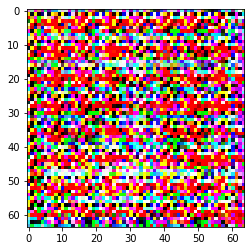

In [ ]:
plt.imshow(img_val)